# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

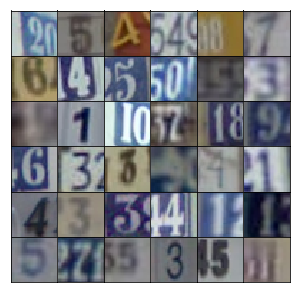

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.contrib.layers.fully_connected(z, 4*4*512, activation_fn=None)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training = training)
        x1 = tf.nn.leaky_relu(x1, alpha=alpha)
        # Output is 4x4x512

        normalizer_params = {'training': training}
        x2 = tf.contrib.layers.conv2d_transpose(x1, 256, 5, stride=2, padding='same', activation_fn=None, 
                                                normalizer_fn=tf.layers.batch_normalization,
                                                normalizer_params=normalizer_params)
        #x2 = tf.nn.batch_normalization(x2, training = training)
        x2 = tf.nn.leaky_relu(x2, alpha=alpha)
        # Output is 8x8x256

        x3 = tf.contrib.layers.conv2d_transpose(x2, 128, 5, stride=2, padding='same', activation_fn=None, 
                                                normalizer_fn=tf.layers.batch_normalization,
                                                normalizer_params=normalizer_params)
        #x3 = tf.nn.batch_normalization(x3, training = training)
        x3 = tf.nn.leaky_relu(x3, alpha=alpha)
        # Output is 16x16x128

        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same', activation=None)
        # Output is now 32x32x3 (how? I don't know)
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same', activation=None)
        x1 = tf.nn.leaky_relu(x1, alpha=alpha)
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same', activation=None)
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.nn.leaky_relu(x2, alpha=alpha)
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same', activation=None)
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.nn.leaky_relu(x3, alpha=alpha)
        
        flat_x3 = tf.reshape(x3, (-1,256*4*4))
        logits = tf.layers.dense(flat_x3,1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.0284... Generator Loss: 1.0130
Epoch 1/25... Discriminator Loss: 0.5516... Generator Loss: 1.2232
Epoch 1/25... Discriminator Loss: 0.2157... Generator Loss: 2.0724
Epoch 1/25... Discriminator Loss: 0.1510... Generator Loss: 2.6491
Epoch 1/25... Discriminator Loss: 0.2061... Generator Loss: 2.1832
Epoch 1/25... Discriminator Loss: 0.1003... Generator Loss: 3.0965
Epoch 1/25... Discriminator Loss: 0.1629... Generator Loss: 2.7047
Epoch 1/25... Discriminator Loss: 0.0795... Generator Loss: 4.0121
Epoch 1/25... Discriminator Loss: 0.1600... Generator Loss: 2.7397
Epoch 1/25... Discriminator Loss: 0.1744... Generator Loss: 3.1134


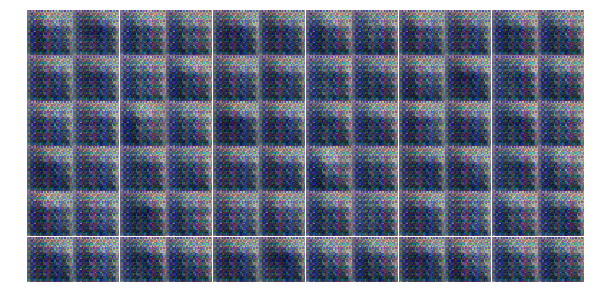

Epoch 1/25... Discriminator Loss: 0.0786... Generator Loss: 3.6530
Epoch 1/25... Discriminator Loss: 0.2470... Generator Loss: 4.5310
Epoch 1/25... Discriminator Loss: 0.9083... Generator Loss: 2.2770
Epoch 1/25... Discriminator Loss: 3.0399... Generator Loss: 5.7836
Epoch 1/25... Discriminator Loss: 0.6870... Generator Loss: 1.3312
Epoch 1/25... Discriminator Loss: 0.4111... Generator Loss: 2.6887
Epoch 1/25... Discriminator Loss: 0.4268... Generator Loss: 3.4412
Epoch 1/25... Discriminator Loss: 0.6422... Generator Loss: 1.4774
Epoch 1/25... Discriminator Loss: 0.6445... Generator Loss: 1.4331
Epoch 1/25... Discriminator Loss: 0.2458... Generator Loss: 2.2686


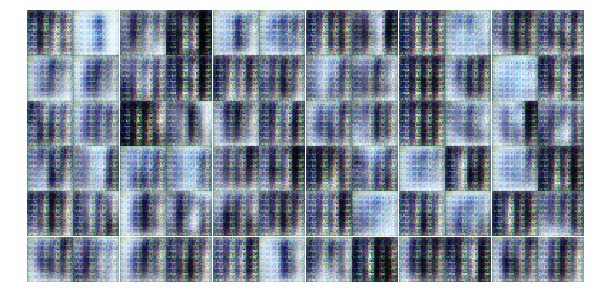

Epoch 1/25... Discriminator Loss: 0.0835... Generator Loss: 4.4041
Epoch 1/25... Discriminator Loss: 0.5039... Generator Loss: 2.3356
Epoch 1/25... Discriminator Loss: 1.4888... Generator Loss: 1.9128
Epoch 1/25... Discriminator Loss: 3.4749... Generator Loss: 0.0458
Epoch 1/25... Discriminator Loss: 0.7139... Generator Loss: 1.8344
Epoch 1/25... Discriminator Loss: 0.9317... Generator Loss: 1.4092
Epoch 1/25... Discriminator Loss: 0.4816... Generator Loss: 1.4156
Epoch 1/25... Discriminator Loss: 0.1540... Generator Loss: 3.3854
Epoch 1/25... Discriminator Loss: 2.4605... Generator Loss: 0.1468
Epoch 1/25... Discriminator Loss: 0.8497... Generator Loss: 1.5304


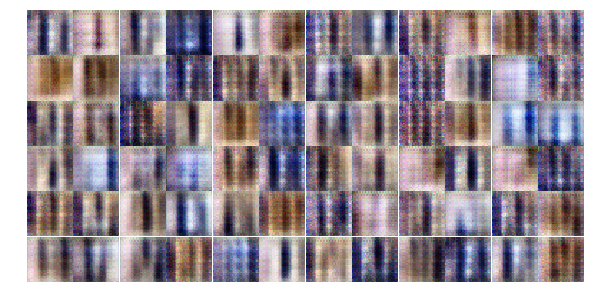

Epoch 1/25... Discriminator Loss: 0.3197... Generator Loss: 2.3094
Epoch 1/25... Discriminator Loss: 0.7077... Generator Loss: 1.8449
Epoch 1/25... Discriminator Loss: 0.6037... Generator Loss: 1.2456
Epoch 1/25... Discriminator Loss: 0.5557... Generator Loss: 1.6144
Epoch 1/25... Discriminator Loss: 0.5354... Generator Loss: 1.7601
Epoch 1/25... Discriminator Loss: 0.8913... Generator Loss: 0.9244
Epoch 1/25... Discriminator Loss: 1.4377... Generator Loss: 0.4861
Epoch 1/25... Discriminator Loss: 0.6068... Generator Loss: 1.9719
Epoch 1/25... Discriminator Loss: 0.5665... Generator Loss: 3.6304
Epoch 1/25... Discriminator Loss: 0.4865... Generator Loss: 2.7191


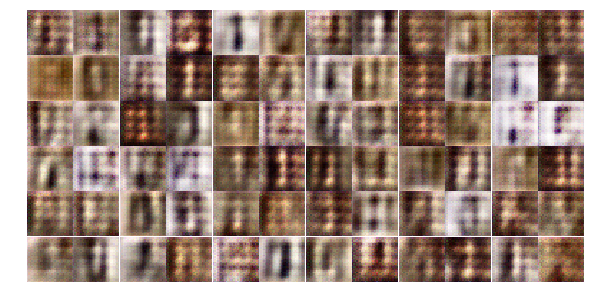

Epoch 1/25... Discriminator Loss: 0.3563... Generator Loss: 1.8792
Epoch 1/25... Discriminator Loss: 0.3942... Generator Loss: 1.9779
Epoch 1/25... Discriminator Loss: 0.2850... Generator Loss: 2.3525
Epoch 1/25... Discriminator Loss: 1.1063... Generator Loss: 0.7709
Epoch 1/25... Discriminator Loss: 0.9214... Generator Loss: 1.1892
Epoch 1/25... Discriminator Loss: 0.5270... Generator Loss: 1.6769
Epoch 1/25... Discriminator Loss: 0.6188... Generator Loss: 1.4614
Epoch 1/25... Discriminator Loss: 0.6840... Generator Loss: 1.1925
Epoch 1/25... Discriminator Loss: 0.3490... Generator Loss: 2.0750
Epoch 1/25... Discriminator Loss: 0.7435... Generator Loss: 1.5998


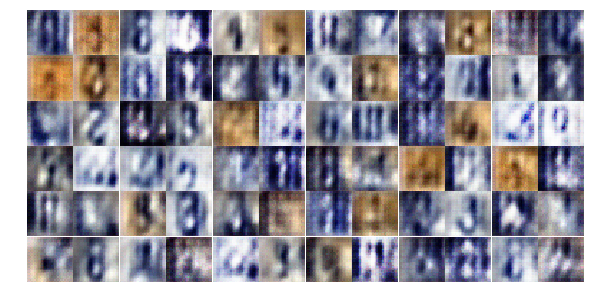

Epoch 1/25... Discriminator Loss: 0.8220... Generator Loss: 1.0438
Epoch 1/25... Discriminator Loss: 0.7396... Generator Loss: 0.9815
Epoch 1/25... Discriminator Loss: 0.5240... Generator Loss: 1.7276
Epoch 1/25... Discriminator Loss: 0.8487... Generator Loss: 0.8710
Epoch 1/25... Discriminator Loss: 0.5192... Generator Loss: 2.0650
Epoch 1/25... Discriminator Loss: 1.1593... Generator Loss: 0.5642
Epoch 1/25... Discriminator Loss: 0.5703... Generator Loss: 2.6264
Epoch 2/25... Discriminator Loss: 0.6998... Generator Loss: 1.7311
Epoch 2/25... Discriminator Loss: 0.8075... Generator Loss: 1.2182
Epoch 2/25... Discriminator Loss: 0.8641... Generator Loss: 1.4025


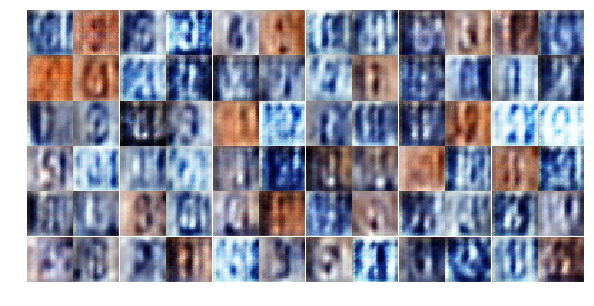

Epoch 2/25... Discriminator Loss: 0.5268... Generator Loss: 1.5020
Epoch 2/25... Discriminator Loss: 0.5302... Generator Loss: 1.8439
Epoch 2/25... Discriminator Loss: 0.8811... Generator Loss: 0.9764
Epoch 2/25... Discriminator Loss: 0.4865... Generator Loss: 1.8243
Epoch 2/25... Discriminator Loss: 0.6591... Generator Loss: 1.4574
Epoch 2/25... Discriminator Loss: 1.1769... Generator Loss: 2.3427
Epoch 2/25... Discriminator Loss: 0.8958... Generator Loss: 1.2827
Epoch 2/25... Discriminator Loss: 0.9161... Generator Loss: 1.0175
Epoch 2/25... Discriminator Loss: 0.9532... Generator Loss: 0.8083
Epoch 2/25... Discriminator Loss: 0.7704... Generator Loss: 2.1042


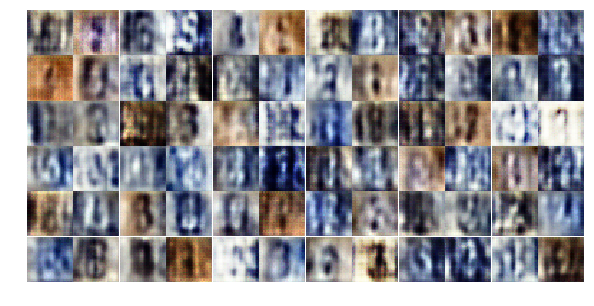

Epoch 2/25... Discriminator Loss: 0.7920... Generator Loss: 1.3050
Epoch 2/25... Discriminator Loss: 0.6489... Generator Loss: 1.6173
Epoch 2/25... Discriminator Loss: 0.7806... Generator Loss: 0.8861
Epoch 2/25... Discriminator Loss: 0.7468... Generator Loss: 1.2268
Epoch 2/25... Discriminator Loss: 0.6769... Generator Loss: 1.8796
Epoch 2/25... Discriminator Loss: 0.9997... Generator Loss: 0.8034
Epoch 2/25... Discriminator Loss: 1.2647... Generator Loss: 0.5078
Epoch 2/25... Discriminator Loss: 0.8822... Generator Loss: 1.4943
Epoch 2/25... Discriminator Loss: 1.2106... Generator Loss: 0.5510
Epoch 2/25... Discriminator Loss: 0.9908... Generator Loss: 2.2185


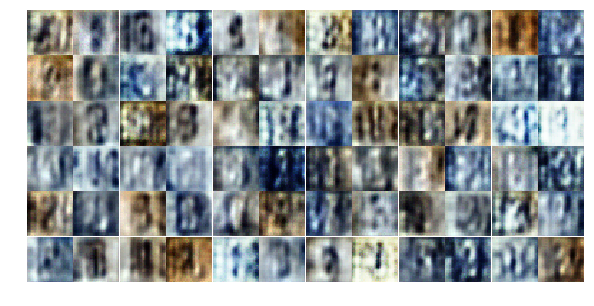

Epoch 2/25... Discriminator Loss: 0.5271... Generator Loss: 1.6467
Epoch 2/25... Discriminator Loss: 0.6556... Generator Loss: 3.4138
Epoch 2/25... Discriminator Loss: 0.9906... Generator Loss: 1.3489
Epoch 2/25... Discriminator Loss: 0.3366... Generator Loss: 3.0239
Epoch 2/25... Discriminator Loss: 1.0157... Generator Loss: 1.6970
Epoch 2/25... Discriminator Loss: 0.7190... Generator Loss: 1.3719
Epoch 2/25... Discriminator Loss: 1.3930... Generator Loss: 0.3800
Epoch 2/25... Discriminator Loss: 0.8818... Generator Loss: 0.9112
Epoch 2/25... Discriminator Loss: 1.0395... Generator Loss: 0.6845
Epoch 2/25... Discriminator Loss: 0.7569... Generator Loss: 0.9002


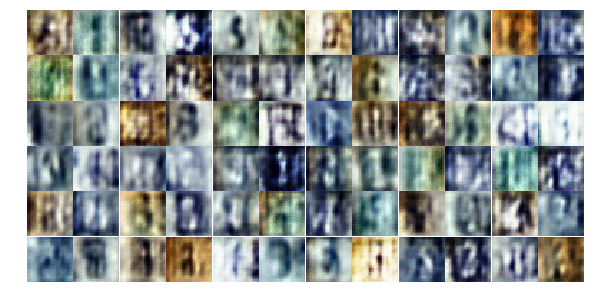

Epoch 2/25... Discriminator Loss: 0.9996... Generator Loss: 3.3178
Epoch 2/25... Discriminator Loss: 1.0003... Generator Loss: 0.8602
Epoch 2/25... Discriminator Loss: 0.5031... Generator Loss: 2.4258
Epoch 2/25... Discriminator Loss: 1.1659... Generator Loss: 0.7207
Epoch 2/25... Discriminator Loss: 0.8488... Generator Loss: 1.4423
Epoch 2/25... Discriminator Loss: 1.0367... Generator Loss: 0.7264
Epoch 2/25... Discriminator Loss: 0.7752... Generator Loss: 1.6810
Epoch 2/25... Discriminator Loss: 0.6420... Generator Loss: 1.6352
Epoch 2/25... Discriminator Loss: 0.7466... Generator Loss: 2.3728
Epoch 2/25... Discriminator Loss: 1.0791... Generator Loss: 0.7914


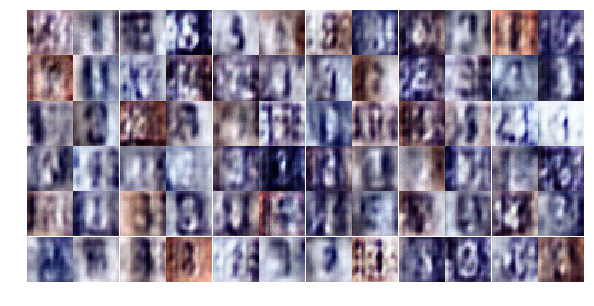

Epoch 2/25... Discriminator Loss: 0.9204... Generator Loss: 1.1127
Epoch 2/25... Discriminator Loss: 1.0155... Generator Loss: 1.4267
Epoch 2/25... Discriminator Loss: 0.9099... Generator Loss: 1.0562
Epoch 2/25... Discriminator Loss: 0.6848... Generator Loss: 1.2759
Epoch 2/25... Discriminator Loss: 0.7597... Generator Loss: 1.3120
Epoch 2/25... Discriminator Loss: 0.8776... Generator Loss: 1.1433
Epoch 2/25... Discriminator Loss: 0.8335... Generator Loss: 3.3759
Epoch 2/25... Discriminator Loss: 0.8101... Generator Loss: 3.4868
Epoch 2/25... Discriminator Loss: 0.7213... Generator Loss: 0.9479
Epoch 2/25... Discriminator Loss: 0.8297... Generator Loss: 1.0406


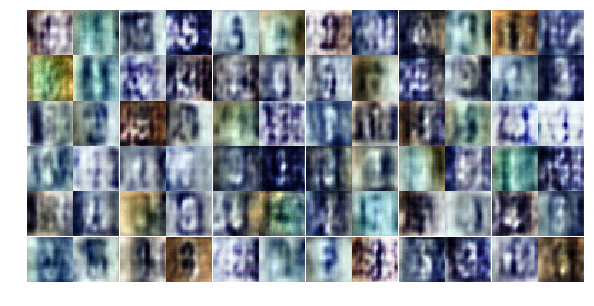

Epoch 2/25... Discriminator Loss: 1.6506... Generator Loss: 0.2825
Epoch 2/25... Discriminator Loss: 0.5068... Generator Loss: 1.5136
Epoch 2/25... Discriminator Loss: 0.8922... Generator Loss: 0.7916
Epoch 2/25... Discriminator Loss: 0.5084... Generator Loss: 1.8319
Epoch 3/25... Discriminator Loss: 0.5476... Generator Loss: 2.4578
Epoch 3/25... Discriminator Loss: 0.6984... Generator Loss: 2.3482
Epoch 3/25... Discriminator Loss: 0.5995... Generator Loss: 3.1367
Epoch 3/25... Discriminator Loss: 0.4274... Generator Loss: 2.5534
Epoch 3/25... Discriminator Loss: 0.5343... Generator Loss: 1.6362
Epoch 3/25... Discriminator Loss: 0.7918... Generator Loss: 0.9711


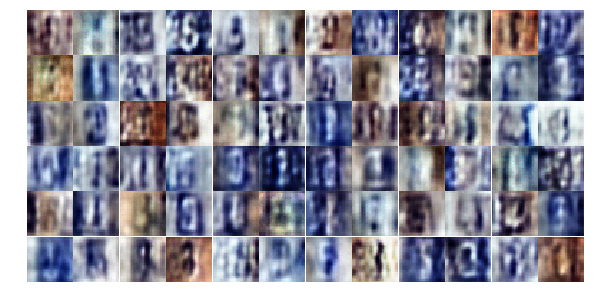

Epoch 3/25... Discriminator Loss: 0.3018... Generator Loss: 2.5043
Epoch 3/25... Discriminator Loss: 0.7410... Generator Loss: 1.6881
Epoch 3/25... Discriminator Loss: 0.5766... Generator Loss: 3.5885
Epoch 3/25... Discriminator Loss: 0.3444... Generator Loss: 2.4039
Epoch 3/25... Discriminator Loss: 0.7567... Generator Loss: 1.7260
Epoch 3/25... Discriminator Loss: 0.6964... Generator Loss: 1.4411
Epoch 3/25... Discriminator Loss: 0.5516... Generator Loss: 1.8491
Epoch 3/25... Discriminator Loss: 0.4917... Generator Loss: 2.8717
Epoch 3/25... Discriminator Loss: 1.6869... Generator Loss: 0.2607
Epoch 3/25... Discriminator Loss: 0.3277... Generator Loss: 2.3817


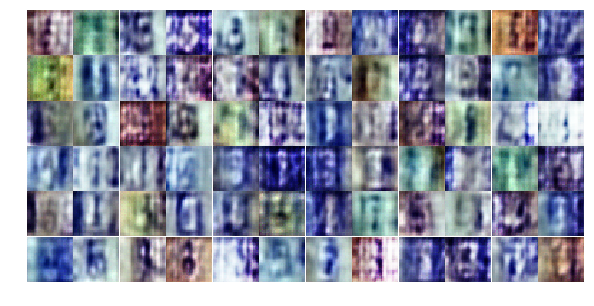

Epoch 3/25... Discriminator Loss: 0.4980... Generator Loss: 1.7501
Epoch 3/25... Discriminator Loss: 0.5425... Generator Loss: 1.2396
Epoch 3/25... Discriminator Loss: 0.2989... Generator Loss: 1.9440
Epoch 3/25... Discriminator Loss: 0.2377... Generator Loss: 3.3029
Epoch 3/25... Discriminator Loss: 0.3440... Generator Loss: 2.0577
Epoch 3/25... Discriminator Loss: 0.3450... Generator Loss: 2.4993
Epoch 3/25... Discriminator Loss: 1.7274... Generator Loss: 0.2528
Epoch 3/25... Discriminator Loss: 0.7455... Generator Loss: 2.0313
Epoch 3/25... Discriminator Loss: 0.4829... Generator Loss: 1.4323
Epoch 3/25... Discriminator Loss: 0.2847... Generator Loss: 2.2838


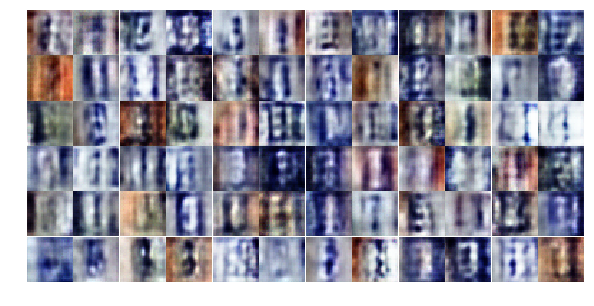

Epoch 3/25... Discriminator Loss: 0.6362... Generator Loss: 1.9875
Epoch 3/25... Discriminator Loss: 0.4611... Generator Loss: 1.4912
Epoch 3/25... Discriminator Loss: 0.4198... Generator Loss: 3.8442
Epoch 3/25... Discriminator Loss: 0.4522... Generator Loss: 2.3141
Epoch 3/25... Discriminator Loss: 0.6369... Generator Loss: 3.7138
Epoch 3/25... Discriminator Loss: 0.5597... Generator Loss: 1.7552
Epoch 3/25... Discriminator Loss: 2.2550... Generator Loss: 0.1540
Epoch 3/25... Discriminator Loss: 0.4840... Generator Loss: 1.3330
Epoch 3/25... Discriminator Loss: 0.4864... Generator Loss: 2.2966
Epoch 3/25... Discriminator Loss: 0.4377... Generator Loss: 1.7229


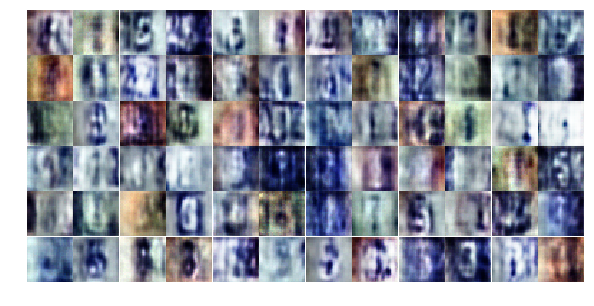

Epoch 3/25... Discriminator Loss: 0.9607... Generator Loss: 0.7077
Epoch 3/25... Discriminator Loss: 0.4289... Generator Loss: 1.5604
Epoch 3/25... Discriminator Loss: 0.2174... Generator Loss: 2.8132
Epoch 3/25... Discriminator Loss: 0.4114... Generator Loss: 1.9710
Epoch 3/25... Discriminator Loss: 0.5517... Generator Loss: 3.1153
Epoch 3/25... Discriminator Loss: 0.7448... Generator Loss: 3.9272
Epoch 3/25... Discriminator Loss: 0.8143... Generator Loss: 0.8736
Epoch 3/25... Discriminator Loss: 0.4043... Generator Loss: 2.0829
Epoch 3/25... Discriminator Loss: 0.3908... Generator Loss: 2.0973
Epoch 3/25... Discriminator Loss: 0.6587... Generator Loss: 1.1415


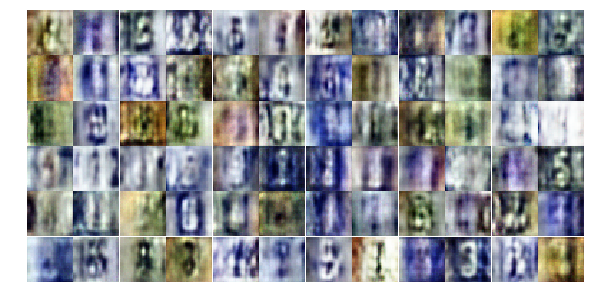

Epoch 3/25... Discriminator Loss: 0.4612... Generator Loss: 1.5459
Epoch 3/25... Discriminator Loss: 0.2783... Generator Loss: 2.4715
Epoch 3/25... Discriminator Loss: 0.7796... Generator Loss: 0.8900
Epoch 3/25... Discriminator Loss: 0.3349... Generator Loss: 3.3895
Epoch 3/25... Discriminator Loss: 0.5902... Generator Loss: 3.1106
Epoch 3/25... Discriminator Loss: 0.2357... Generator Loss: 3.0524
Epoch 3/25... Discriminator Loss: 0.3228... Generator Loss: 1.7214
Epoch 3/25... Discriminator Loss: 0.4170... Generator Loss: 1.3712
Epoch 3/25... Discriminator Loss: 0.2270... Generator Loss: 2.4120
Epoch 3/25... Discriminator Loss: 0.4685... Generator Loss: 5.3639


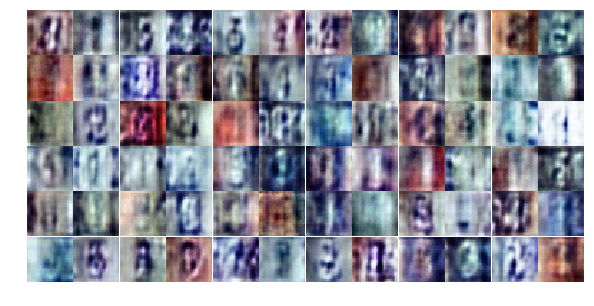

Epoch 3/25... Discriminator Loss: 1.5335... Generator Loss: 3.2335
Epoch 4/25... Discriminator Loss: 0.7333... Generator Loss: 0.9520
Epoch 4/25... Discriminator Loss: 0.3470... Generator Loss: 4.1069
Epoch 4/25... Discriminator Loss: 0.5495... Generator Loss: 1.6641
Epoch 4/25... Discriminator Loss: 1.1071... Generator Loss: 0.6304
Epoch 4/25... Discriminator Loss: 0.4291... Generator Loss: 3.1513
Epoch 4/25... Discriminator Loss: 1.1392... Generator Loss: 0.5710
Epoch 4/25... Discriminator Loss: 0.3135... Generator Loss: 2.2265
Epoch 4/25... Discriminator Loss: 2.2010... Generator Loss: 5.5227
Epoch 4/25... Discriminator Loss: 0.3137... Generator Loss: 3.7192


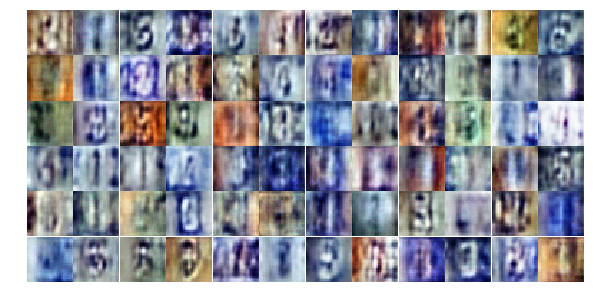

Epoch 4/25... Discriminator Loss: 0.6463... Generator Loss: 1.0722
Epoch 4/25... Discriminator Loss: 0.2856... Generator Loss: 2.0283
Epoch 4/25... Discriminator Loss: 0.7410... Generator Loss: 0.9091
Epoch 4/25... Discriminator Loss: 0.1807... Generator Loss: 3.1794
Epoch 4/25... Discriminator Loss: 0.7864... Generator Loss: 3.8525
Epoch 4/25... Discriminator Loss: 0.1629... Generator Loss: 2.9880
Epoch 4/25... Discriminator Loss: 0.7686... Generator Loss: 4.8602
Epoch 4/25... Discriminator Loss: 0.7033... Generator Loss: 4.4751
Epoch 4/25... Discriminator Loss: 1.2369... Generator Loss: 4.4833
Epoch 4/25... Discriminator Loss: 0.3949... Generator Loss: 3.9084


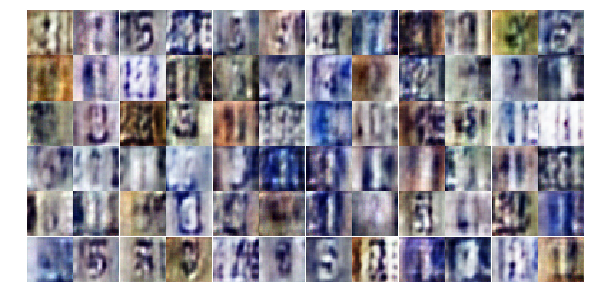

Epoch 4/25... Discriminator Loss: 0.4857... Generator Loss: 2.1991
Epoch 4/25... Discriminator Loss: 0.2195... Generator Loss: 4.6247
Epoch 4/25... Discriminator Loss: 1.6675... Generator Loss: 0.2885
Epoch 4/25... Discriminator Loss: 0.3638... Generator Loss: 3.1602
Epoch 4/25... Discriminator Loss: 0.3598... Generator Loss: 1.9558
Epoch 4/25... Discriminator Loss: 0.0949... Generator Loss: 3.7763
Epoch 4/25... Discriminator Loss: 0.1733... Generator Loss: 3.6915
Epoch 4/25... Discriminator Loss: 0.7092... Generator Loss: 0.9345
Epoch 4/25... Discriminator Loss: 0.3090... Generator Loss: 2.1699
Epoch 4/25... Discriminator Loss: 0.1379... Generator Loss: 3.0065


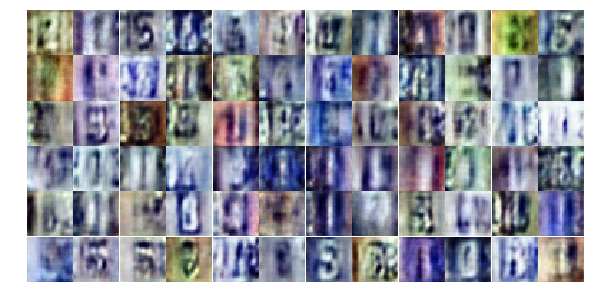

Epoch 4/25... Discriminator Loss: 1.5818... Generator Loss: 0.3846
Epoch 4/25... Discriminator Loss: 0.1929... Generator Loss: 5.5740
Epoch 4/25... Discriminator Loss: 0.1349... Generator Loss: 3.9672
Epoch 4/25... Discriminator Loss: 0.2444... Generator Loss: 2.5486
Epoch 4/25... Discriminator Loss: 0.2235... Generator Loss: 5.3476
Epoch 4/25... Discriminator Loss: 0.5269... Generator Loss: 5.0142
Epoch 4/25... Discriminator Loss: 0.6394... Generator Loss: 3.6014
Epoch 4/25... Discriminator Loss: 0.2710... Generator Loss: 2.8285
Epoch 4/25... Discriminator Loss: 1.9701... Generator Loss: 0.2034
Epoch 4/25... Discriminator Loss: 1.1367... Generator Loss: 0.5543


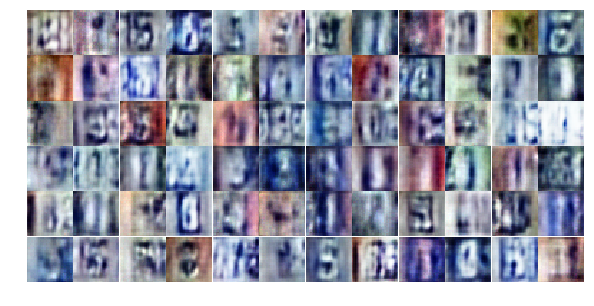

Epoch 4/25... Discriminator Loss: 0.4069... Generator Loss: 1.8589
Epoch 4/25... Discriminator Loss: 0.2011... Generator Loss: 2.8639
Epoch 4/25... Discriminator Loss: 0.2042... Generator Loss: 3.3602
Epoch 4/25... Discriminator Loss: 0.2326... Generator Loss: 3.2520
Epoch 4/25... Discriminator Loss: 0.3087... Generator Loss: 3.0928
Epoch 4/25... Discriminator Loss: 0.6252... Generator Loss: 1.2060
Epoch 4/25... Discriminator Loss: 0.3235... Generator Loss: 5.0265
Epoch 4/25... Discriminator Loss: 1.1393... Generator Loss: 3.8286
Epoch 4/25... Discriminator Loss: 0.2130... Generator Loss: 2.4696
Epoch 4/25... Discriminator Loss: 0.5224... Generator Loss: 1.3190


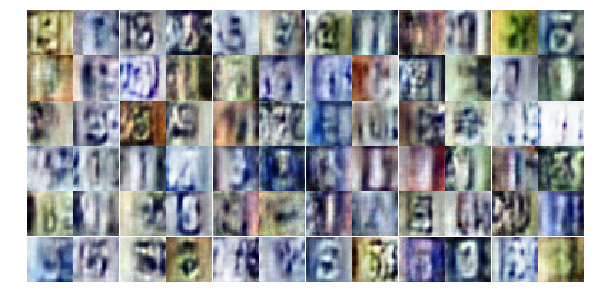

Epoch 4/25... Discriminator Loss: 0.2547... Generator Loss: 2.7107
Epoch 4/25... Discriminator Loss: 0.8691... Generator Loss: 1.8598
Epoch 4/25... Discriminator Loss: 1.5484... Generator Loss: 0.3438
Epoch 4/25... Discriminator Loss: 0.3577... Generator Loss: 1.6193
Epoch 4/25... Discriminator Loss: 0.6107... Generator Loss: 1.1579
Epoch 4/25... Discriminator Loss: 0.9038... Generator Loss: 0.6758
Epoch 4/25... Discriminator Loss: 0.8629... Generator Loss: 0.7948
Epoch 4/25... Discriminator Loss: 0.6624... Generator Loss: 1.0149
Epoch 4/25... Discriminator Loss: 0.2313... Generator Loss: 2.9327
Epoch 5/25... Discriminator Loss: 0.9281... Generator Loss: 0.6549


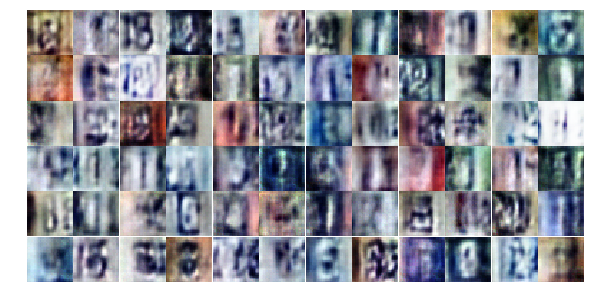

Epoch 5/25... Discriminator Loss: 0.2661... Generator Loss: 3.4417
Epoch 5/25... Discriminator Loss: 0.7711... Generator Loss: 0.8646
Epoch 5/25... Discriminator Loss: 0.1064... Generator Loss: 3.3553
Epoch 5/25... Discriminator Loss: 0.1680... Generator Loss: 3.1846
Epoch 5/25... Discriminator Loss: 0.3115... Generator Loss: 3.9871
Epoch 5/25... Discriminator Loss: 0.6034... Generator Loss: 1.1174
Epoch 5/25... Discriminator Loss: 0.3352... Generator Loss: 4.4420
Epoch 5/25... Discriminator Loss: 1.0324... Generator Loss: 0.6157
Epoch 5/25... Discriminator Loss: 1.2519... Generator Loss: 6.3257
Epoch 5/25... Discriminator Loss: 0.3403... Generator Loss: 1.7033


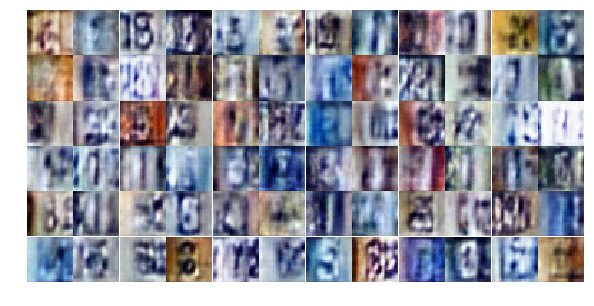

Epoch 5/25... Discriminator Loss: 0.9457... Generator Loss: 0.7654
Epoch 5/25... Discriminator Loss: 0.4798... Generator Loss: 4.8140
Epoch 5/25... Discriminator Loss: 0.5829... Generator Loss: 1.4493
Epoch 5/25... Discriminator Loss: 0.7391... Generator Loss: 0.9161
Epoch 5/25... Discriminator Loss: 0.4273... Generator Loss: 1.6142
Epoch 5/25... Discriminator Loss: 0.1460... Generator Loss: 3.1362
Epoch 5/25... Discriminator Loss: 0.2728... Generator Loss: 2.3886
Epoch 5/25... Discriminator Loss: 0.2062... Generator Loss: 2.4293
Epoch 5/25... Discriminator Loss: 0.2019... Generator Loss: 2.5143
Epoch 5/25... Discriminator Loss: 0.6340... Generator Loss: 0.9863


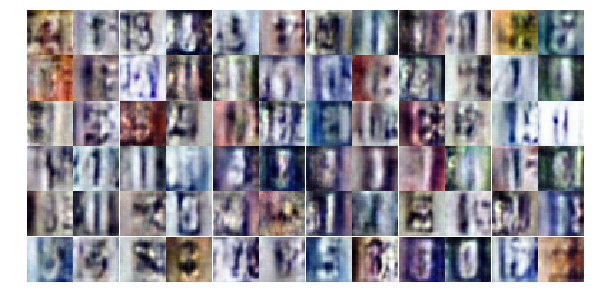

Epoch 5/25... Discriminator Loss: 0.3846... Generator Loss: 2.4494
Epoch 5/25... Discriminator Loss: 0.3176... Generator Loss: 2.1739
Epoch 5/25... Discriminator Loss: 0.2426... Generator Loss: 2.8808
Epoch 5/25... Discriminator Loss: 0.2379... Generator Loss: 2.3874
Epoch 5/25... Discriminator Loss: 1.5784... Generator Loss: 2.5913
Epoch 5/25... Discriminator Loss: 1.1564... Generator Loss: 0.5747
Epoch 5/25... Discriminator Loss: 0.5581... Generator Loss: 3.2410
Epoch 5/25... Discriminator Loss: 0.3144... Generator Loss: 2.2407
Epoch 5/25... Discriminator Loss: 0.3093... Generator Loss: 3.7288
Epoch 5/25... Discriminator Loss: 0.3395... Generator Loss: 3.1010


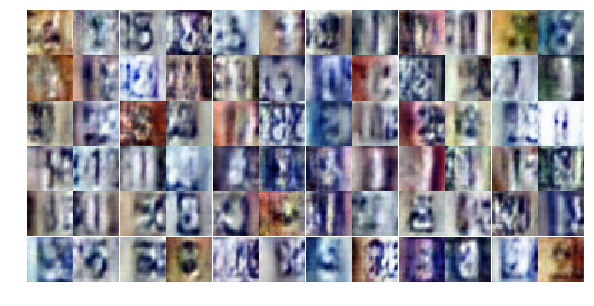

Epoch 5/25... Discriminator Loss: 0.9524... Generator Loss: 0.7283
Epoch 5/25... Discriminator Loss: 0.1715... Generator Loss: 2.9791
Epoch 5/25... Discriminator Loss: 1.1274... Generator Loss: 0.5347
Epoch 5/25... Discriminator Loss: 0.2096... Generator Loss: 2.4456
Epoch 5/25... Discriminator Loss: 0.4958... Generator Loss: 1.4307
Epoch 5/25... Discriminator Loss: 0.5649... Generator Loss: 4.3516
Epoch 5/25... Discriminator Loss: 0.2331... Generator Loss: 2.7474
Epoch 5/25... Discriminator Loss: 0.2872... Generator Loss: 1.9774
Epoch 5/25... Discriminator Loss: 0.4727... Generator Loss: 1.9401
Epoch 5/25... Discriminator Loss: 1.1095... Generator Loss: 0.6293


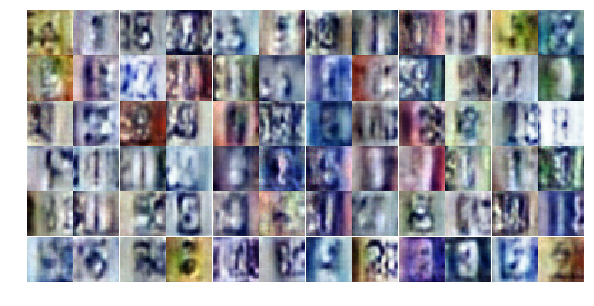

Epoch 5/25... Discriminator Loss: 0.6751... Generator Loss: 1.0231
Epoch 5/25... Discriminator Loss: 0.3325... Generator Loss: 3.8613
Epoch 5/25... Discriminator Loss: 0.5489... Generator Loss: 1.1327
Epoch 5/25... Discriminator Loss: 0.1657... Generator Loss: 3.6053
Epoch 5/25... Discriminator Loss: 0.9526... Generator Loss: 0.8120
Epoch 5/25... Discriminator Loss: 0.3185... Generator Loss: 2.2509
Epoch 5/25... Discriminator Loss: 0.2250... Generator Loss: 4.8291
Epoch 5/25... Discriminator Loss: 0.4332... Generator Loss: 1.8468
Epoch 5/25... Discriminator Loss: 0.5505... Generator Loss: 1.1275
Epoch 5/25... Discriminator Loss: 0.1496... Generator Loss: 4.2465


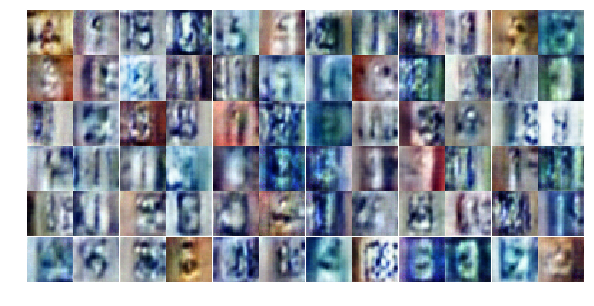

Epoch 5/25... Discriminator Loss: 0.2806... Generator Loss: 2.0912
Epoch 5/25... Discriminator Loss: 0.2652... Generator Loss: 2.1027
Epoch 5/25... Discriminator Loss: 0.9112... Generator Loss: 0.7392
Epoch 5/25... Discriminator Loss: 0.7599... Generator Loss: 0.8636
Epoch 5/25... Discriminator Loss: 0.5293... Generator Loss: 1.3205
Epoch 5/25... Discriminator Loss: 0.1097... Generator Loss: 5.3067
Epoch 6/25... Discriminator Loss: 0.1654... Generator Loss: 2.5148
Epoch 6/25... Discriminator Loss: 1.0289... Generator Loss: 0.6161
Epoch 6/25... Discriminator Loss: 0.3621... Generator Loss: 2.7559
Epoch 6/25... Discriminator Loss: 0.3440... Generator Loss: 4.5957


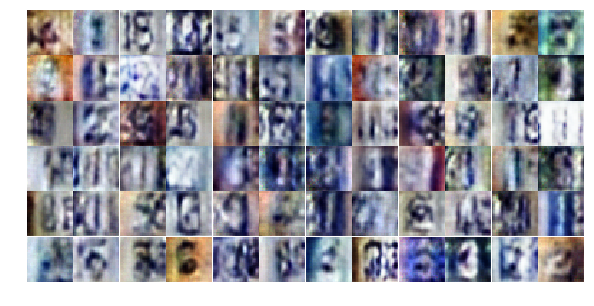

Epoch 6/25... Discriminator Loss: 0.2562... Generator Loss: 2.8287
Epoch 6/25... Discriminator Loss: 0.6118... Generator Loss: 1.1313
Epoch 6/25... Discriminator Loss: 0.7754... Generator Loss: 0.8229
Epoch 6/25... Discriminator Loss: 0.7010... Generator Loss: 0.9729
Epoch 6/25... Discriminator Loss: 0.1087... Generator Loss: 4.4969
Epoch 6/25... Discriminator Loss: 0.2534... Generator Loss: 2.1451
Epoch 6/25... Discriminator Loss: 0.7208... Generator Loss: 4.4666
Epoch 6/25... Discriminator Loss: 0.7159... Generator Loss: 1.1127
Epoch 6/25... Discriminator Loss: 0.4205... Generator Loss: 1.4574
Epoch 6/25... Discriminator Loss: 0.3302... Generator Loss: 2.1837


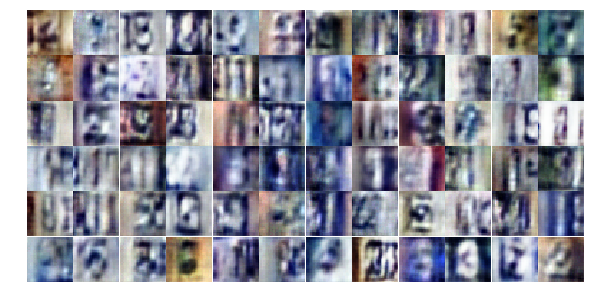

Epoch 6/25... Discriminator Loss: 0.9519... Generator Loss: 0.6427
Epoch 6/25... Discriminator Loss: 0.4354... Generator Loss: 1.3704
Epoch 6/25... Discriminator Loss: 0.1993... Generator Loss: 2.4401
Epoch 6/25... Discriminator Loss: 0.0564... Generator Loss: 3.8082
Epoch 6/25... Discriminator Loss: 0.4706... Generator Loss: 1.9936
Epoch 6/25... Discriminator Loss: 0.2745... Generator Loss: 3.6384
Epoch 6/25... Discriminator Loss: 0.1130... Generator Loss: 3.2074
Epoch 6/25... Discriminator Loss: 0.1551... Generator Loss: 3.3625
Epoch 6/25... Discriminator Loss: 0.1154... Generator Loss: 3.1799
Epoch 6/25... Discriminator Loss: 0.1953... Generator Loss: 2.6080


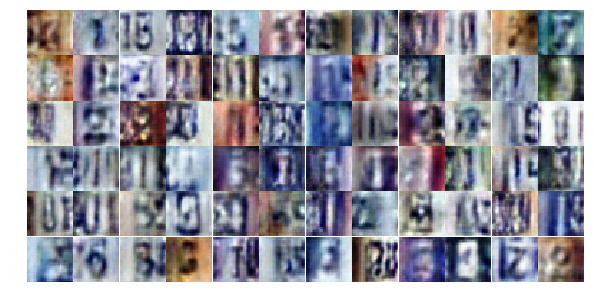

Epoch 6/25... Discriminator Loss: 0.1004... Generator Loss: 3.4587
Epoch 6/25... Discriminator Loss: 0.2895... Generator Loss: 1.9427
Epoch 6/25... Discriminator Loss: 0.1439... Generator Loss: 3.3682
Epoch 6/25... Discriminator Loss: 0.5976... Generator Loss: 1.0519
Epoch 6/25... Discriminator Loss: 0.1624... Generator Loss: 3.0039
Epoch 6/25... Discriminator Loss: 3.3679... Generator Loss: 4.7026
Epoch 6/25... Discriminator Loss: 1.3515... Generator Loss: 0.5696
Epoch 6/25... Discriminator Loss: 0.5028... Generator Loss: 3.8319
Epoch 6/25... Discriminator Loss: 0.5822... Generator Loss: 1.5127
Epoch 6/25... Discriminator Loss: 0.2729... Generator Loss: 2.5023


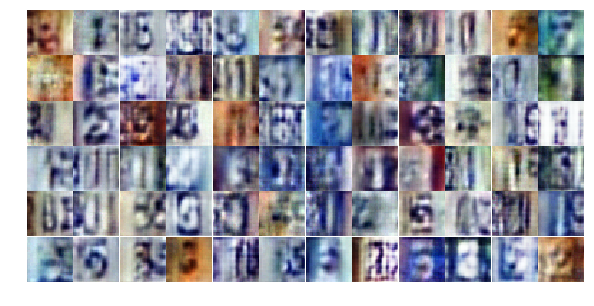

Epoch 6/25... Discriminator Loss: 0.7359... Generator Loss: 3.1771
Epoch 6/25... Discriminator Loss: 0.7662... Generator Loss: 5.9301
Epoch 6/25... Discriminator Loss: 0.4289... Generator Loss: 1.8028
Epoch 6/25... Discriminator Loss: 0.8502... Generator Loss: 0.7716
Epoch 6/25... Discriminator Loss: 0.2549... Generator Loss: 2.2317
Epoch 6/25... Discriminator Loss: 0.5348... Generator Loss: 1.4691
Epoch 6/25... Discriminator Loss: 0.1983... Generator Loss: 3.0286
Epoch 6/25... Discriminator Loss: 0.1718... Generator Loss: 2.7091
Epoch 6/25... Discriminator Loss: 0.5165... Generator Loss: 1.4538
Epoch 6/25... Discriminator Loss: 0.1200... Generator Loss: 3.6759


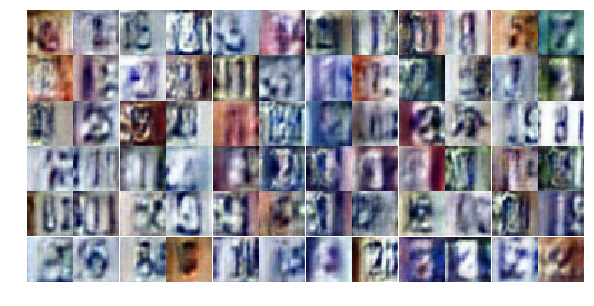

Epoch 6/25... Discriminator Loss: 2.1798... Generator Loss: 0.2884
Epoch 6/25... Discriminator Loss: 0.9608... Generator Loss: 0.9482
Epoch 6/25... Discriminator Loss: 1.1926... Generator Loss: 0.5671
Epoch 6/25... Discriminator Loss: 1.2755... Generator Loss: 0.4464
Epoch 6/25... Discriminator Loss: 0.2489... Generator Loss: 1.9806
Epoch 6/25... Discriminator Loss: 0.4525... Generator Loss: 1.7081
Epoch 6/25... Discriminator Loss: 0.2980... Generator Loss: 2.5365
Epoch 6/25... Discriminator Loss: 0.5289... Generator Loss: 1.2648
Epoch 6/25... Discriminator Loss: 0.6362... Generator Loss: 1.0841
Epoch 6/25... Discriminator Loss: 0.6463... Generator Loss: 1.0397


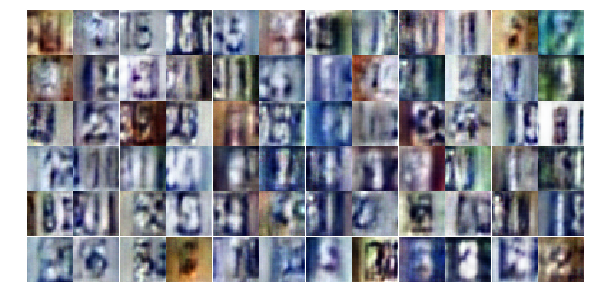

Epoch 6/25... Discriminator Loss: 0.2481... Generator Loss: 2.3337
Epoch 6/25... Discriminator Loss: 0.3044... Generator Loss: 1.8411
Epoch 6/25... Discriminator Loss: 0.3803... Generator Loss: 1.5137
Epoch 7/25... Discriminator Loss: 0.2085... Generator Loss: 2.8632
Epoch 7/25... Discriminator Loss: 0.5126... Generator Loss: 1.2475
Epoch 7/25... Discriminator Loss: 0.1678... Generator Loss: 2.9090
Epoch 7/25... Discriminator Loss: 0.8683... Generator Loss: 0.7782
Epoch 7/25... Discriminator Loss: 0.5571... Generator Loss: 1.4630
Epoch 7/25... Discriminator Loss: 0.3735... Generator Loss: 2.1171
Epoch 7/25... Discriminator Loss: 0.3651... Generator Loss: 1.9068


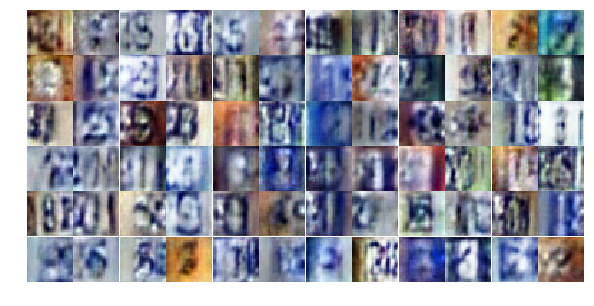

Epoch 7/25... Discriminator Loss: 0.5881... Generator Loss: 1.0945
Epoch 7/25... Discriminator Loss: 0.1894... Generator Loss: 3.3673
Epoch 7/25... Discriminator Loss: 0.7892... Generator Loss: 0.8249
Epoch 7/25... Discriminator Loss: 0.1988... Generator Loss: 2.5797
Epoch 7/25... Discriminator Loss: 0.3636... Generator Loss: 1.6568
Epoch 7/25... Discriminator Loss: 0.2421... Generator Loss: 2.6267
Epoch 7/25... Discriminator Loss: 0.3347... Generator Loss: 1.6139
Epoch 7/25... Discriminator Loss: 0.8646... Generator Loss: 0.7527
Epoch 7/25... Discriminator Loss: 0.5082... Generator Loss: 4.8874
Epoch 7/25... Discriminator Loss: 0.7634... Generator Loss: 0.9142


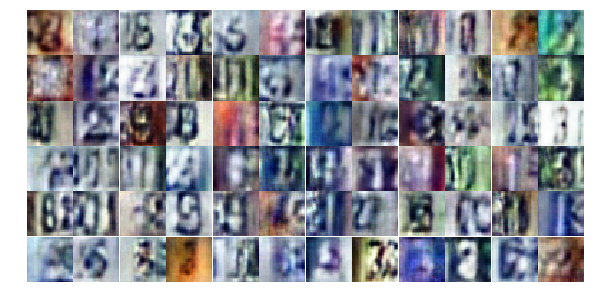

Epoch 7/25... Discriminator Loss: 0.6367... Generator Loss: 6.6078
Epoch 7/25... Discriminator Loss: 2.1276... Generator Loss: 0.4847
Epoch 7/25... Discriminator Loss: 1.0862... Generator Loss: 0.9046
Epoch 7/25... Discriminator Loss: 0.5091... Generator Loss: 1.4309
Epoch 7/25... Discriminator Loss: 0.3170... Generator Loss: 2.4582
Epoch 7/25... Discriminator Loss: 0.3621... Generator Loss: 3.5408
Epoch 7/25... Discriminator Loss: 0.4460... Generator Loss: 1.4879
Epoch 7/25... Discriminator Loss: 0.5332... Generator Loss: 1.2701
Epoch 7/25... Discriminator Loss: 0.2874... Generator Loss: 2.2577
Epoch 7/25... Discriminator Loss: 0.3187... Generator Loss: 2.5079


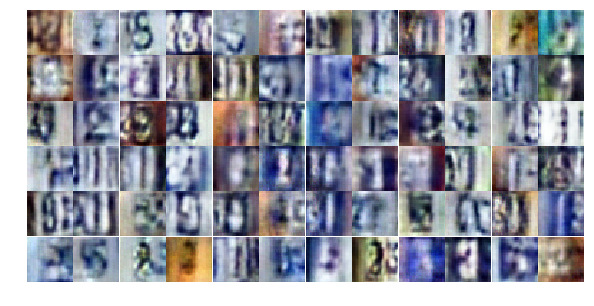

Epoch 7/25... Discriminator Loss: 0.3777... Generator Loss: 1.7282
Epoch 7/25... Discriminator Loss: 0.1419... Generator Loss: 2.7107
Epoch 7/25... Discriminator Loss: 0.1953... Generator Loss: 3.3103
Epoch 7/25... Discriminator Loss: 1.5844... Generator Loss: 0.3480
Epoch 7/25... Discriminator Loss: 0.4480... Generator Loss: 2.3916
Epoch 7/25... Discriminator Loss: 0.4475... Generator Loss: 1.4519
Epoch 7/25... Discriminator Loss: 0.2387... Generator Loss: 2.6170
Epoch 7/25... Discriminator Loss: 0.2797... Generator Loss: 4.4291
Epoch 7/25... Discriminator Loss: 1.0187... Generator Loss: 0.6078
Epoch 7/25... Discriminator Loss: 0.2429... Generator Loss: 2.1603


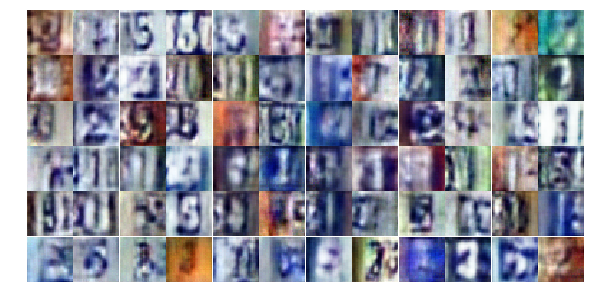

Epoch 7/25... Discriminator Loss: 0.5459... Generator Loss: 1.2564
Epoch 7/25... Discriminator Loss: 0.4192... Generator Loss: 1.4143
Epoch 7/25... Discriminator Loss: 0.1624... Generator Loss: 2.7935
Epoch 7/25... Discriminator Loss: 0.3570... Generator Loss: 1.6404
Epoch 7/25... Discriminator Loss: 0.2616... Generator Loss: 2.0898
Epoch 7/25... Discriminator Loss: 0.2472... Generator Loss: 1.9696
Epoch 7/25... Discriminator Loss: 0.1820... Generator Loss: 2.4758
Epoch 7/25... Discriminator Loss: 2.8726... Generator Loss: 0.1409
Epoch 7/25... Discriminator Loss: 0.7729... Generator Loss: 2.2783
Epoch 7/25... Discriminator Loss: 1.0931... Generator Loss: 0.6024


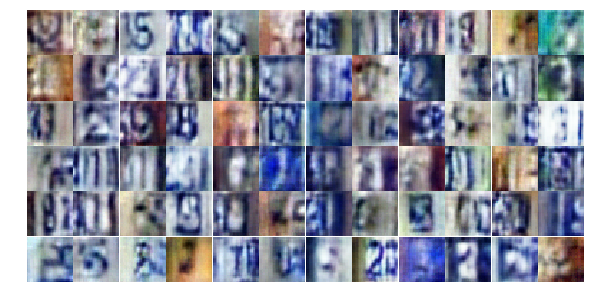

Epoch 7/25... Discriminator Loss: 0.5747... Generator Loss: 1.7662
Epoch 7/25... Discriminator Loss: 0.4924... Generator Loss: 1.3307
Epoch 7/25... Discriminator Loss: 0.8461... Generator Loss: 0.8512
Epoch 7/25... Discriminator Loss: 0.4215... Generator Loss: 1.9135
Epoch 7/25... Discriminator Loss: 0.3588... Generator Loss: 2.2467
Epoch 7/25... Discriminator Loss: 0.3341... Generator Loss: 2.2047
Epoch 7/25... Discriminator Loss: 0.9695... Generator Loss: 0.7132
Epoch 7/25... Discriminator Loss: 0.2852... Generator Loss: 3.5070
Epoch 7/25... Discriminator Loss: 0.8399... Generator Loss: 0.7322
Epoch 7/25... Discriminator Loss: 0.3262... Generator Loss: 1.6700


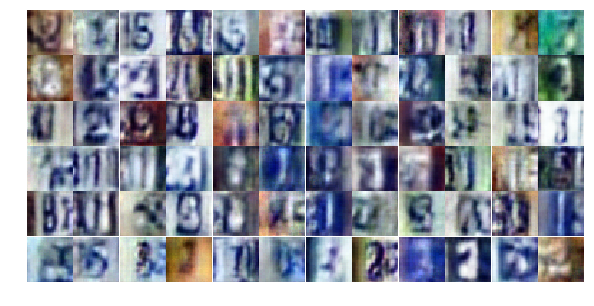

Epoch 7/25... Discriminator Loss: 0.4413... Generator Loss: 1.8197
Epoch 8/25... Discriminator Loss: 0.4678... Generator Loss: 1.3588
Epoch 8/25... Discriminator Loss: 0.8874... Generator Loss: 0.6938
Epoch 8/25... Discriminator Loss: 0.2704... Generator Loss: 2.3189
Epoch 8/25... Discriminator Loss: 0.2318... Generator Loss: 2.8779
Epoch 8/25... Discriminator Loss: 0.4560... Generator Loss: 1.3106
Epoch 8/25... Discriminator Loss: 0.3495... Generator Loss: 2.5107
Epoch 8/25... Discriminator Loss: 0.4259... Generator Loss: 1.9936
Epoch 8/25... Discriminator Loss: 0.9511... Generator Loss: 0.8865
Epoch 8/25... Discriminator Loss: 0.4549... Generator Loss: 1.4565


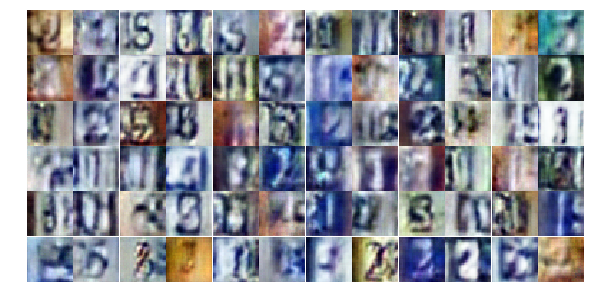

Epoch 8/25... Discriminator Loss: 0.3227... Generator Loss: 2.0960
Epoch 8/25... Discriminator Loss: 0.4182... Generator Loss: 1.8241
Epoch 8/25... Discriminator Loss: 0.3502... Generator Loss: 1.7631
Epoch 8/25... Discriminator Loss: 0.1612... Generator Loss: 2.9225
Epoch 8/25... Discriminator Loss: 0.4309... Generator Loss: 3.1350
Epoch 8/25... Discriminator Loss: 1.7432... Generator Loss: 3.4991
Epoch 8/25... Discriminator Loss: 1.5181... Generator Loss: 0.8948
Epoch 8/25... Discriminator Loss: 1.1727... Generator Loss: 0.5412
Epoch 8/25... Discriminator Loss: 0.2432... Generator Loss: 2.5392
Epoch 8/25... Discriminator Loss: 0.5631... Generator Loss: 1.4958


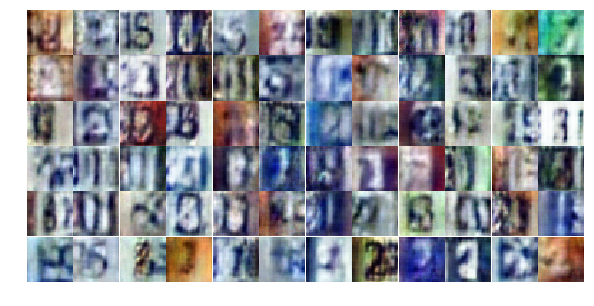

Epoch 8/25... Discriminator Loss: 0.4072... Generator Loss: 3.2879
Epoch 8/25... Discriminator Loss: 0.3883... Generator Loss: 1.6674
Epoch 8/25... Discriminator Loss: 0.6294... Generator Loss: 1.0561
Epoch 8/25... Discriminator Loss: 0.3910... Generator Loss: 1.5549
Epoch 8/25... Discriminator Loss: 0.3542... Generator Loss: 1.8498
Epoch 8/25... Discriminator Loss: 0.5590... Generator Loss: 1.1892
Epoch 8/25... Discriminator Loss: 0.4260... Generator Loss: 1.5765
Epoch 8/25... Discriminator Loss: 0.2374... Generator Loss: 2.3013
Epoch 8/25... Discriminator Loss: 0.5031... Generator Loss: 2.2264
Epoch 8/25... Discriminator Loss: 1.0374... Generator Loss: 0.5938


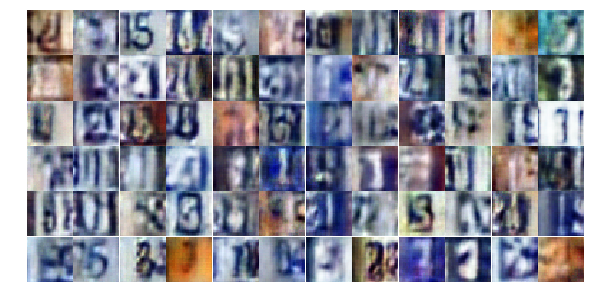

Epoch 8/25... Discriminator Loss: 0.4225... Generator Loss: 1.5539
Epoch 8/25... Discriminator Loss: 0.4687... Generator Loss: 1.6058
Epoch 8/25... Discriminator Loss: 0.3392... Generator Loss: 1.9151
Epoch 8/25... Discriminator Loss: 0.4832... Generator Loss: 1.3165
Epoch 8/25... Discriminator Loss: 0.3974... Generator Loss: 1.6735
Epoch 8/25... Discriminator Loss: 0.2386... Generator Loss: 1.9291
Epoch 8/25... Discriminator Loss: 0.2742... Generator Loss: 2.2279
Epoch 8/25... Discriminator Loss: 0.4177... Generator Loss: 1.5370
Epoch 8/25... Discriminator Loss: 0.3751... Generator Loss: 1.7059
Epoch 8/25... Discriminator Loss: 0.3800... Generator Loss: 1.6485


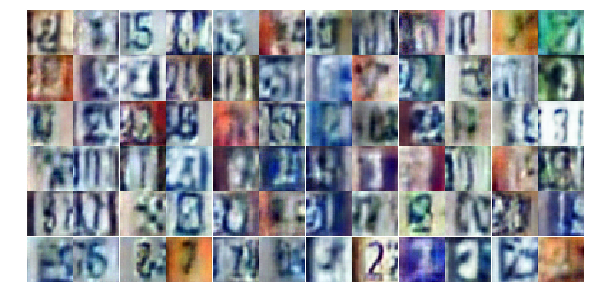

Epoch 8/25... Discriminator Loss: 0.3731... Generator Loss: 1.5347
Epoch 8/25... Discriminator Loss: 0.1771... Generator Loss: 3.2711
Epoch 8/25... Discriminator Loss: 0.3842... Generator Loss: 1.4997
Epoch 8/25... Discriminator Loss: 0.7667... Generator Loss: 5.4633
Epoch 8/25... Discriminator Loss: 2.4144... Generator Loss: 3.7866
Epoch 8/25... Discriminator Loss: 0.7093... Generator Loss: 1.1037
Epoch 8/25... Discriminator Loss: 0.3469... Generator Loss: 1.9825
Epoch 8/25... Discriminator Loss: 0.8475... Generator Loss: 0.8465
Epoch 8/25... Discriminator Loss: 1.0563... Generator Loss: 0.6076
Epoch 8/25... Discriminator Loss: 0.4442... Generator Loss: 1.7662


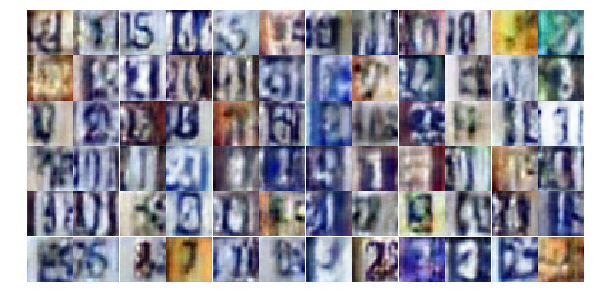

Epoch 8/25... Discriminator Loss: 0.4356... Generator Loss: 1.5077
Epoch 8/25... Discriminator Loss: 0.3933... Generator Loss: 1.6264
Epoch 8/25... Discriminator Loss: 0.3787... Generator Loss: 1.6559
Epoch 8/25... Discriminator Loss: 1.0948... Generator Loss: 0.6186
Epoch 8/25... Discriminator Loss: 0.4326... Generator Loss: 1.8835
Epoch 8/25... Discriminator Loss: 0.5629... Generator Loss: 1.2081
Epoch 8/25... Discriminator Loss: 0.3398... Generator Loss: 1.6694
Epoch 8/25... Discriminator Loss: 0.4049... Generator Loss: 1.6301
Epoch 9/25... Discriminator Loss: 0.5242... Generator Loss: 1.5440
Epoch 9/25... Discriminator Loss: 0.8746... Generator Loss: 0.7348


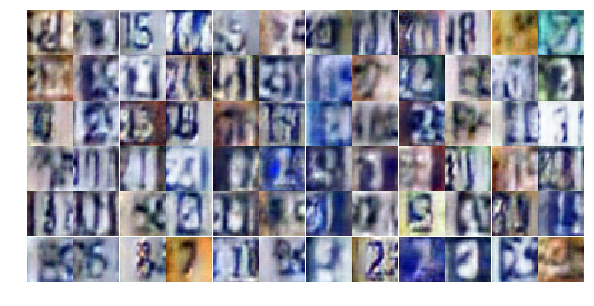

Epoch 9/25... Discriminator Loss: 0.3450... Generator Loss: 1.8229
Epoch 9/25... Discriminator Loss: 0.5383... Generator Loss: 1.6082
Epoch 9/25... Discriminator Loss: 0.5662... Generator Loss: 1.1798
Epoch 9/25... Discriminator Loss: 0.2538... Generator Loss: 2.4486
Epoch 9/25... Discriminator Loss: 0.9201... Generator Loss: 0.7567
Epoch 9/25... Discriminator Loss: 0.3524... Generator Loss: 2.8171
Epoch 9/25... Discriminator Loss: 1.0234... Generator Loss: 0.6012
Epoch 9/25... Discriminator Loss: 0.4425... Generator Loss: 1.4413
Epoch 9/25... Discriminator Loss: 0.4905... Generator Loss: 1.7786
Epoch 9/25... Discriminator Loss: 0.6415... Generator Loss: 0.9951


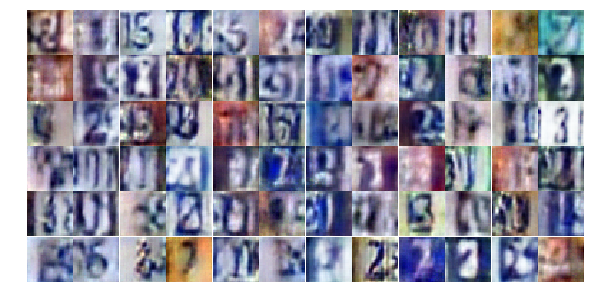

Epoch 9/25... Discriminator Loss: 0.5201... Generator Loss: 1.2420
Epoch 9/25... Discriminator Loss: 1.6917... Generator Loss: 0.3094
Epoch 9/25... Discriminator Loss: 0.3989... Generator Loss: 2.3030
Epoch 9/25... Discriminator Loss: 0.4733... Generator Loss: 1.3192
Epoch 9/25... Discriminator Loss: 0.4747... Generator Loss: 1.3337
Epoch 9/25... Discriminator Loss: 0.5848... Generator Loss: 1.0870
Epoch 9/25... Discriminator Loss: 0.7239... Generator Loss: 0.9009
Epoch 9/25... Discriminator Loss: 0.5665... Generator Loss: 1.1424
Epoch 9/25... Discriminator Loss: 0.7176... Generator Loss: 0.9171
Epoch 9/25... Discriminator Loss: 0.6061... Generator Loss: 2.8217


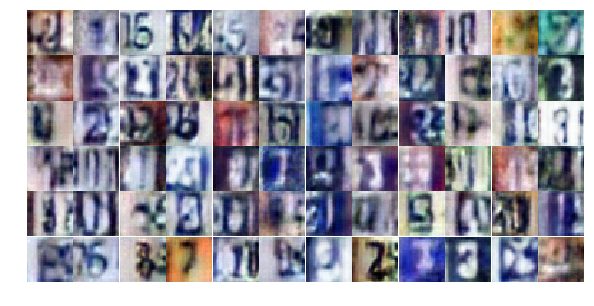

Epoch 9/25... Discriminator Loss: 0.5456... Generator Loss: 2.0366
Epoch 9/25... Discriminator Loss: 0.9182... Generator Loss: 0.6741
Epoch 9/25... Discriminator Loss: 0.5198... Generator Loss: 1.3312
Epoch 9/25... Discriminator Loss: 0.3657... Generator Loss: 1.7867
Epoch 9/25... Discriminator Loss: 1.3204... Generator Loss: 4.4653
Epoch 9/25... Discriminator Loss: 2.8391... Generator Loss: 0.1037
Epoch 9/25... Discriminator Loss: 1.4016... Generator Loss: 0.5841
Epoch 9/25... Discriminator Loss: 1.6469... Generator Loss: 0.8957
Epoch 9/25... Discriminator Loss: 1.3614... Generator Loss: 0.6996
Epoch 9/25... Discriminator Loss: 1.2728... Generator Loss: 0.8693


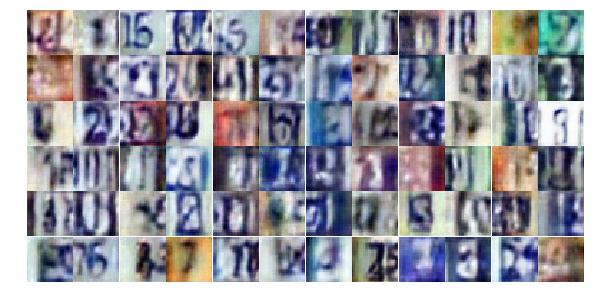

Epoch 9/25... Discriminator Loss: 1.1325... Generator Loss: 0.8333
Epoch 9/25... Discriminator Loss: 1.0730... Generator Loss: 0.9837
Epoch 9/25... Discriminator Loss: 1.5485... Generator Loss: 0.5200
Epoch 9/25... Discriminator Loss: 1.1291... Generator Loss: 0.8518
Epoch 9/25... Discriminator Loss: 0.7584... Generator Loss: 1.5045
Epoch 9/25... Discriminator Loss: 0.9588... Generator Loss: 1.2241
Epoch 9/25... Discriminator Loss: 0.9238... Generator Loss: 1.8891
Epoch 9/25... Discriminator Loss: 0.5576... Generator Loss: 1.4211
Epoch 9/25... Discriminator Loss: 1.0566... Generator Loss: 0.6243
Epoch 9/25... Discriminator Loss: 0.8534... Generator Loss: 0.8495


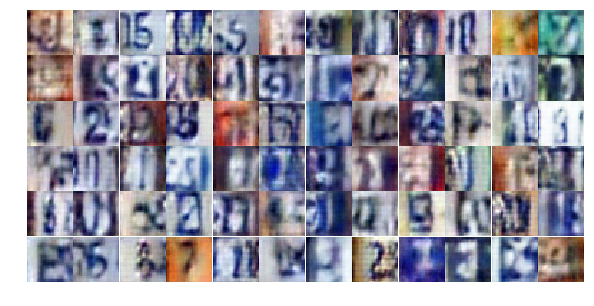

Epoch 9/25... Discriminator Loss: 0.7224... Generator Loss: 1.1319
Epoch 9/25... Discriminator Loss: 0.6176... Generator Loss: 1.2542
Epoch 9/25... Discriminator Loss: 1.0853... Generator Loss: 0.6652
Epoch 9/25... Discriminator Loss: 0.7309... Generator Loss: 0.9948
Epoch 9/25... Discriminator Loss: 0.4576... Generator Loss: 1.4763
Epoch 9/25... Discriminator Loss: 0.5543... Generator Loss: 1.3060
Epoch 9/25... Discriminator Loss: 0.6705... Generator Loss: 1.1727
Epoch 9/25... Discriminator Loss: 0.7754... Generator Loss: 0.8742
Epoch 9/25... Discriminator Loss: 0.4631... Generator Loss: 1.4710
Epoch 9/25... Discriminator Loss: 0.4430... Generator Loss: 2.1907


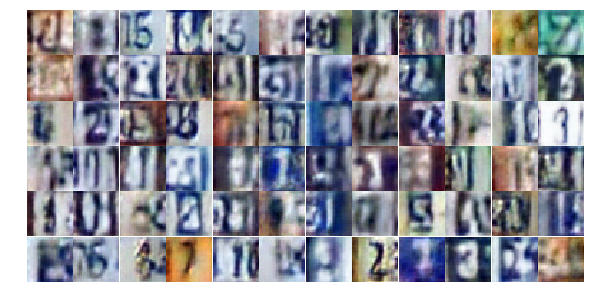

Epoch 9/25... Discriminator Loss: 0.8455... Generator Loss: 0.9409
Epoch 9/25... Discriminator Loss: 0.8121... Generator Loss: 3.2539
Epoch 9/25... Discriminator Loss: 0.5911... Generator Loss: 1.1522
Epoch 9/25... Discriminator Loss: 0.8466... Generator Loss: 0.7343
Epoch 9/25... Discriminator Loss: 0.6633... Generator Loss: 0.9842
Epoch 10/25... Discriminator Loss: 0.4486... Generator Loss: 1.4498
Epoch 10/25... Discriminator Loss: 0.3870... Generator Loss: 1.5803
Epoch 10/25... Discriminator Loss: 0.5392... Generator Loss: 1.1744
Epoch 10/25... Discriminator Loss: 0.5463... Generator Loss: 1.7214
Epoch 10/25... Discriminator Loss: 1.0003... Generator Loss: 0.6513


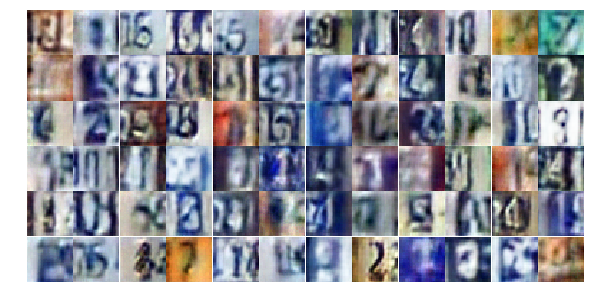

Epoch 10/25... Discriminator Loss: 0.6493... Generator Loss: 1.0373
Epoch 10/25... Discriminator Loss: 0.5257... Generator Loss: 1.2621
Epoch 10/25... Discriminator Loss: 0.4487... Generator Loss: 1.6023
Epoch 10/25... Discriminator Loss: 0.4957... Generator Loss: 1.5142
Epoch 10/25... Discriminator Loss: 0.4480... Generator Loss: 1.4800
Epoch 10/25... Discriminator Loss: 1.2472... Generator Loss: 0.4753
Epoch 10/25... Discriminator Loss: 0.5888... Generator Loss: 1.2038
Epoch 10/25... Discriminator Loss: 1.1813... Generator Loss: 0.5647
Epoch 10/25... Discriminator Loss: 0.7896... Generator Loss: 0.8660
Epoch 10/25... Discriminator Loss: 0.5050... Generator Loss: 1.3097


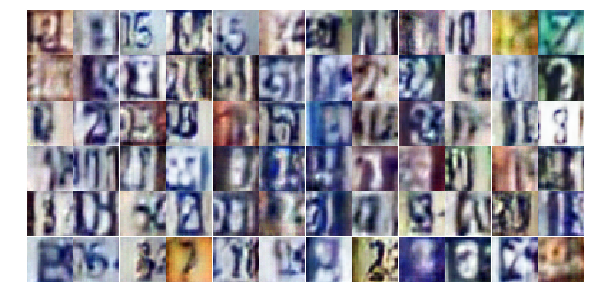

Epoch 10/25... Discriminator Loss: 0.6380... Generator Loss: 1.2037
Epoch 10/25... Discriminator Loss: 0.7750... Generator Loss: 1.2608
Epoch 10/25... Discriminator Loss: 0.6961... Generator Loss: 1.0424
Epoch 10/25... Discriminator Loss: 1.0589... Generator Loss: 0.5893
Epoch 10/25... Discriminator Loss: 0.5483... Generator Loss: 1.2990
Epoch 10/25... Discriminator Loss: 0.4799... Generator Loss: 1.5850
Epoch 10/25... Discriminator Loss: 0.3725... Generator Loss: 1.9011
Epoch 10/25... Discriminator Loss: 0.3987... Generator Loss: 1.5269
Epoch 10/25... Discriminator Loss: 0.4038... Generator Loss: 1.6138
Epoch 10/25... Discriminator Loss: 0.2482... Generator Loss: 1.9360


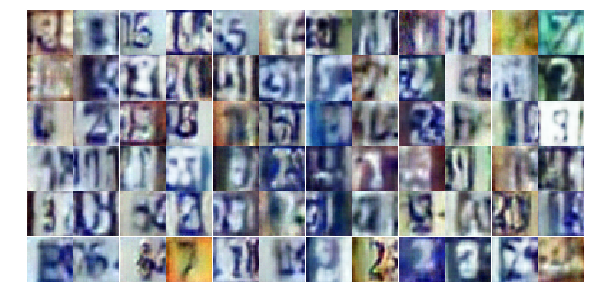

Epoch 10/25... Discriminator Loss: 0.5547... Generator Loss: 1.1136
Epoch 10/25... Discriminator Loss: 0.6570... Generator Loss: 1.2642
Epoch 10/25... Discriminator Loss: 0.3372... Generator Loss: 1.5842
Epoch 10/25... Discriminator Loss: 1.0823... Generator Loss: 4.0317
Epoch 10/25... Discriminator Loss: 0.9315... Generator Loss: 0.6828
Epoch 10/25... Discriminator Loss: 0.6813... Generator Loss: 0.9864
Epoch 10/25... Discriminator Loss: 0.3824... Generator Loss: 1.5895
Epoch 10/25... Discriminator Loss: 0.4819... Generator Loss: 1.9266
Epoch 10/25... Discriminator Loss: 0.3650... Generator Loss: 1.5602
Epoch 10/25... Discriminator Loss: 0.3588... Generator Loss: 1.5910


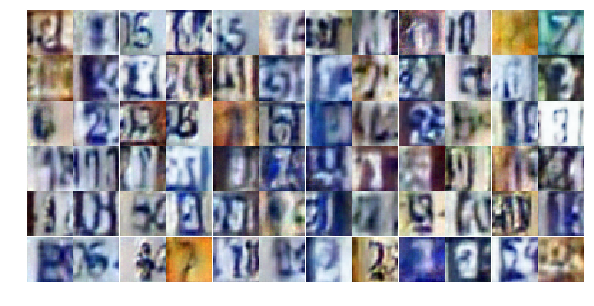

Epoch 10/25... Discriminator Loss: 0.4301... Generator Loss: 1.7349
Epoch 10/25... Discriminator Loss: 0.7909... Generator Loss: 0.9437
Epoch 10/25... Discriminator Loss: 0.4238... Generator Loss: 1.6010
Epoch 10/25... Discriminator Loss: 0.4764... Generator Loss: 1.8241
Epoch 10/25... Discriminator Loss: 1.4549... Generator Loss: 0.3725
Epoch 10/25... Discriminator Loss: 0.4582... Generator Loss: 1.2549
Epoch 10/25... Discriminator Loss: 0.3782... Generator Loss: 1.4617
Epoch 10/25... Discriminator Loss: 0.6553... Generator Loss: 0.9606
Epoch 10/25... Discriminator Loss: 0.3372... Generator Loss: 1.7084
Epoch 10/25... Discriminator Loss: 0.4016... Generator Loss: 1.9581


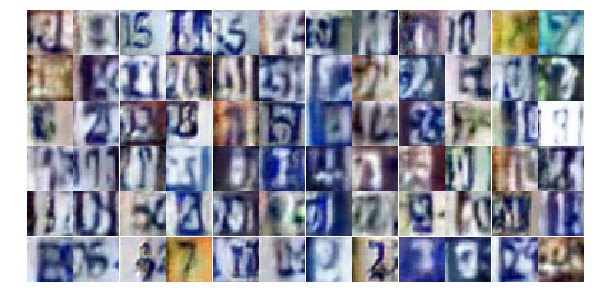

Epoch 10/25... Discriminator Loss: 0.3821... Generator Loss: 1.5960
Epoch 10/25... Discriminator Loss: 0.5196... Generator Loss: 2.5474
Epoch 10/25... Discriminator Loss: 1.3177... Generator Loss: 0.4386
Epoch 10/25... Discriminator Loss: 0.4747... Generator Loss: 1.4261
Epoch 10/25... Discriminator Loss: 0.4051... Generator Loss: 2.3542
Epoch 10/25... Discriminator Loss: 0.3359... Generator Loss: 2.1380
Epoch 10/25... Discriminator Loss: 0.3715... Generator Loss: 1.6943
Epoch 10/25... Discriminator Loss: 0.2824... Generator Loss: 3.3072
Epoch 10/25... Discriminator Loss: 0.3544... Generator Loss: 1.6210
Epoch 10/25... Discriminator Loss: 0.5254... Generator Loss: 1.6298


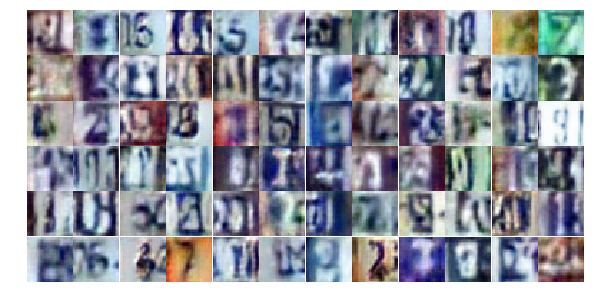

Epoch 10/25... Discriminator Loss: 1.0591... Generator Loss: 3.3123
Epoch 10/25... Discriminator Loss: 0.4794... Generator Loss: 3.3925
Epoch 10/25... Discriminator Loss: 0.3025... Generator Loss: 1.8009
Epoch 11/25... Discriminator Loss: 0.6682... Generator Loss: 3.6512
Epoch 11/25... Discriminator Loss: 0.3216... Generator Loss: 1.8138
Epoch 11/25... Discriminator Loss: 1.6229... Generator Loss: 0.3010
Epoch 11/25... Discriminator Loss: 0.9562... Generator Loss: 1.1307
Epoch 11/25... Discriminator Loss: 0.8745... Generator Loss: 0.8540
Epoch 11/25... Discriminator Loss: 1.4429... Generator Loss: 0.4628
Epoch 11/25... Discriminator Loss: 0.4713... Generator Loss: 1.4460


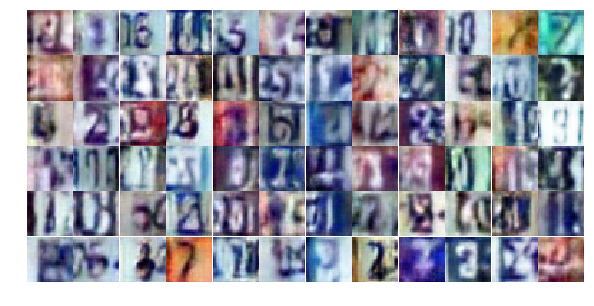

Epoch 11/25... Discriminator Loss: 0.3654... Generator Loss: 1.7572
Epoch 11/25... Discriminator Loss: 0.5052... Generator Loss: 1.4221
Epoch 11/25... Discriminator Loss: 0.5827... Generator Loss: 1.2028
Epoch 11/25... Discriminator Loss: 0.4348... Generator Loss: 1.3841
Epoch 11/25... Discriminator Loss: 0.6223... Generator Loss: 1.0539
Epoch 11/25... Discriminator Loss: 0.2980... Generator Loss: 2.1004
Epoch 11/25... Discriminator Loss: 0.5229... Generator Loss: 1.4676
Epoch 11/25... Discriminator Loss: 0.5901... Generator Loss: 2.6462
Epoch 11/25... Discriminator Loss: 0.6877... Generator Loss: 1.0020
Epoch 11/25... Discriminator Loss: 1.2175... Generator Loss: 0.4956


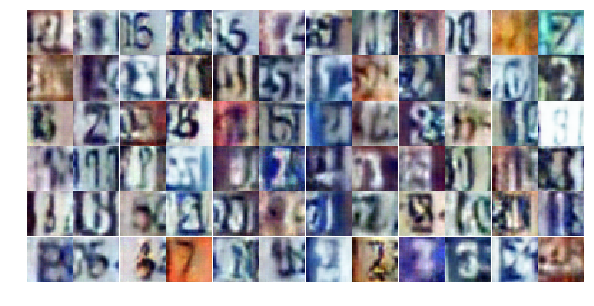

Epoch 11/25... Discriminator Loss: 0.3681... Generator Loss: 2.3643
Epoch 11/25... Discriminator Loss: 0.2136... Generator Loss: 2.8817
Epoch 11/25... Discriminator Loss: 0.6782... Generator Loss: 0.9472
Epoch 11/25... Discriminator Loss: 0.6382... Generator Loss: 0.9974
Epoch 11/25... Discriminator Loss: 0.2506... Generator Loss: 2.0664
Epoch 11/25... Discriminator Loss: 0.2561... Generator Loss: 1.9138
Epoch 11/25... Discriminator Loss: 0.2729... Generator Loss: 2.1327
Epoch 11/25... Discriminator Loss: 0.5739... Generator Loss: 1.1882
Epoch 11/25... Discriminator Loss: 0.1836... Generator Loss: 2.5825
Epoch 11/25... Discriminator Loss: 0.3154... Generator Loss: 1.7908


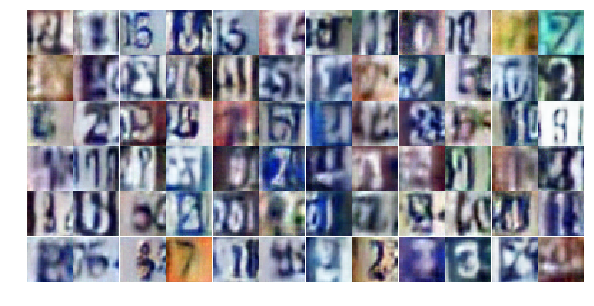

Epoch 11/25... Discriminator Loss: 2.0522... Generator Loss: 0.1980
Epoch 11/25... Discriminator Loss: 0.6997... Generator Loss: 1.5950
Epoch 11/25... Discriminator Loss: 0.5490... Generator Loss: 1.6539
Epoch 11/25... Discriminator Loss: 0.3291... Generator Loss: 3.1848
Epoch 11/25... Discriminator Loss: 0.3808... Generator Loss: 2.1849
Epoch 11/25... Discriminator Loss: 0.7207... Generator Loss: 0.8292
Epoch 11/25... Discriminator Loss: 0.6946... Generator Loss: 1.0708
Epoch 11/25... Discriminator Loss: 0.4000... Generator Loss: 2.2805
Epoch 11/25... Discriminator Loss: 0.2760... Generator Loss: 2.8334
Epoch 11/25... Discriminator Loss: 1.0969... Generator Loss: 0.5443


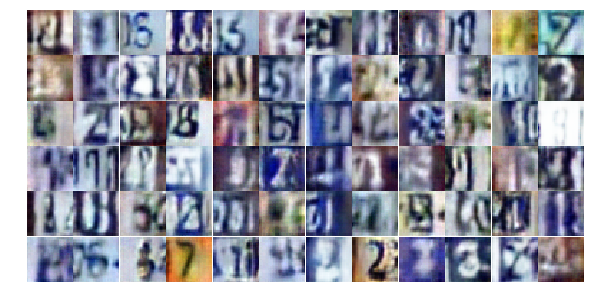

Epoch 11/25... Discriminator Loss: 0.2941... Generator Loss: 1.8823
Epoch 11/25... Discriminator Loss: 0.3814... Generator Loss: 1.6439
Epoch 11/25... Discriminator Loss: 0.3190... Generator Loss: 2.0930
Epoch 11/25... Discriminator Loss: 0.4649... Generator Loss: 1.3056
Epoch 11/25... Discriminator Loss: 0.4844... Generator Loss: 1.3720
Epoch 11/25... Discriminator Loss: 0.7677... Generator Loss: 0.8098
Epoch 11/25... Discriminator Loss: 0.1284... Generator Loss: 2.9748
Epoch 11/25... Discriminator Loss: 0.4268... Generator Loss: 2.8649
Epoch 11/25... Discriminator Loss: 1.4829... Generator Loss: 0.3553
Epoch 11/25... Discriminator Loss: 0.3033... Generator Loss: 3.7558


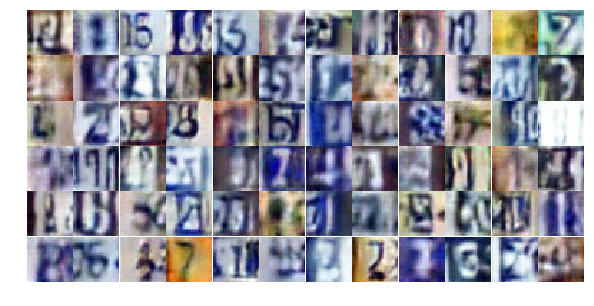

Epoch 11/25... Discriminator Loss: 0.5056... Generator Loss: 1.3327
Epoch 11/25... Discriminator Loss: 0.1792... Generator Loss: 3.1413
Epoch 11/25... Discriminator Loss: 0.4482... Generator Loss: 1.5784
Epoch 11/25... Discriminator Loss: 0.4642... Generator Loss: 1.3364
Epoch 11/25... Discriminator Loss: 0.5615... Generator Loss: 1.7493
Epoch 11/25... Discriminator Loss: 0.5954... Generator Loss: 1.8537
Epoch 11/25... Discriminator Loss: 1.3223... Generator Loss: 0.4386
Epoch 11/25... Discriminator Loss: 0.4366... Generator Loss: 1.6202
Epoch 11/25... Discriminator Loss: 0.7585... Generator Loss: 0.8887
Epoch 11/25... Discriminator Loss: 0.5432... Generator Loss: 1.3455


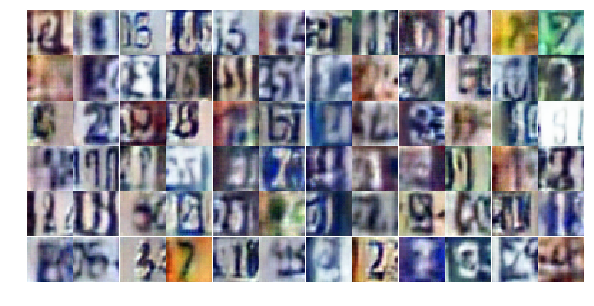

Epoch 12/25... Discriminator Loss: 0.2344... Generator Loss: 2.5204
Epoch 12/25... Discriminator Loss: 0.6491... Generator Loss: 1.0524
Epoch 12/25... Discriminator Loss: 1.2774... Generator Loss: 0.4689
Epoch 12/25... Discriminator Loss: 0.6919... Generator Loss: 1.2469
Epoch 12/25... Discriminator Loss: 0.2784... Generator Loss: 2.5191
Epoch 12/25... Discriminator Loss: 1.0921... Generator Loss: 0.5507
Epoch 12/25... Discriminator Loss: 0.1832... Generator Loss: 2.7135
Epoch 12/25... Discriminator Loss: 0.2937... Generator Loss: 3.4161
Epoch 12/25... Discriminator Loss: 0.3463... Generator Loss: 1.8387
Epoch 12/25... Discriminator Loss: 1.9323... Generator Loss: 0.2371


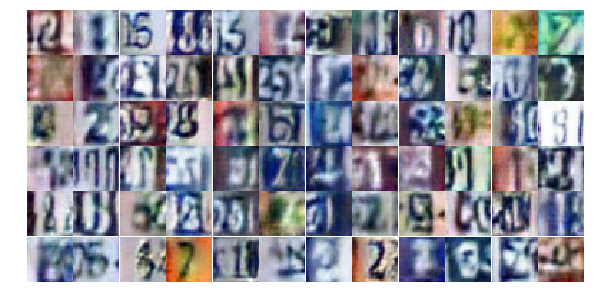

Epoch 12/25... Discriminator Loss: 0.4747... Generator Loss: 1.3392
Epoch 12/25... Discriminator Loss: 0.4383... Generator Loss: 1.5159
Epoch 12/25... Discriminator Loss: 0.5101... Generator Loss: 1.2304
Epoch 12/25... Discriminator Loss: 2.8676... Generator Loss: 5.2558
Epoch 12/25... Discriminator Loss: 0.3010... Generator Loss: 2.7108
Epoch 12/25... Discriminator Loss: 1.5553... Generator Loss: 0.3406
Epoch 12/25... Discriminator Loss: 0.5217... Generator Loss: 1.8505
Epoch 12/25... Discriminator Loss: 0.3757... Generator Loss: 1.5886
Epoch 12/25... Discriminator Loss: 0.3583... Generator Loss: 1.9135
Epoch 12/25... Discriminator Loss: 0.5191... Generator Loss: 1.2140


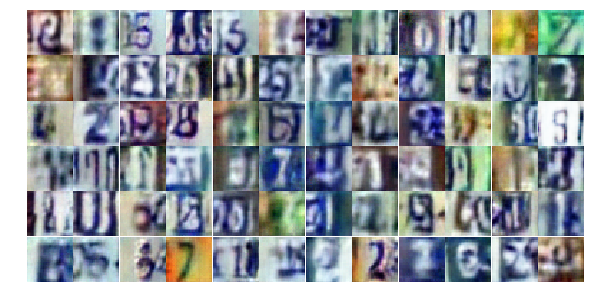

Epoch 12/25... Discriminator Loss: 0.2318... Generator Loss: 2.1380
Epoch 12/25... Discriminator Loss: 0.4474... Generator Loss: 1.3465
Epoch 12/25... Discriminator Loss: 0.4780... Generator Loss: 1.2540
Epoch 12/25... Discriminator Loss: 0.1725... Generator Loss: 3.1004
Epoch 12/25... Discriminator Loss: 0.1424... Generator Loss: 2.9250
Epoch 12/25... Discriminator Loss: 0.3313... Generator Loss: 1.6411
Epoch 12/25... Discriminator Loss: 0.9033... Generator Loss: 0.6931
Epoch 12/25... Discriminator Loss: 0.7153... Generator Loss: 2.7156
Epoch 12/25... Discriminator Loss: 1.2180... Generator Loss: 2.1530
Epoch 12/25... Discriminator Loss: 0.8335... Generator Loss: 0.9983


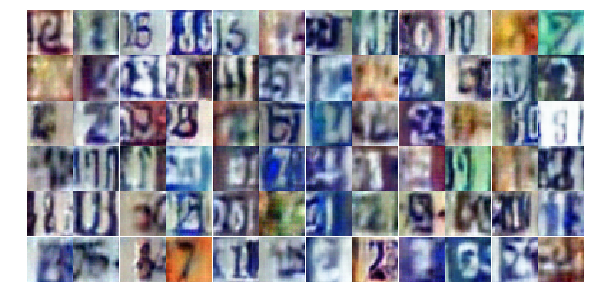

Epoch 12/25... Discriminator Loss: 0.9279... Generator Loss: 0.8014
Epoch 12/25... Discriminator Loss: 0.7103... Generator Loss: 1.1361
Epoch 12/25... Discriminator Loss: 0.8989... Generator Loss: 0.7363
Epoch 12/25... Discriminator Loss: 1.2837... Generator Loss: 0.4399
Epoch 12/25... Discriminator Loss: 0.3494... Generator Loss: 2.6556
Epoch 12/25... Discriminator Loss: 0.6039... Generator Loss: 1.1382
Epoch 12/25... Discriminator Loss: 0.4373... Generator Loss: 1.4278
Epoch 12/25... Discriminator Loss: 1.0216... Generator Loss: 0.6183
Epoch 12/25... Discriminator Loss: 0.4203... Generator Loss: 1.6416
Epoch 12/25... Discriminator Loss: 0.3237... Generator Loss: 1.6105


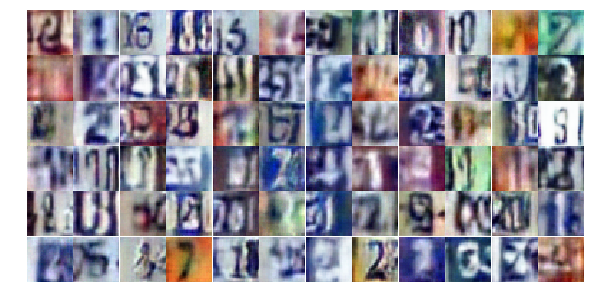

Epoch 12/25... Discriminator Loss: 0.6427... Generator Loss: 1.0079
Epoch 12/25... Discriminator Loss: 0.3245... Generator Loss: 2.0376
Epoch 12/25... Discriminator Loss: 0.4920... Generator Loss: 1.2958
Epoch 12/25... Discriminator Loss: 0.3721... Generator Loss: 1.9533
Epoch 12/25... Discriminator Loss: 0.8781... Generator Loss: 0.7790
Epoch 12/25... Discriminator Loss: 1.3465... Generator Loss: 0.4633
Epoch 12/25... Discriminator Loss: 0.4875... Generator Loss: 1.4035
Epoch 12/25... Discriminator Loss: 0.7206... Generator Loss: 0.9360
Epoch 12/25... Discriminator Loss: 0.5261... Generator Loss: 1.1990
Epoch 12/25... Discriminator Loss: 0.5965... Generator Loss: 1.0943


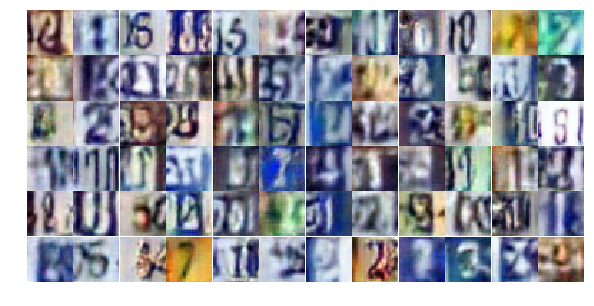

Epoch 12/25... Discriminator Loss: 0.7247... Generator Loss: 0.9265
Epoch 12/25... Discriminator Loss: 0.1705... Generator Loss: 3.3805
Epoch 12/25... Discriminator Loss: 0.3844... Generator Loss: 1.7193
Epoch 12/25... Discriminator Loss: 1.4204... Generator Loss: 0.3672
Epoch 12/25... Discriminator Loss: 0.2747... Generator Loss: 2.0065
Epoch 12/25... Discriminator Loss: 0.5449... Generator Loss: 2.1627
Epoch 12/25... Discriminator Loss: 1.3195... Generator Loss: 0.4523
Epoch 13/25... Discriminator Loss: 0.4518... Generator Loss: 1.4361
Epoch 13/25... Discriminator Loss: 0.5136... Generator Loss: 1.3781
Epoch 13/25... Discriminator Loss: 0.6638... Generator Loss: 0.9960


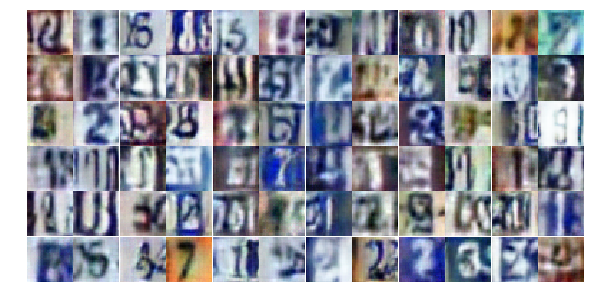

Epoch 13/25... Discriminator Loss: 0.5447... Generator Loss: 2.7125
Epoch 13/25... Discriminator Loss: 0.4893... Generator Loss: 1.3502
Epoch 13/25... Discriminator Loss: 0.5151... Generator Loss: 1.9188
Epoch 13/25... Discriminator Loss: 2.0772... Generator Loss: 0.2109
Epoch 13/25... Discriminator Loss: 1.8499... Generator Loss: 0.7005
Epoch 13/25... Discriminator Loss: 0.8942... Generator Loss: 0.7714
Epoch 13/25... Discriminator Loss: 0.4156... Generator Loss: 1.8811
Epoch 13/25... Discriminator Loss: 0.4702... Generator Loss: 1.2924
Epoch 13/25... Discriminator Loss: 0.5719... Generator Loss: 1.1582
Epoch 13/25... Discriminator Loss: 0.4424... Generator Loss: 1.4962


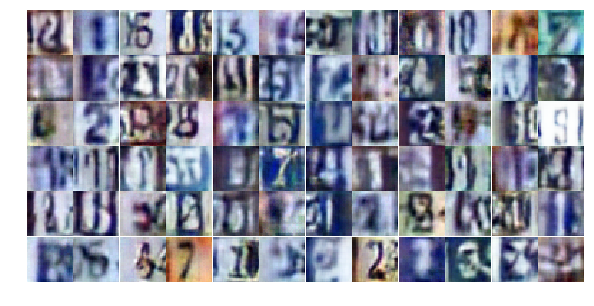

Epoch 13/25... Discriminator Loss: 0.4730... Generator Loss: 1.2491
Epoch 13/25... Discriminator Loss: 0.5488... Generator Loss: 1.0789
Epoch 13/25... Discriminator Loss: 1.3972... Generator Loss: 0.3747
Epoch 13/25... Discriminator Loss: 0.2677... Generator Loss: 1.9626
Epoch 13/25... Discriminator Loss: 0.7987... Generator Loss: 0.8057
Epoch 13/25... Discriminator Loss: 0.4113... Generator Loss: 2.4052
Epoch 13/25... Discriminator Loss: 0.5022... Generator Loss: 1.4105
Epoch 13/25... Discriminator Loss: 1.1483... Generator Loss: 0.5652
Epoch 13/25... Discriminator Loss: 0.4959... Generator Loss: 1.3389
Epoch 13/25... Discriminator Loss: 1.0512... Generator Loss: 0.5873


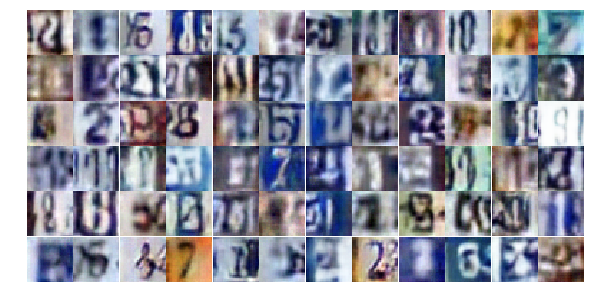

Epoch 13/25... Discriminator Loss: 0.8141... Generator Loss: 0.7586
Epoch 13/25... Discriminator Loss: 0.8461... Generator Loss: 0.8041
Epoch 13/25... Discriminator Loss: 0.5232... Generator Loss: 2.4736
Epoch 13/25... Discriminator Loss: 0.4426... Generator Loss: 1.5581
Epoch 13/25... Discriminator Loss: 0.5520... Generator Loss: 1.4312
Epoch 13/25... Discriminator Loss: 0.9062... Generator Loss: 0.7338
Epoch 13/25... Discriminator Loss: 0.7727... Generator Loss: 2.6651
Epoch 13/25... Discriminator Loss: 0.2483... Generator Loss: 2.2570
Epoch 13/25... Discriminator Loss: 0.5315... Generator Loss: 1.3125
Epoch 13/25... Discriminator Loss: 0.4558... Generator Loss: 1.5970


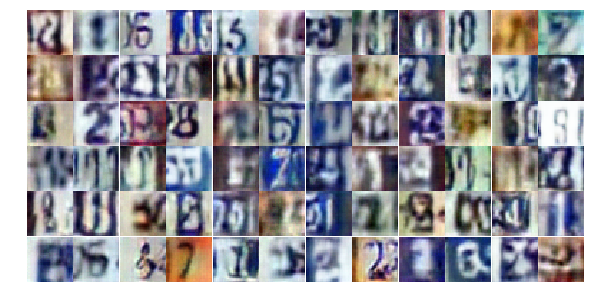

Epoch 13/25... Discriminator Loss: 0.9233... Generator Loss: 0.6745
Epoch 13/25... Discriminator Loss: 0.8498... Generator Loss: 1.6105
Epoch 13/25... Discriminator Loss: 1.3432... Generator Loss: 3.0187
Epoch 13/25... Discriminator Loss: 0.7944... Generator Loss: 0.9161
Epoch 13/25... Discriminator Loss: 0.4355... Generator Loss: 1.5418
Epoch 13/25... Discriminator Loss: 0.1959... Generator Loss: 3.9205
Epoch 13/25... Discriminator Loss: 0.4322... Generator Loss: 1.4170
Epoch 13/25... Discriminator Loss: 0.7702... Generator Loss: 0.9583
Epoch 13/25... Discriminator Loss: 0.3933... Generator Loss: 1.5736
Epoch 13/25... Discriminator Loss: 0.5856... Generator Loss: 1.0891


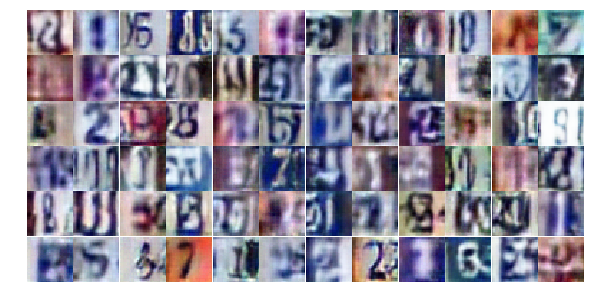

Epoch 13/25... Discriminator Loss: 0.4201... Generator Loss: 1.3998
Epoch 13/25... Discriminator Loss: 0.5155... Generator Loss: 1.2389
Epoch 13/25... Discriminator Loss: 0.6647... Generator Loss: 1.0226
Epoch 13/25... Discriminator Loss: 0.3651... Generator Loss: 1.8235
Epoch 13/25... Discriminator Loss: 1.4495... Generator Loss: 0.4034
Epoch 13/25... Discriminator Loss: 0.6160... Generator Loss: 4.8778
Epoch 13/25... Discriminator Loss: 0.9816... Generator Loss: 0.6228
Epoch 13/25... Discriminator Loss: 0.2709... Generator Loss: 2.0235
Epoch 13/25... Discriminator Loss: 0.4936... Generator Loss: 1.2637
Epoch 13/25... Discriminator Loss: 2.3921... Generator Loss: 0.1685


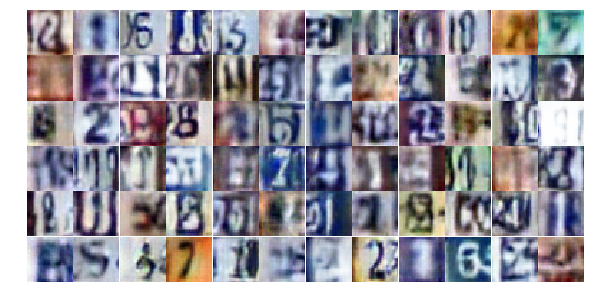

Epoch 13/25... Discriminator Loss: 0.3572... Generator Loss: 2.5205
Epoch 13/25... Discriminator Loss: 1.0273... Generator Loss: 0.6146
Epoch 13/25... Discriminator Loss: 0.4715... Generator Loss: 1.8858
Epoch 13/25... Discriminator Loss: 0.5832... Generator Loss: 1.1824
Epoch 14/25... Discriminator Loss: 0.3849... Generator Loss: 1.6620
Epoch 14/25... Discriminator Loss: 0.6893... Generator Loss: 1.0202
Epoch 14/25... Discriminator Loss: 0.7080... Generator Loss: 1.0857
Epoch 14/25... Discriminator Loss: 0.5900... Generator Loss: 1.3633
Epoch 14/25... Discriminator Loss: 0.5385... Generator Loss: 1.8026
Epoch 14/25... Discriminator Loss: 0.7424... Generator Loss: 0.9875


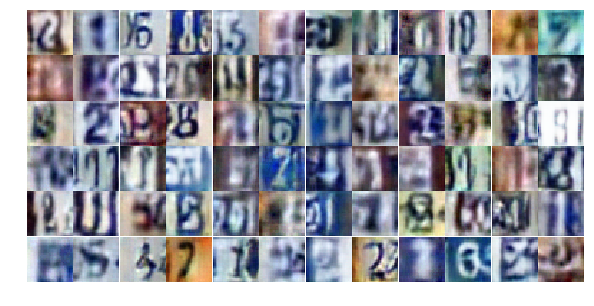

Epoch 14/25... Discriminator Loss: 0.6379... Generator Loss: 3.2982
Epoch 14/25... Discriminator Loss: 0.5841... Generator Loss: 1.0461
Epoch 14/25... Discriminator Loss: 0.8676... Generator Loss: 0.7752
Epoch 14/25... Discriminator Loss: 0.7556... Generator Loss: 1.0161
Epoch 14/25... Discriminator Loss: 0.8878... Generator Loss: 0.7632
Epoch 14/25... Discriminator Loss: 0.4271... Generator Loss: 1.3488
Epoch 14/25... Discriminator Loss: 0.3287... Generator Loss: 1.7666
Epoch 14/25... Discriminator Loss: 0.8345... Generator Loss: 0.8234
Epoch 14/25... Discriminator Loss: 0.9429... Generator Loss: 0.6581
Epoch 14/25... Discriminator Loss: 1.0652... Generator Loss: 0.5960


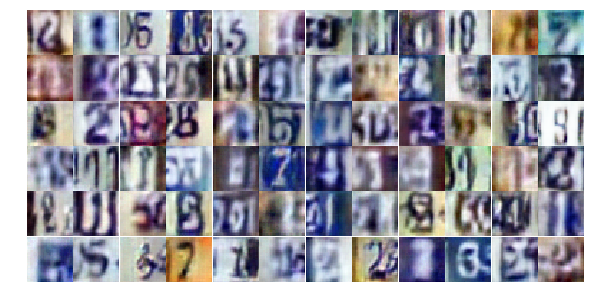

Epoch 14/25... Discriminator Loss: 0.3553... Generator Loss: 1.4872
Epoch 14/25... Discriminator Loss: 0.4731... Generator Loss: 1.9857
Epoch 14/25... Discriminator Loss: 0.3901... Generator Loss: 1.9050
Epoch 14/25... Discriminator Loss: 0.4861... Generator Loss: 1.4010
Epoch 14/25... Discriminator Loss: 0.4614... Generator Loss: 1.4625
Epoch 14/25... Discriminator Loss: 0.6719... Generator Loss: 1.0023
Epoch 14/25... Discriminator Loss: 0.7022... Generator Loss: 0.9590
Epoch 14/25... Discriminator Loss: 0.7300... Generator Loss: 0.9220
Epoch 14/25... Discriminator Loss: 0.3127... Generator Loss: 1.9940
Epoch 14/25... Discriminator Loss: 1.2033... Generator Loss: 3.7191


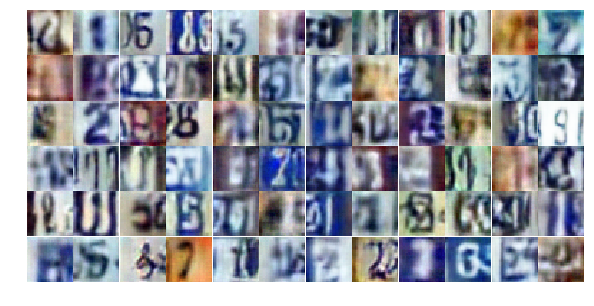

Epoch 14/25... Discriminator Loss: 1.3262... Generator Loss: 0.6072
Epoch 14/25... Discriminator Loss: 0.2316... Generator Loss: 2.0552
Epoch 14/25... Discriminator Loss: 0.5067... Generator Loss: 1.3527
Epoch 14/25... Discriminator Loss: 0.3273... Generator Loss: 1.6638
Epoch 14/25... Discriminator Loss: 0.4213... Generator Loss: 1.5178
Epoch 14/25... Discriminator Loss: 0.4252... Generator Loss: 1.4869
Epoch 14/25... Discriminator Loss: 0.8157... Generator Loss: 0.8053
Epoch 14/25... Discriminator Loss: 0.2610... Generator Loss: 2.2337
Epoch 14/25... Discriminator Loss: 0.7648... Generator Loss: 3.1457
Epoch 14/25... Discriminator Loss: 0.5521... Generator Loss: 1.5349


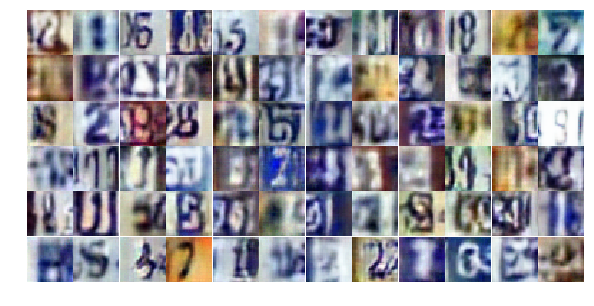

Epoch 14/25... Discriminator Loss: 1.6726... Generator Loss: 0.2934
Epoch 14/25... Discriminator Loss: 0.6274... Generator Loss: 1.1519
Epoch 14/25... Discriminator Loss: 0.6189... Generator Loss: 1.1432
Epoch 14/25... Discriminator Loss: 0.9600... Generator Loss: 0.6936
Epoch 14/25... Discriminator Loss: 0.8721... Generator Loss: 0.7230
Epoch 14/25... Discriminator Loss: 0.7435... Generator Loss: 0.9330
Epoch 14/25... Discriminator Loss: 0.6037... Generator Loss: 1.0520
Epoch 14/25... Discriminator Loss: 0.3738... Generator Loss: 1.8154
Epoch 14/25... Discriminator Loss: 1.0021... Generator Loss: 0.6188
Epoch 14/25... Discriminator Loss: 1.4244... Generator Loss: 0.3816


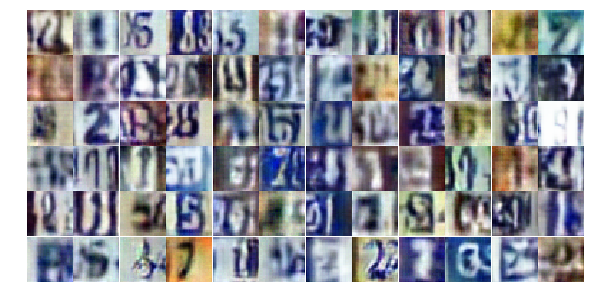

Epoch 14/25... Discriminator Loss: 0.6404... Generator Loss: 1.0990
Epoch 14/25... Discriminator Loss: 0.9330... Generator Loss: 0.7205
Epoch 14/25... Discriminator Loss: 0.4235... Generator Loss: 1.4276
Epoch 14/25... Discriminator Loss: 0.6641... Generator Loss: 1.0547
Epoch 14/25... Discriminator Loss: 0.4225... Generator Loss: 1.3450
Epoch 14/25... Discriminator Loss: 0.5418... Generator Loss: 1.2061
Epoch 14/25... Discriminator Loss: 0.6070... Generator Loss: 2.1599
Epoch 14/25... Discriminator Loss: 0.4765... Generator Loss: 1.3328
Epoch 14/25... Discriminator Loss: 0.8063... Generator Loss: 0.8067
Epoch 14/25... Discriminator Loss: 0.3864... Generator Loss: 1.7335


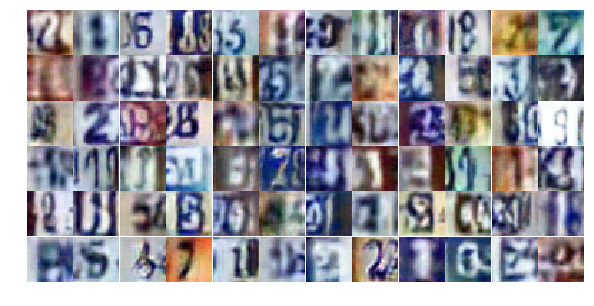

Epoch 14/25... Discriminator Loss: 0.3925... Generator Loss: 1.8979
Epoch 14/25... Discriminator Loss: 0.6258... Generator Loss: 1.0430
Epoch 15/25... Discriminator Loss: 0.4279... Generator Loss: 1.3620
Epoch 15/25... Discriminator Loss: 0.3887... Generator Loss: 1.6839
Epoch 15/25... Discriminator Loss: 0.4418... Generator Loss: 2.1844
Epoch 15/25... Discriminator Loss: 0.7213... Generator Loss: 0.9885
Epoch 15/25... Discriminator Loss: 0.5693... Generator Loss: 1.2414
Epoch 15/25... Discriminator Loss: 0.4569... Generator Loss: 1.2870
Epoch 15/25... Discriminator Loss: 1.3313... Generator Loss: 0.4615
Epoch 15/25... Discriminator Loss: 0.3784... Generator Loss: 1.5788


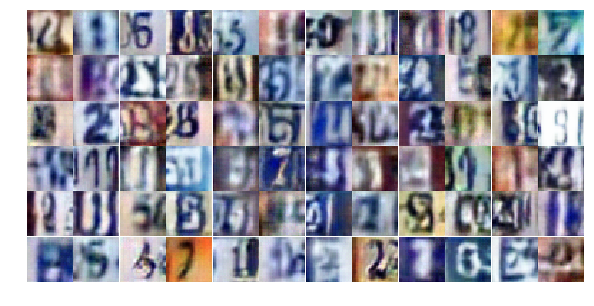

Epoch 15/25... Discriminator Loss: 0.5939... Generator Loss: 1.0956
Epoch 15/25... Discriminator Loss: 0.6412... Generator Loss: 1.0601
Epoch 15/25... Discriminator Loss: 0.6054... Generator Loss: 1.1165
Epoch 15/25... Discriminator Loss: 0.6511... Generator Loss: 1.1740
Epoch 15/25... Discriminator Loss: 0.8677... Generator Loss: 0.7541
Epoch 15/25... Discriminator Loss: 0.6865... Generator Loss: 1.1549
Epoch 15/25... Discriminator Loss: 1.9983... Generator Loss: 0.2074
Epoch 15/25... Discriminator Loss: 1.0783... Generator Loss: 1.9158
Epoch 15/25... Discriminator Loss: 1.6212... Generator Loss: 4.4475
Epoch 15/25... Discriminator Loss: 1.2982... Generator Loss: 0.4673


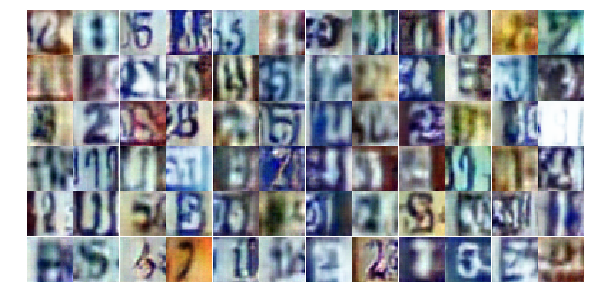

Epoch 15/25... Discriminator Loss: 0.8575... Generator Loss: 0.8453
Epoch 15/25... Discriminator Loss: 0.5540... Generator Loss: 1.2913
Epoch 15/25... Discriminator Loss: 0.5693... Generator Loss: 1.3120
Epoch 15/25... Discriminator Loss: 0.5984... Generator Loss: 1.4703
Epoch 15/25... Discriminator Loss: 0.8079... Generator Loss: 0.8458
Epoch 15/25... Discriminator Loss: 0.5678... Generator Loss: 1.4885
Epoch 15/25... Discriminator Loss: 1.0244... Generator Loss: 0.6808
Epoch 15/25... Discriminator Loss: 0.8211... Generator Loss: 0.7851
Epoch 15/25... Discriminator Loss: 0.5868... Generator Loss: 1.1558
Epoch 15/25... Discriminator Loss: 1.2532... Generator Loss: 0.4725


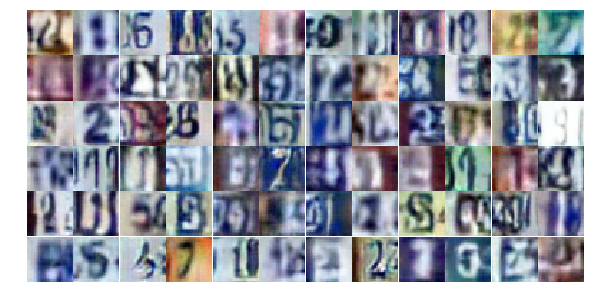

Epoch 15/25... Discriminator Loss: 0.4576... Generator Loss: 1.5198
Epoch 15/25... Discriminator Loss: 0.6163... Generator Loss: 1.1838
Epoch 15/25... Discriminator Loss: 0.4161... Generator Loss: 1.4939
Epoch 15/25... Discriminator Loss: 0.7310... Generator Loss: 0.9342
Epoch 15/25... Discriminator Loss: 0.5467... Generator Loss: 1.2923
Epoch 15/25... Discriminator Loss: 1.3873... Generator Loss: 3.6727
Epoch 15/25... Discriminator Loss: 0.5817... Generator Loss: 1.2629
Epoch 15/25... Discriminator Loss: 0.8950... Generator Loss: 0.7199
Epoch 15/25... Discriminator Loss: 0.3607... Generator Loss: 1.6176
Epoch 15/25... Discriminator Loss: 0.7819... Generator Loss: 0.8545


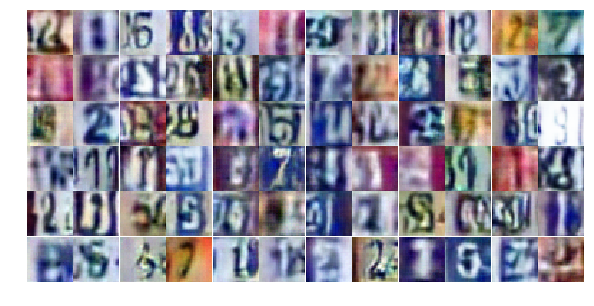

Epoch 15/25... Discriminator Loss: 0.5067... Generator Loss: 1.2159
Epoch 15/25... Discriminator Loss: 1.1428... Generator Loss: 0.5096
Epoch 15/25... Discriminator Loss: 0.8737... Generator Loss: 0.7695
Epoch 15/25... Discriminator Loss: 0.3991... Generator Loss: 1.5979
Epoch 15/25... Discriminator Loss: 0.5001... Generator Loss: 1.2258
Epoch 15/25... Discriminator Loss: 1.3909... Generator Loss: 0.4841
Epoch 15/25... Discriminator Loss: 0.5131... Generator Loss: 1.2213
Epoch 15/25... Discriminator Loss: 0.4296... Generator Loss: 2.2265
Epoch 15/25... Discriminator Loss: 0.9590... Generator Loss: 3.0700
Epoch 15/25... Discriminator Loss: 0.6360... Generator Loss: 1.1333


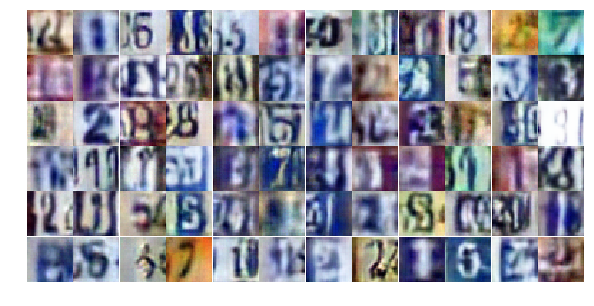

Epoch 15/25... Discriminator Loss: 0.6622... Generator Loss: 0.9847
Epoch 15/25... Discriminator Loss: 0.8494... Generator Loss: 0.7968
Epoch 15/25... Discriminator Loss: 0.2706... Generator Loss: 1.8418
Epoch 15/25... Discriminator Loss: 0.8997... Generator Loss: 0.6867
Epoch 15/25... Discriminator Loss: 0.1613... Generator Loss: 2.6051
Epoch 15/25... Discriminator Loss: 0.6121... Generator Loss: 1.2140
Epoch 15/25... Discriminator Loss: 0.6694... Generator Loss: 0.9853
Epoch 15/25... Discriminator Loss: 0.4454... Generator Loss: 1.4411
Epoch 15/25... Discriminator Loss: 1.2263... Generator Loss: 0.5171
Epoch 16/25... Discriminator Loss: 0.5180... Generator Loss: 1.1936


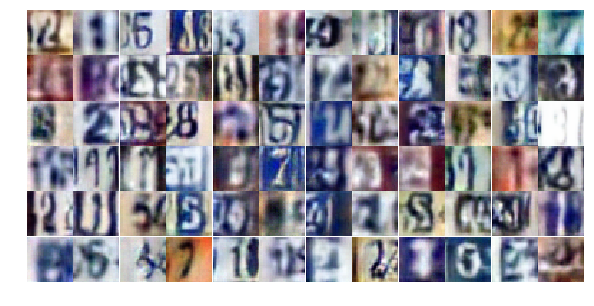

Epoch 16/25... Discriminator Loss: 0.3731... Generator Loss: 1.8653
Epoch 16/25... Discriminator Loss: 0.5704... Generator Loss: 1.0467
Epoch 16/25... Discriminator Loss: 1.2124... Generator Loss: 0.4773
Epoch 16/25... Discriminator Loss: 0.3195... Generator Loss: 1.9322
Epoch 16/25... Discriminator Loss: 0.4519... Generator Loss: 1.5071
Epoch 16/25... Discriminator Loss: 0.4276... Generator Loss: 2.6354
Epoch 16/25... Discriminator Loss: 1.2532... Generator Loss: 0.5702
Epoch 16/25... Discriminator Loss: 1.0377... Generator Loss: 0.6691
Epoch 16/25... Discriminator Loss: 0.8418... Generator Loss: 0.8133
Epoch 16/25... Discriminator Loss: 0.6379... Generator Loss: 1.0217


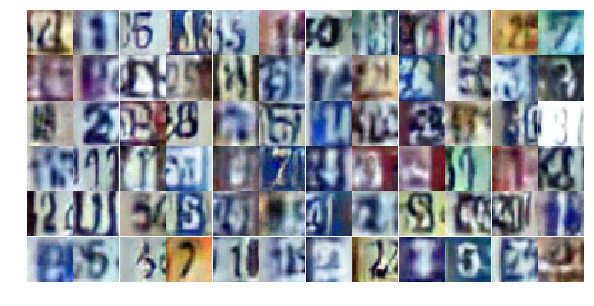

Epoch 16/25... Discriminator Loss: 1.3427... Generator Loss: 0.4134
Epoch 16/25... Discriminator Loss: 0.4009... Generator Loss: 1.5178
Epoch 16/25... Discriminator Loss: 0.2496... Generator Loss: 2.5802
Epoch 16/25... Discriminator Loss: 0.7695... Generator Loss: 0.8543
Epoch 16/25... Discriminator Loss: 0.3464... Generator Loss: 2.7811
Epoch 16/25... Discriminator Loss: 0.6053... Generator Loss: 1.1326
Epoch 16/25... Discriminator Loss: 1.5386... Generator Loss: 0.5877
Epoch 16/25... Discriminator Loss: 0.4360... Generator Loss: 1.5518
Epoch 16/25... Discriminator Loss: 0.4870... Generator Loss: 1.9583
Epoch 16/25... Discriminator Loss: 0.3360... Generator Loss: 1.7194


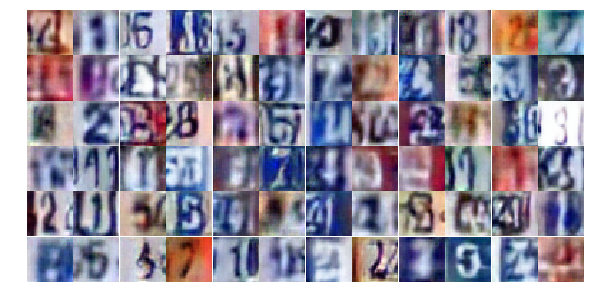

Epoch 16/25... Discriminator Loss: 0.4435... Generator Loss: 1.6061
Epoch 16/25... Discriminator Loss: 0.7693... Generator Loss: 1.2557
Epoch 16/25... Discriminator Loss: 1.1074... Generator Loss: 0.5625
Epoch 16/25... Discriminator Loss: 0.8842... Generator Loss: 0.7455
Epoch 16/25... Discriminator Loss: 0.5637... Generator Loss: 1.3230
Epoch 16/25... Discriminator Loss: 1.5503... Generator Loss: 0.3427
Epoch 16/25... Discriminator Loss: 0.6373... Generator Loss: 1.3157
Epoch 16/25... Discriminator Loss: 0.5685... Generator Loss: 1.2520
Epoch 16/25... Discriminator Loss: 0.9420... Generator Loss: 3.6633
Epoch 16/25... Discriminator Loss: 0.9766... Generator Loss: 0.6875


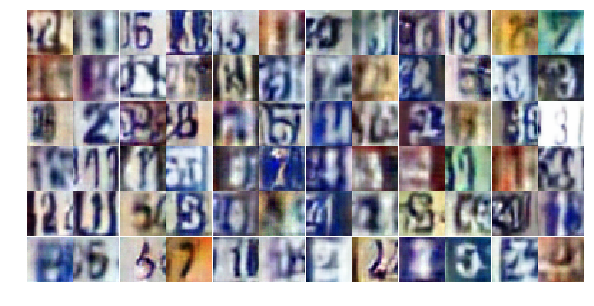

Epoch 16/25... Discriminator Loss: 0.7815... Generator Loss: 0.9270
Epoch 16/25... Discriminator Loss: 0.4721... Generator Loss: 1.3126
Epoch 16/25... Discriminator Loss: 0.4242... Generator Loss: 1.5715
Epoch 16/25... Discriminator Loss: 0.7721... Generator Loss: 0.9089
Epoch 16/25... Discriminator Loss: 0.8817... Generator Loss: 0.7243
Epoch 16/25... Discriminator Loss: 0.8659... Generator Loss: 0.7892
Epoch 16/25... Discriminator Loss: 0.9802... Generator Loss: 0.6704
Epoch 16/25... Discriminator Loss: 0.6360... Generator Loss: 1.0402
Epoch 16/25... Discriminator Loss: 0.7444... Generator Loss: 0.8957
Epoch 16/25... Discriminator Loss: 0.4405... Generator Loss: 1.3296


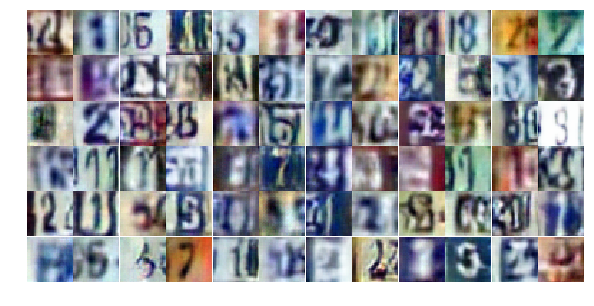

Epoch 16/25... Discriminator Loss: 0.4135... Generator Loss: 1.6342
Epoch 16/25... Discriminator Loss: 0.4427... Generator Loss: 1.3671
Epoch 16/25... Discriminator Loss: 1.0835... Generator Loss: 0.5729
Epoch 16/25... Discriminator Loss: 1.8131... Generator Loss: 4.5332
Epoch 16/25... Discriminator Loss: 1.5515... Generator Loss: 0.3274
Epoch 16/25... Discriminator Loss: 0.6882... Generator Loss: 1.9922
Epoch 16/25... Discriminator Loss: 0.5655... Generator Loss: 1.1987
Epoch 16/25... Discriminator Loss: 0.6271... Generator Loss: 1.2620
Epoch 16/25... Discriminator Loss: 0.4978... Generator Loss: 1.3453
Epoch 16/25... Discriminator Loss: 0.7492... Generator Loss: 0.9460


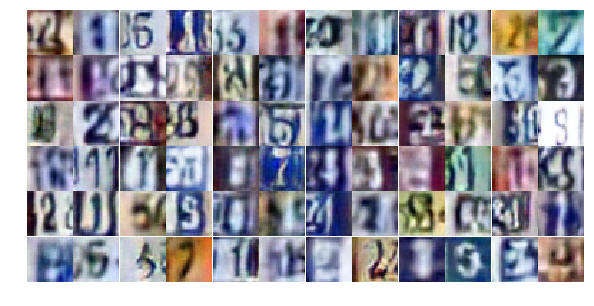

Epoch 16/25... Discriminator Loss: 1.1464... Generator Loss: 0.5158
Epoch 16/25... Discriminator Loss: 0.4779... Generator Loss: 1.4687
Epoch 16/25... Discriminator Loss: 1.5322... Generator Loss: 0.3380
Epoch 16/25... Discriminator Loss: 0.4844... Generator Loss: 1.3676
Epoch 16/25... Discriminator Loss: 0.6638... Generator Loss: 0.9830
Epoch 16/25... Discriminator Loss: 0.5928... Generator Loss: 1.1954
Epoch 17/25... Discriminator Loss: 0.5968... Generator Loss: 1.1053
Epoch 17/25... Discriminator Loss: 0.6332... Generator Loss: 1.1648
Epoch 17/25... Discriminator Loss: 0.6325... Generator Loss: 1.1703
Epoch 17/25... Discriminator Loss: 0.8456... Generator Loss: 0.8027


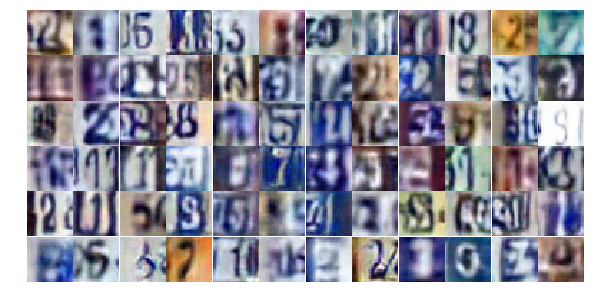

Epoch 17/25... Discriminator Loss: 0.4262... Generator Loss: 1.5517
Epoch 17/25... Discriminator Loss: 0.2846... Generator Loss: 1.8983
Epoch 17/25... Discriminator Loss: 0.6859... Generator Loss: 1.0355
Epoch 17/25... Discriminator Loss: 0.4480... Generator Loss: 1.9078
Epoch 17/25... Discriminator Loss: 1.2583... Generator Loss: 0.5318
Epoch 17/25... Discriminator Loss: 1.4077... Generator Loss: 0.3970
Epoch 17/25... Discriminator Loss: 0.6091... Generator Loss: 1.1883
Epoch 17/25... Discriminator Loss: 0.6251... Generator Loss: 1.0168
Epoch 17/25... Discriminator Loss: 0.3906... Generator Loss: 1.4610
Epoch 17/25... Discriminator Loss: 0.4628... Generator Loss: 1.6282


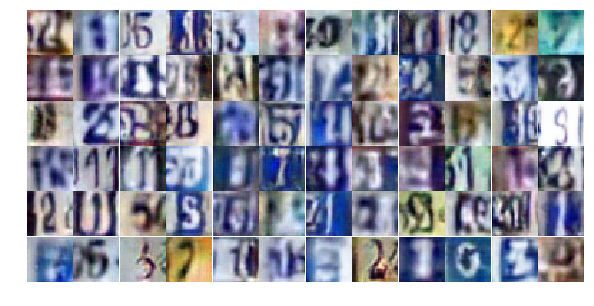

Epoch 17/25... Discriminator Loss: 0.6867... Generator Loss: 1.3436
Epoch 17/25... Discriminator Loss: 0.4986... Generator Loss: 2.0025
Epoch 17/25... Discriminator Loss: 0.6670... Generator Loss: 0.9419
Epoch 17/25... Discriminator Loss: 1.2968... Generator Loss: 0.4791
Epoch 17/25... Discriminator Loss: 0.4711... Generator Loss: 2.0972
Epoch 17/25... Discriminator Loss: 0.8769... Generator Loss: 0.7656
Epoch 17/25... Discriminator Loss: 0.6103... Generator Loss: 1.2385
Epoch 17/25... Discriminator Loss: 0.4562... Generator Loss: 1.7035
Epoch 17/25... Discriminator Loss: 0.5394... Generator Loss: 1.2001
Epoch 17/25... Discriminator Loss: 0.5949... Generator Loss: 1.1106


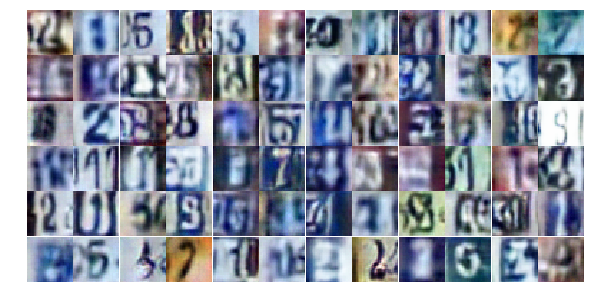

Epoch 17/25... Discriminator Loss: 1.9561... Generator Loss: 0.2155
Epoch 17/25... Discriminator Loss: 0.3404... Generator Loss: 1.8555
Epoch 17/25... Discriminator Loss: 0.3714... Generator Loss: 1.9976
Epoch 17/25... Discriminator Loss: 1.0041... Generator Loss: 0.6453
Epoch 17/25... Discriminator Loss: 1.3608... Generator Loss: 0.4137
Epoch 17/25... Discriminator Loss: 0.3735... Generator Loss: 1.9887
Epoch 17/25... Discriminator Loss: 0.5338... Generator Loss: 1.2145
Epoch 17/25... Discriminator Loss: 0.6497... Generator Loss: 1.0379
Epoch 17/25... Discriminator Loss: 0.9167... Generator Loss: 0.8526
Epoch 17/25... Discriminator Loss: 0.3444... Generator Loss: 1.7202


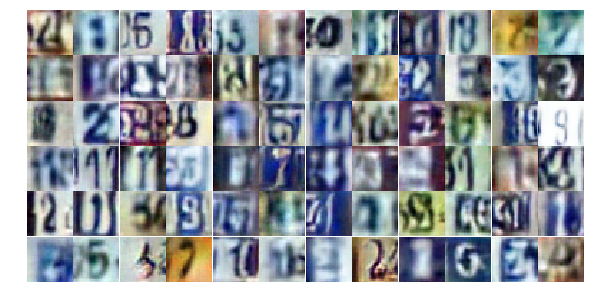

Epoch 17/25... Discriminator Loss: 0.9116... Generator Loss: 0.7542
Epoch 17/25... Discriminator Loss: 1.8701... Generator Loss: 0.2548
Epoch 17/25... Discriminator Loss: 0.5121... Generator Loss: 1.3267
Epoch 17/25... Discriminator Loss: 0.8724... Generator Loss: 0.7242
Epoch 17/25... Discriminator Loss: 0.5669... Generator Loss: 1.5060
Epoch 17/25... Discriminator Loss: 0.6239... Generator Loss: 1.0676
Epoch 17/25... Discriminator Loss: 0.7263... Generator Loss: 0.9348
Epoch 17/25... Discriminator Loss: 0.4075... Generator Loss: 2.4724
Epoch 17/25... Discriminator Loss: 0.3560... Generator Loss: 1.7895
Epoch 17/25... Discriminator Loss: 0.7966... Generator Loss: 0.8282


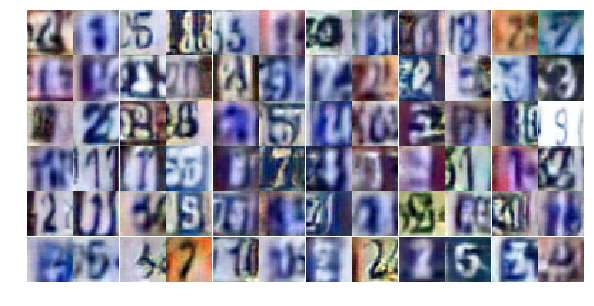

Epoch 17/25... Discriminator Loss: 1.6228... Generator Loss: 3.5284
Epoch 17/25... Discriminator Loss: 0.5365... Generator Loss: 3.3204
Epoch 17/25... Discriminator Loss: 1.6565... Generator Loss: 0.3706
Epoch 17/25... Discriminator Loss: 0.3041... Generator Loss: 2.2738
Epoch 17/25... Discriminator Loss: 0.4928... Generator Loss: 1.3961
Epoch 17/25... Discriminator Loss: 0.7101... Generator Loss: 0.9554
Epoch 17/25... Discriminator Loss: 1.0671... Generator Loss: 0.5913
Epoch 17/25... Discriminator Loss: 0.5102... Generator Loss: 1.3430
Epoch 17/25... Discriminator Loss: 0.4717... Generator Loss: 1.3840
Epoch 17/25... Discriminator Loss: 1.2557... Generator Loss: 0.5103


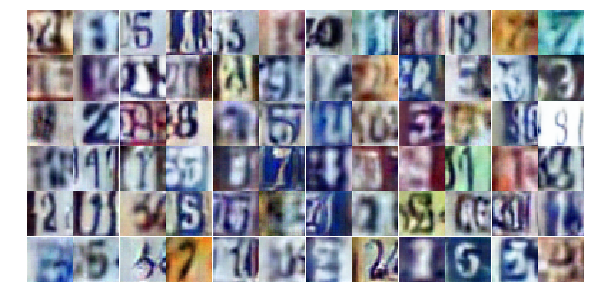

Epoch 17/25... Discriminator Loss: 0.6844... Generator Loss: 1.1534
Epoch 17/25... Discriminator Loss: 0.7027... Generator Loss: 1.0914
Epoch 17/25... Discriminator Loss: 0.5815... Generator Loss: 1.1603
Epoch 17/25... Discriminator Loss: 0.3206... Generator Loss: 1.9358
Epoch 18/25... Discriminator Loss: 0.5179... Generator Loss: 1.2421
Epoch 18/25... Discriminator Loss: 0.4275... Generator Loss: 1.5949
Epoch 18/25... Discriminator Loss: 0.4606... Generator Loss: 1.4868
Epoch 18/25... Discriminator Loss: 0.7913... Generator Loss: 0.8306
Epoch 18/25... Discriminator Loss: 0.8558... Generator Loss: 0.7394
Epoch 18/25... Discriminator Loss: 0.4215... Generator Loss: 1.6049


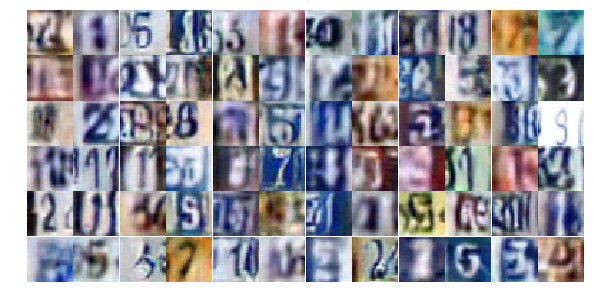

Epoch 18/25... Discriminator Loss: 0.6524... Generator Loss: 3.2003
Epoch 18/25... Discriminator Loss: 1.2834... Generator Loss: 0.6039
Epoch 18/25... Discriminator Loss: 0.9799... Generator Loss: 0.7155
Epoch 18/25... Discriminator Loss: 0.2206... Generator Loss: 3.1083
Epoch 18/25... Discriminator Loss: 0.5687... Generator Loss: 1.2209
Epoch 18/25... Discriminator Loss: 1.0857... Generator Loss: 0.6622
Epoch 18/25... Discriminator Loss: 0.4274... Generator Loss: 1.3605
Epoch 18/25... Discriminator Loss: 0.9911... Generator Loss: 0.6280
Epoch 18/25... Discriminator Loss: 0.5232... Generator Loss: 2.5276
Epoch 18/25... Discriminator Loss: 3.6433... Generator Loss: 0.3529


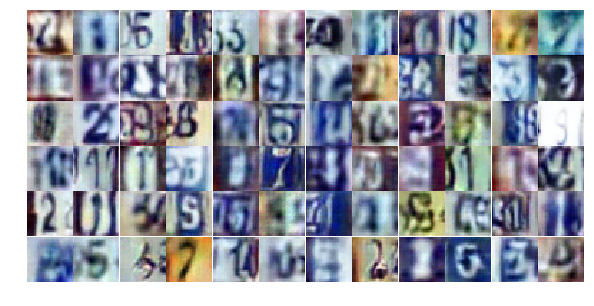

Epoch 18/25... Discriminator Loss: 1.3014... Generator Loss: 0.5575
Epoch 18/25... Discriminator Loss: 0.9647... Generator Loss: 0.7327
Epoch 18/25... Discriminator Loss: 0.7563... Generator Loss: 1.1969
Epoch 18/25... Discriminator Loss: 0.6481... Generator Loss: 1.0383
Epoch 18/25... Discriminator Loss: 0.4453... Generator Loss: 1.4061
Epoch 18/25... Discriminator Loss: 1.0215... Generator Loss: 0.6893
Epoch 18/25... Discriminator Loss: 0.7847... Generator Loss: 0.9264
Epoch 18/25... Discriminator Loss: 0.6853... Generator Loss: 1.1113
Epoch 18/25... Discriminator Loss: 0.6001... Generator Loss: 1.0976
Epoch 18/25... Discriminator Loss: 0.5501... Generator Loss: 1.1283


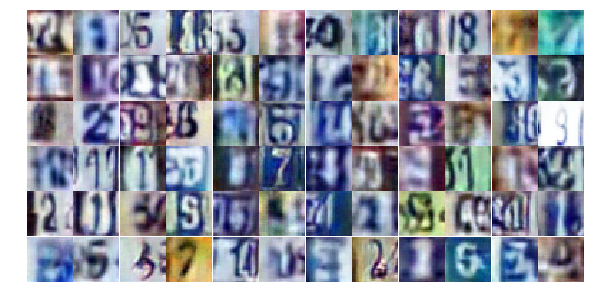

Epoch 18/25... Discriminator Loss: 0.3767... Generator Loss: 1.8015
Epoch 18/25... Discriminator Loss: 0.5674... Generator Loss: 1.2601
Epoch 18/25... Discriminator Loss: 0.4704... Generator Loss: 1.4596
Epoch 18/25... Discriminator Loss: 0.7076... Generator Loss: 0.9297
Epoch 18/25... Discriminator Loss: 0.8277... Generator Loss: 0.8182
Epoch 18/25... Discriminator Loss: 0.7527... Generator Loss: 0.9750
Epoch 18/25... Discriminator Loss: 0.7030... Generator Loss: 1.0543
Epoch 18/25... Discriminator Loss: 0.2453... Generator Loss: 2.2220
Epoch 18/25... Discriminator Loss: 0.4900... Generator Loss: 1.2270
Epoch 18/25... Discriminator Loss: 0.6469... Generator Loss: 1.0570


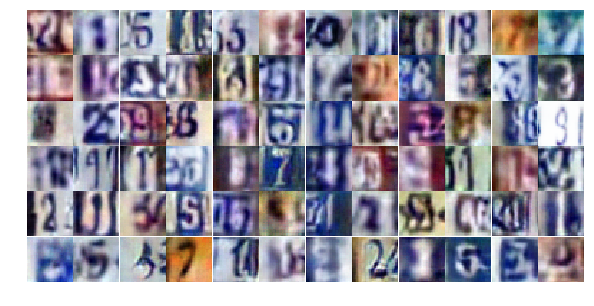

Epoch 18/25... Discriminator Loss: 1.2167... Generator Loss: 0.5101
Epoch 18/25... Discriminator Loss: 0.6234... Generator Loss: 1.0353
Epoch 18/25... Discriminator Loss: 0.3881... Generator Loss: 1.5408
Epoch 18/25... Discriminator Loss: 0.5112... Generator Loss: 1.3139
Epoch 18/25... Discriminator Loss: 0.9038... Generator Loss: 0.7416
Epoch 18/25... Discriminator Loss: 0.3988... Generator Loss: 1.4896
Epoch 18/25... Discriminator Loss: 0.4896... Generator Loss: 1.3440
Epoch 18/25... Discriminator Loss: 0.7334... Generator Loss: 2.3757
Epoch 18/25... Discriminator Loss: 0.5394... Generator Loss: 1.2835
Epoch 18/25... Discriminator Loss: 0.2880... Generator Loss: 1.8800


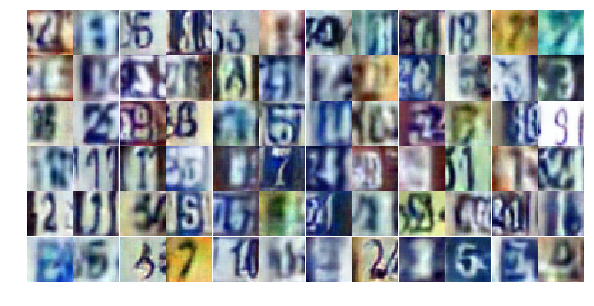

Epoch 18/25... Discriminator Loss: 0.4960... Generator Loss: 1.3821
Epoch 18/25... Discriminator Loss: 0.8707... Generator Loss: 0.7905
Epoch 18/25... Discriminator Loss: 0.8452... Generator Loss: 0.7643
Epoch 18/25... Discriminator Loss: 0.9651... Generator Loss: 0.6555
Epoch 18/25... Discriminator Loss: 0.4406... Generator Loss: 1.4761
Epoch 18/25... Discriminator Loss: 0.3113... Generator Loss: 2.6464
Epoch 18/25... Discriminator Loss: 0.5242... Generator Loss: 1.1610
Epoch 18/25... Discriminator Loss: 0.2557... Generator Loss: 2.1266
Epoch 18/25... Discriminator Loss: 0.9114... Generator Loss: 0.6953
Epoch 18/25... Discriminator Loss: 0.7147... Generator Loss: 0.9105


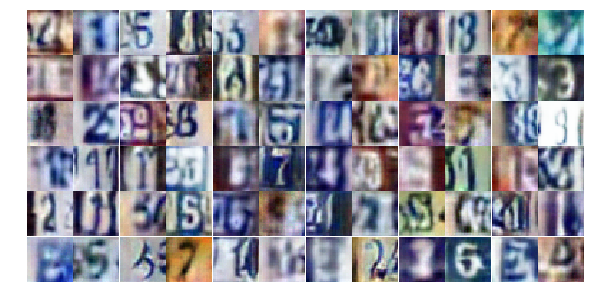

Epoch 18/25... Discriminator Loss: 0.5884... Generator Loss: 2.4894
Epoch 19/25... Discriminator Loss: 1.0061... Generator Loss: 0.6795
Epoch 19/25... Discriminator Loss: 0.7170... Generator Loss: 0.9288
Epoch 19/25... Discriminator Loss: 0.8388... Generator Loss: 0.8511
Epoch 19/25... Discriminator Loss: 0.2703... Generator Loss: 2.0398
Epoch 19/25... Discriminator Loss: 1.6845... Generator Loss: 0.3021
Epoch 19/25... Discriminator Loss: 0.4041... Generator Loss: 1.5819
Epoch 19/25... Discriminator Loss: 1.2656... Generator Loss: 0.5699
Epoch 19/25... Discriminator Loss: 0.4821... Generator Loss: 1.4243
Epoch 19/25... Discriminator Loss: 0.7162... Generator Loss: 1.1500


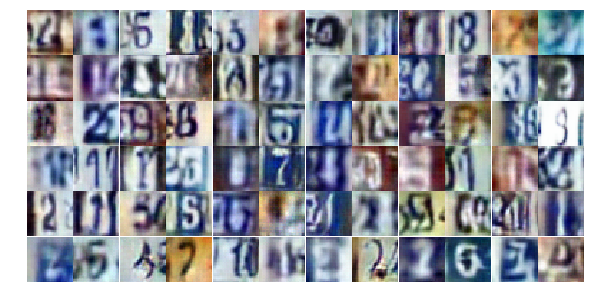

Epoch 19/25... Discriminator Loss: 0.6274... Generator Loss: 1.0308
Epoch 19/25... Discriminator Loss: 0.5593... Generator Loss: 1.1233
Epoch 19/25... Discriminator Loss: 0.4427... Generator Loss: 2.1931
Epoch 19/25... Discriminator Loss: 0.2887... Generator Loss: 1.9481
Epoch 19/25... Discriminator Loss: 0.7449... Generator Loss: 0.9793
Epoch 19/25... Discriminator Loss: 0.5659... Generator Loss: 2.5183
Epoch 19/25... Discriminator Loss: 1.4551... Generator Loss: 2.9759
Epoch 19/25... Discriminator Loss: 0.7812... Generator Loss: 0.9261
Epoch 19/25... Discriminator Loss: 0.6407... Generator Loss: 1.3435
Epoch 19/25... Discriminator Loss: 0.5233... Generator Loss: 1.3395


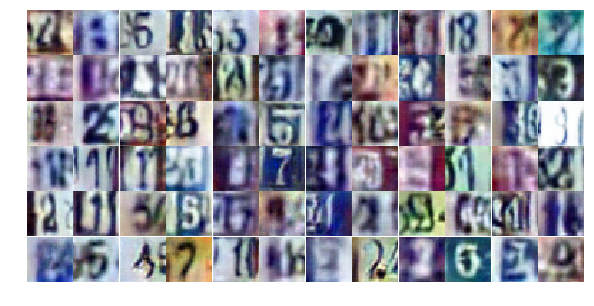

Epoch 19/25... Discriminator Loss: 0.6292... Generator Loss: 1.0889
Epoch 19/25... Discriminator Loss: 1.1061... Generator Loss: 0.6336
Epoch 19/25... Discriminator Loss: 1.4270... Generator Loss: 0.4209
Epoch 19/25... Discriminator Loss: 0.8278... Generator Loss: 0.8365
Epoch 19/25... Discriminator Loss: 1.0701... Generator Loss: 0.5789
Epoch 19/25... Discriminator Loss: 0.6336... Generator Loss: 1.1942
Epoch 19/25... Discriminator Loss: 0.5923... Generator Loss: 1.1586
Epoch 19/25... Discriminator Loss: 0.5777... Generator Loss: 1.1176
Epoch 19/25... Discriminator Loss: 0.7041... Generator Loss: 0.9693
Epoch 19/25... Discriminator Loss: 0.6203... Generator Loss: 1.0902


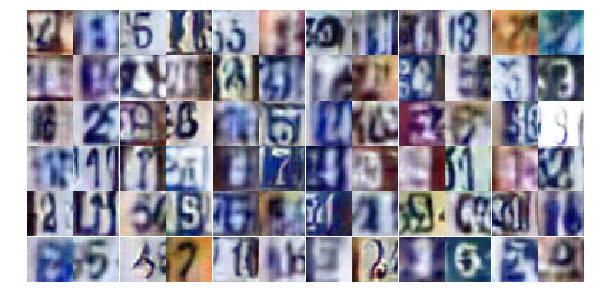

Epoch 19/25... Discriminator Loss: 0.6113... Generator Loss: 1.0779
Epoch 19/25... Discriminator Loss: 0.6890... Generator Loss: 0.9577
Epoch 19/25... Discriminator Loss: 0.8808... Generator Loss: 0.7162
Epoch 19/25... Discriminator Loss: 0.8804... Generator Loss: 0.7259
Epoch 19/25... Discriminator Loss: 0.4737... Generator Loss: 1.7720
Epoch 19/25... Discriminator Loss: 1.1565... Generator Loss: 0.5162
Epoch 19/25... Discriminator Loss: 0.7855... Generator Loss: 0.8008
Epoch 19/25... Discriminator Loss: 0.5632... Generator Loss: 1.2849
Epoch 19/25... Discriminator Loss: 0.6897... Generator Loss: 1.1967
Epoch 19/25... Discriminator Loss: 0.6203... Generator Loss: 1.0628


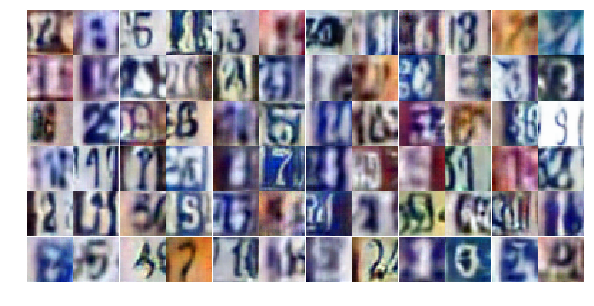

Epoch 19/25... Discriminator Loss: 0.6256... Generator Loss: 1.0057
Epoch 19/25... Discriminator Loss: 0.7664... Generator Loss: 0.8936
Epoch 19/25... Discriminator Loss: 1.3565... Generator Loss: 0.4069
Epoch 19/25... Discriminator Loss: 0.9052... Generator Loss: 0.7148
Epoch 19/25... Discriminator Loss: 0.6265... Generator Loss: 1.1172
Epoch 19/25... Discriminator Loss: 1.2154... Generator Loss: 3.4099
Epoch 19/25... Discriminator Loss: 0.6657... Generator Loss: 1.0636
Epoch 19/25... Discriminator Loss: 0.6401... Generator Loss: 1.0196
Epoch 19/25... Discriminator Loss: 0.5503... Generator Loss: 1.8553
Epoch 19/25... Discriminator Loss: 0.9925... Generator Loss: 0.6839


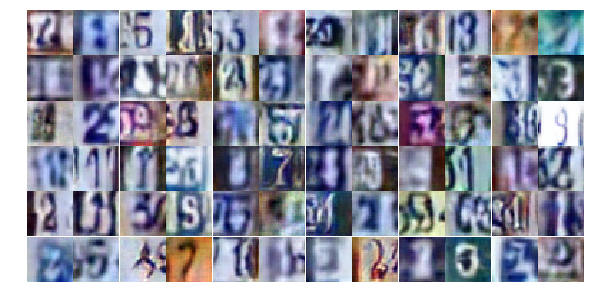

Epoch 19/25... Discriminator Loss: 0.4948... Generator Loss: 1.2864
Epoch 19/25... Discriminator Loss: 1.4552... Generator Loss: 0.4789
Epoch 19/25... Discriminator Loss: 0.7550... Generator Loss: 2.8582
Epoch 19/25... Discriminator Loss: 0.6448... Generator Loss: 2.5245
Epoch 19/25... Discriminator Loss: 0.7324... Generator Loss: 2.6427
Epoch 19/25... Discriminator Loss: 0.7156... Generator Loss: 1.6437
Epoch 19/25... Discriminator Loss: 2.1265... Generator Loss: 0.2610
Epoch 19/25... Discriminator Loss: 0.7211... Generator Loss: 1.4141
Epoch 20/25... Discriminator Loss: 0.7479... Generator Loss: 0.9791
Epoch 20/25... Discriminator Loss: 0.6957... Generator Loss: 0.9665


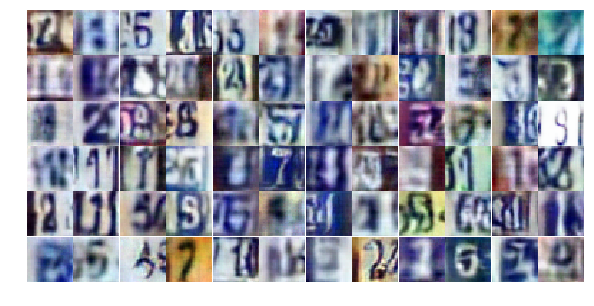

Epoch 20/25... Discriminator Loss: 0.4888... Generator Loss: 1.4171
Epoch 20/25... Discriminator Loss: 1.2021... Generator Loss: 0.4986
Epoch 20/25... Discriminator Loss: 1.5938... Generator Loss: 0.3510
Epoch 20/25... Discriminator Loss: 0.7522... Generator Loss: 0.8755
Epoch 20/25... Discriminator Loss: 0.4194... Generator Loss: 1.6861
Epoch 20/25... Discriminator Loss: 0.4966... Generator Loss: 1.3079
Epoch 20/25... Discriminator Loss: 0.5746... Generator Loss: 1.2526
Epoch 20/25... Discriminator Loss: 0.8264... Generator Loss: 1.1227
Epoch 20/25... Discriminator Loss: 2.0116... Generator Loss: 0.2302
Epoch 20/25... Discriminator Loss: 1.0707... Generator Loss: 0.6513


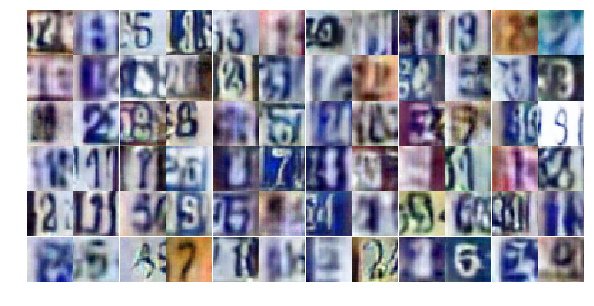

Epoch 20/25... Discriminator Loss: 1.4092... Generator Loss: 0.4931
Epoch 20/25... Discriminator Loss: 0.6787... Generator Loss: 1.9467
Epoch 20/25... Discriminator Loss: 0.6986... Generator Loss: 2.4084
Epoch 20/25... Discriminator Loss: 0.4738... Generator Loss: 1.5710
Epoch 20/25... Discriminator Loss: 0.8180... Generator Loss: 0.8324
Epoch 20/25... Discriminator Loss: 0.9628... Generator Loss: 2.5901
Epoch 20/25... Discriminator Loss: 0.7702... Generator Loss: 2.5062
Epoch 20/25... Discriminator Loss: 0.8700... Generator Loss: 0.8923
Epoch 20/25... Discriminator Loss: 0.4048... Generator Loss: 1.7169
Epoch 20/25... Discriminator Loss: 1.0173... Generator Loss: 0.6531


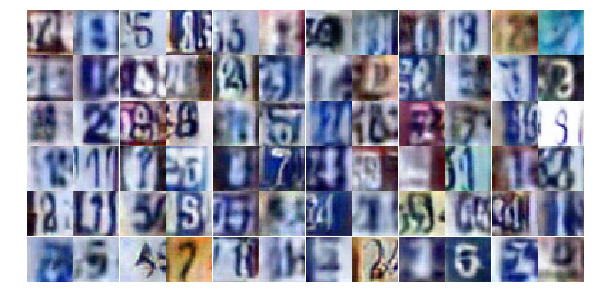

Epoch 20/25... Discriminator Loss: 0.5801... Generator Loss: 1.2052
Epoch 20/25... Discriminator Loss: 0.6690... Generator Loss: 1.0516
Epoch 20/25... Discriminator Loss: 0.2462... Generator Loss: 1.9187
Epoch 20/25... Discriminator Loss: 1.3155... Generator Loss: 0.4126
Epoch 20/25... Discriminator Loss: 0.8218... Generator Loss: 0.7823
Epoch 20/25... Discriminator Loss: 0.4132... Generator Loss: 2.7587
Epoch 20/25... Discriminator Loss: 0.5893... Generator Loss: 1.1249
Epoch 20/25... Discriminator Loss: 1.3726... Generator Loss: 0.4220
Epoch 20/25... Discriminator Loss: 1.0052... Generator Loss: 0.6431
Epoch 20/25... Discriminator Loss: 0.2626... Generator Loss: 1.9351


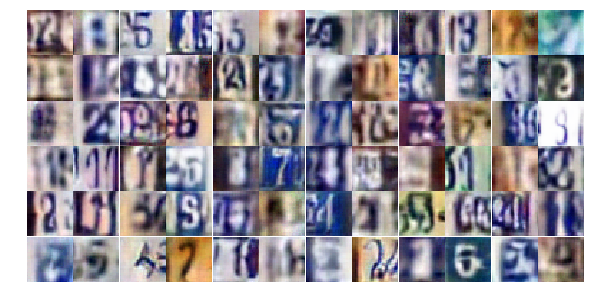

Epoch 20/25... Discriminator Loss: 0.7841... Generator Loss: 0.8793
Epoch 20/25... Discriminator Loss: 0.7498... Generator Loss: 1.0085
Epoch 20/25... Discriminator Loss: 2.2781... Generator Loss: 0.2096
Epoch 20/25... Discriminator Loss: 0.9165... Generator Loss: 0.7707
Epoch 20/25... Discriminator Loss: 0.5568... Generator Loss: 1.3204
Epoch 20/25... Discriminator Loss: 0.4956... Generator Loss: 1.4943
Epoch 20/25... Discriminator Loss: 0.5724... Generator Loss: 1.5654
Epoch 20/25... Discriminator Loss: 0.6531... Generator Loss: 1.0681
Epoch 20/25... Discriminator Loss: 0.7455... Generator Loss: 1.1459
Epoch 20/25... Discriminator Loss: 0.8889... Generator Loss: 0.7382


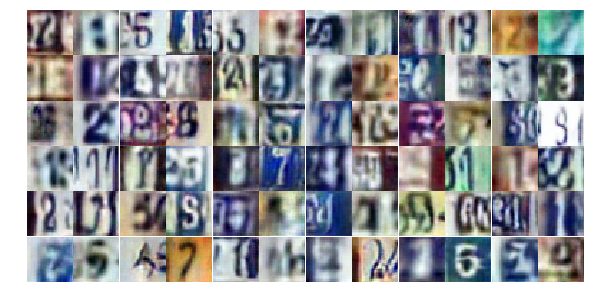

Epoch 20/25... Discriminator Loss: 0.3984... Generator Loss: 1.5273
Epoch 20/25... Discriminator Loss: 0.7315... Generator Loss: 0.8696
Epoch 20/25... Discriminator Loss: 0.4941... Generator Loss: 1.8909
Epoch 20/25... Discriminator Loss: 0.3653... Generator Loss: 1.7680
Epoch 20/25... Discriminator Loss: 0.4877... Generator Loss: 1.5325
Epoch 20/25... Discriminator Loss: 1.1688... Generator Loss: 0.5127
Epoch 20/25... Discriminator Loss: 0.8605... Generator Loss: 0.8476
Epoch 20/25... Discriminator Loss: 0.5351... Generator Loss: 1.2029
Epoch 20/25... Discriminator Loss: 0.3019... Generator Loss: 1.8949
Epoch 20/25... Discriminator Loss: 0.4620... Generator Loss: 1.3925


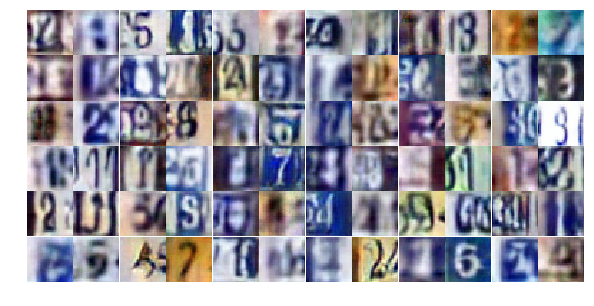

Epoch 20/25... Discriminator Loss: 0.4069... Generator Loss: 1.5327
Epoch 20/25... Discriminator Loss: 0.7167... Generator Loss: 0.9497
Epoch 20/25... Discriminator Loss: 0.3329... Generator Loss: 2.3485
Epoch 20/25... Discriminator Loss: 0.7067... Generator Loss: 1.9719
Epoch 20/25... Discriminator Loss: 0.9860... Generator Loss: 4.8896
Epoch 20/25... Discriminator Loss: 0.8699... Generator Loss: 1.1715
Epoch 21/25... Discriminator Loss: 1.2354... Generator Loss: 0.7413
Epoch 21/25... Discriminator Loss: 0.7464... Generator Loss: 2.0508
Epoch 21/25... Discriminator Loss: 1.1154... Generator Loss: 0.5739
Epoch 21/25... Discriminator Loss: 0.8101... Generator Loss: 0.9444


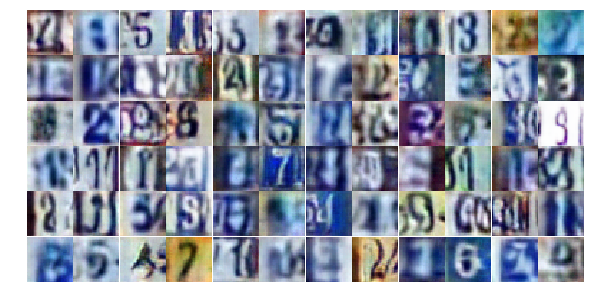

Epoch 21/25... Discriminator Loss: 0.6139... Generator Loss: 1.1584
Epoch 21/25... Discriminator Loss: 1.6764... Generator Loss: 0.3166
Epoch 21/25... Discriminator Loss: 0.4359... Generator Loss: 1.6293
Epoch 21/25... Discriminator Loss: 0.2828... Generator Loss: 1.7965
Epoch 21/25... Discriminator Loss: 1.1201... Generator Loss: 0.5680
Epoch 21/25... Discriminator Loss: 0.4993... Generator Loss: 1.2777
Epoch 21/25... Discriminator Loss: 0.5400... Generator Loss: 1.2548
Epoch 21/25... Discriminator Loss: 0.9503... Generator Loss: 0.6865
Epoch 21/25... Discriminator Loss: 0.6667... Generator Loss: 1.0129
Epoch 21/25... Discriminator Loss: 0.6905... Generator Loss: 1.0066


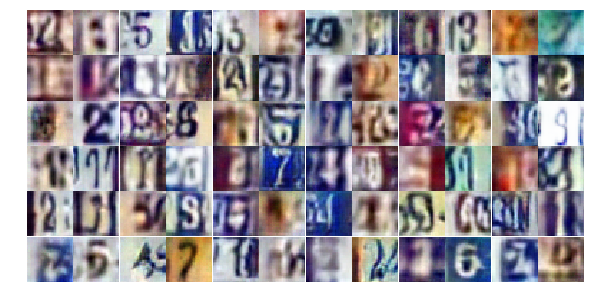

Epoch 21/25... Discriminator Loss: 0.4002... Generator Loss: 1.5010
Epoch 21/25... Discriminator Loss: 0.6681... Generator Loss: 1.0206
Epoch 21/25... Discriminator Loss: 1.9608... Generator Loss: 0.3660
Epoch 21/25... Discriminator Loss: 2.4061... Generator Loss: 0.1571
Epoch 21/25... Discriminator Loss: 0.4207... Generator Loss: 2.2623
Epoch 21/25... Discriminator Loss: 0.9737... Generator Loss: 0.6598
Epoch 21/25... Discriminator Loss: 0.9556... Generator Loss: 0.6362
Epoch 21/25... Discriminator Loss: 0.5245... Generator Loss: 1.1593
Epoch 21/25... Discriminator Loss: 0.5046... Generator Loss: 1.3076
Epoch 21/25... Discriminator Loss: 0.7913... Generator Loss: 0.8000


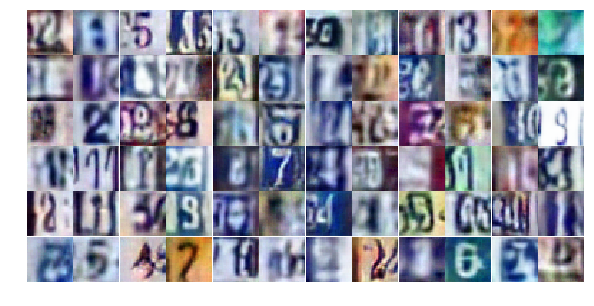

Epoch 21/25... Discriminator Loss: 1.1171... Generator Loss: 0.6152
Epoch 21/25... Discriminator Loss: 0.2926... Generator Loss: 1.9802
Epoch 21/25... Discriminator Loss: 0.8028... Generator Loss: 0.9017
Epoch 21/25... Discriminator Loss: 0.6999... Generator Loss: 0.9844
Epoch 21/25... Discriminator Loss: 0.9837... Generator Loss: 0.7246
Epoch 21/25... Discriminator Loss: 1.2480... Generator Loss: 0.5213
Epoch 21/25... Discriminator Loss: 0.6835... Generator Loss: 0.8923
Epoch 21/25... Discriminator Loss: 0.8462... Generator Loss: 0.8418
Epoch 21/25... Discriminator Loss: 1.0433... Generator Loss: 0.6548
Epoch 21/25... Discriminator Loss: 1.6933... Generator Loss: 0.3960


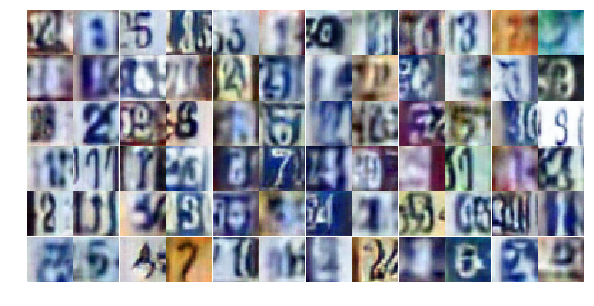

Epoch 21/25... Discriminator Loss: 1.6219... Generator Loss: 0.3494
Epoch 21/25... Discriminator Loss: 0.6809... Generator Loss: 0.9791
Epoch 21/25... Discriminator Loss: 1.0322... Generator Loss: 0.6325
Epoch 21/25... Discriminator Loss: 0.4636... Generator Loss: 1.3221
Epoch 21/25... Discriminator Loss: 0.4179... Generator Loss: 1.5001
Epoch 21/25... Discriminator Loss: 0.8733... Generator Loss: 0.7112
Epoch 21/25... Discriminator Loss: 0.5508... Generator Loss: 1.2338
Epoch 21/25... Discriminator Loss: 0.7491... Generator Loss: 0.8746
Epoch 21/25... Discriminator Loss: 1.4405... Generator Loss: 0.3954
Epoch 21/25... Discriminator Loss: 0.2944... Generator Loss: 2.0231


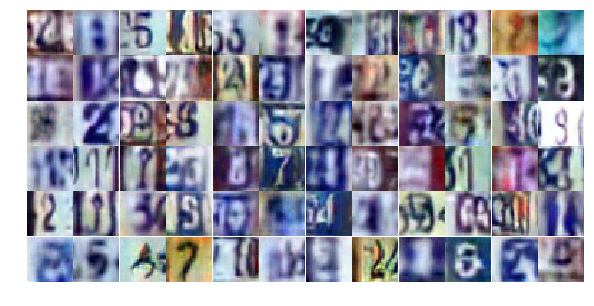

Epoch 21/25... Discriminator Loss: 1.9566... Generator Loss: 0.5231
Epoch 21/25... Discriminator Loss: 2.8097... Generator Loss: 0.1084
Epoch 21/25... Discriminator Loss: 0.6972... Generator Loss: 2.8339
Epoch 21/25... Discriminator Loss: 0.6988... Generator Loss: 1.2139
Epoch 21/25... Discriminator Loss: 0.3910... Generator Loss: 1.7801
Epoch 21/25... Discriminator Loss: 0.5528... Generator Loss: 1.3528
Epoch 21/25... Discriminator Loss: 0.7075... Generator Loss: 1.0507
Epoch 21/25... Discriminator Loss: 0.8994... Generator Loss: 0.7417
Epoch 21/25... Discriminator Loss: 1.7379... Generator Loss: 0.3555
Epoch 21/25... Discriminator Loss: 0.5363... Generator Loss: 2.7646


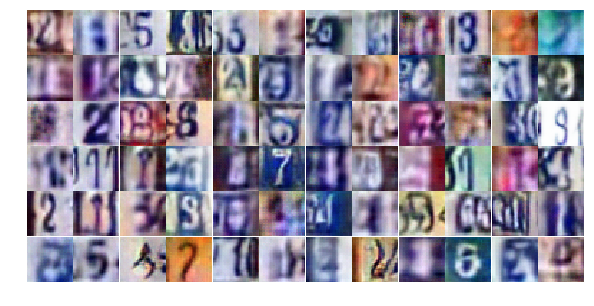

Epoch 21/25... Discriminator Loss: 0.6200... Generator Loss: 1.0763
Epoch 21/25... Discriminator Loss: 1.4400... Generator Loss: 0.4078
Epoch 21/25... Discriminator Loss: 0.5024... Generator Loss: 1.5464
Epoch 22/25... Discriminator Loss: 0.7809... Generator Loss: 2.1992
Epoch 22/25... Discriminator Loss: 1.4376... Generator Loss: 0.4375
Epoch 22/25... Discriminator Loss: 0.5334... Generator Loss: 1.6281
Epoch 22/25... Discriminator Loss: 0.4761... Generator Loss: 1.3163
Epoch 22/25... Discriminator Loss: 0.4881... Generator Loss: 1.2052
Epoch 22/25... Discriminator Loss: 1.8578... Generator Loss: 0.3058
Epoch 22/25... Discriminator Loss: 1.0184... Generator Loss: 0.5845


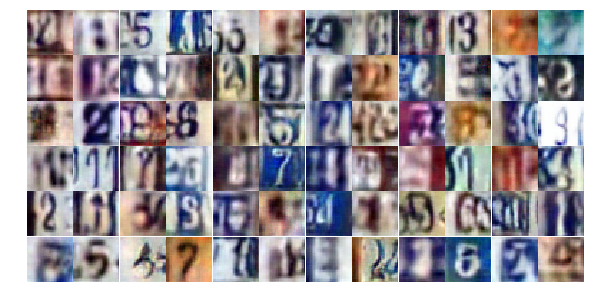

Epoch 22/25... Discriminator Loss: 0.5133... Generator Loss: 1.3703
Epoch 22/25... Discriminator Loss: 0.8149... Generator Loss: 0.8371
Epoch 22/25... Discriminator Loss: 1.4300... Generator Loss: 0.3788
Epoch 22/25... Discriminator Loss: 0.8112... Generator Loss: 0.8256
Epoch 22/25... Discriminator Loss: 0.7419... Generator Loss: 1.5764
Epoch 22/25... Discriminator Loss: 0.6990... Generator Loss: 0.9551
Epoch 22/25... Discriminator Loss: 0.4983... Generator Loss: 1.3157
Epoch 22/25... Discriminator Loss: 0.3572... Generator Loss: 1.6132
Epoch 22/25... Discriminator Loss: 0.8747... Generator Loss: 0.8173
Epoch 22/25... Discriminator Loss: 1.6512... Generator Loss: 0.3246


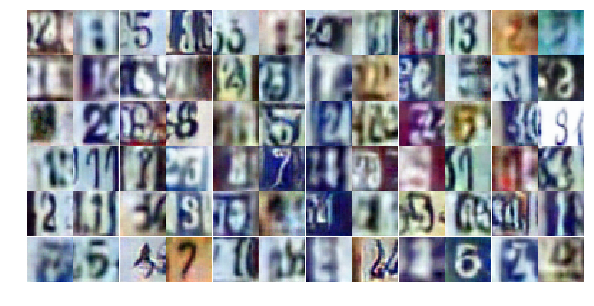

Epoch 22/25... Discriminator Loss: 0.3793... Generator Loss: 1.6847
Epoch 22/25... Discriminator Loss: 0.5889... Generator Loss: 1.1151
Epoch 22/25... Discriminator Loss: 0.5395... Generator Loss: 1.2794
Epoch 22/25... Discriminator Loss: 0.3789... Generator Loss: 1.6609
Epoch 22/25... Discriminator Loss: 0.5168... Generator Loss: 1.2271
Epoch 22/25... Discriminator Loss: 1.0705... Generator Loss: 0.5621
Epoch 22/25... Discriminator Loss: 0.3336... Generator Loss: 1.9041
Epoch 22/25... Discriminator Loss: 0.2957... Generator Loss: 2.5813
Epoch 22/25... Discriminator Loss: 2.1602... Generator Loss: 0.2238
Epoch 22/25... Discriminator Loss: 1.2392... Generator Loss: 0.5091


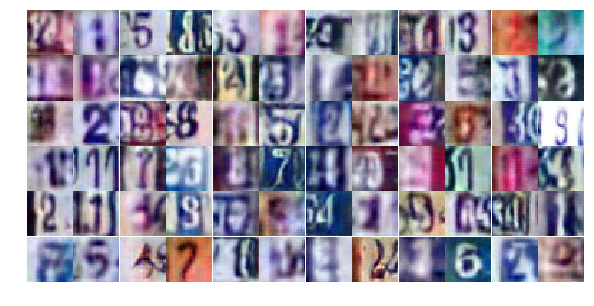

Epoch 22/25... Discriminator Loss: 0.3981... Generator Loss: 1.4725
Epoch 22/25... Discriminator Loss: 0.3971... Generator Loss: 1.5617
Epoch 22/25... Discriminator Loss: 1.4183... Generator Loss: 0.4000
Epoch 22/25... Discriminator Loss: 0.7594... Generator Loss: 0.8810
Epoch 22/25... Discriminator Loss: 0.7504... Generator Loss: 0.8570
Epoch 22/25... Discriminator Loss: 0.8363... Generator Loss: 0.9160
Epoch 22/25... Discriminator Loss: 1.9165... Generator Loss: 0.2282
Epoch 22/25... Discriminator Loss: 0.4913... Generator Loss: 1.4027
Epoch 22/25... Discriminator Loss: 0.8836... Generator Loss: 0.7578
Epoch 22/25... Discriminator Loss: 1.3028... Generator Loss: 0.4668


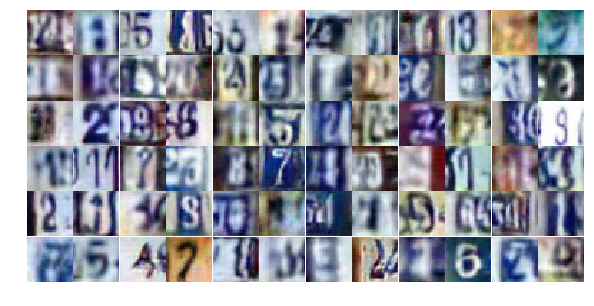

Epoch 22/25... Discriminator Loss: 0.7460... Generator Loss: 0.9810
Epoch 22/25... Discriminator Loss: 0.3877... Generator Loss: 1.6871
Epoch 22/25... Discriminator Loss: 0.5148... Generator Loss: 1.1819
Epoch 22/25... Discriminator Loss: 0.4835... Generator Loss: 1.3465
Epoch 22/25... Discriminator Loss: 0.6169... Generator Loss: 1.0016
Epoch 22/25... Discriminator Loss: 0.6661... Generator Loss: 0.9255
Epoch 22/25... Discriminator Loss: 0.6167... Generator Loss: 1.1024
Epoch 22/25... Discriminator Loss: 1.1977... Generator Loss: 0.6045
Epoch 22/25... Discriminator Loss: 0.9012... Generator Loss: 0.8991
Epoch 22/25... Discriminator Loss: 0.5829... Generator Loss: 1.3367


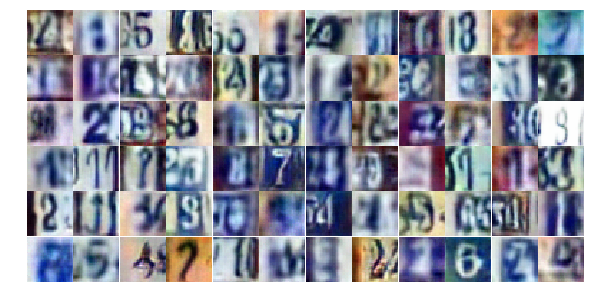

Epoch 22/25... Discriminator Loss: 0.6180... Generator Loss: 1.0843
Epoch 22/25... Discriminator Loss: 0.4945... Generator Loss: 1.1907
Epoch 22/25... Discriminator Loss: 0.8278... Generator Loss: 0.7729
Epoch 22/25... Discriminator Loss: 0.7244... Generator Loss: 0.9248
Epoch 22/25... Discriminator Loss: 0.3554... Generator Loss: 1.8081
Epoch 22/25... Discriminator Loss: 0.7541... Generator Loss: 1.4373
Epoch 22/25... Discriminator Loss: 1.3355... Generator Loss: 0.5056
Epoch 22/25... Discriminator Loss: 0.4697... Generator Loss: 1.3166
Epoch 22/25... Discriminator Loss: 0.9885... Generator Loss: 2.9680
Epoch 22/25... Discriminator Loss: 0.9146... Generator Loss: 0.7261


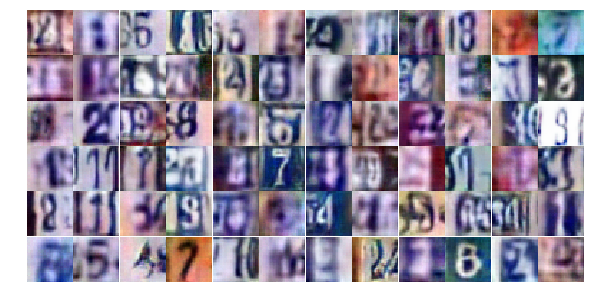

Epoch 23/25... Discriminator Loss: 0.4605... Generator Loss: 1.4055
Epoch 23/25... Discriminator Loss: 0.3690... Generator Loss: 1.9127
Epoch 23/25... Discriminator Loss: 1.5309... Generator Loss: 0.3879
Epoch 23/25... Discriminator Loss: 2.0086... Generator Loss: 0.2576
Epoch 23/25... Discriminator Loss: 1.1748... Generator Loss: 0.5253
Epoch 23/25... Discriminator Loss: 0.7669... Generator Loss: 1.5699
Epoch 23/25... Discriminator Loss: 0.8710... Generator Loss: 0.7671
Epoch 23/25... Discriminator Loss: 0.6259... Generator Loss: 1.0848
Epoch 23/25... Discriminator Loss: 0.6202... Generator Loss: 1.1135
Epoch 23/25... Discriminator Loss: 0.2575... Generator Loss: 2.0965


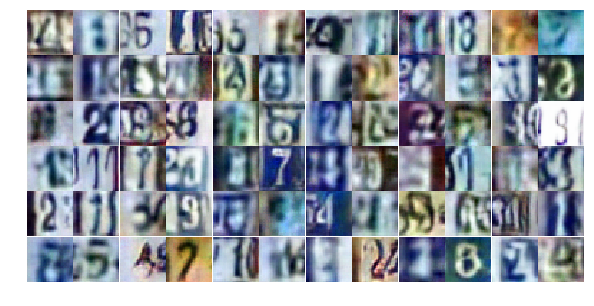

Epoch 23/25... Discriminator Loss: 0.7343... Generator Loss: 0.8774
Epoch 23/25... Discriminator Loss: 0.9781... Generator Loss: 0.6430
Epoch 23/25... Discriminator Loss: 0.7684... Generator Loss: 0.8999
Epoch 23/25... Discriminator Loss: 0.9471... Generator Loss: 0.6811
Epoch 23/25... Discriminator Loss: 0.2184... Generator Loss: 2.3431
Epoch 23/25... Discriminator Loss: 0.9503... Generator Loss: 0.7574
Epoch 23/25... Discriminator Loss: 0.7466... Generator Loss: 0.9029
Epoch 23/25... Discriminator Loss: 1.1165... Generator Loss: 2.7571
Epoch 23/25... Discriminator Loss: 0.5958... Generator Loss: 1.7999
Epoch 23/25... Discriminator Loss: 0.7511... Generator Loss: 0.9990


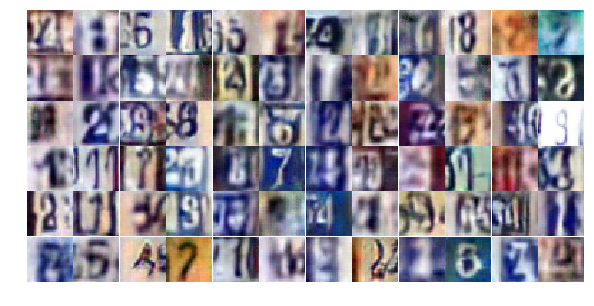

Epoch 23/25... Discriminator Loss: 0.7874... Generator Loss: 0.9266
Epoch 23/25... Discriminator Loss: 0.5473... Generator Loss: 1.2932
Epoch 23/25... Discriminator Loss: 1.0673... Generator Loss: 0.5386
Epoch 23/25... Discriminator Loss: 0.9304... Generator Loss: 0.7929
Epoch 23/25... Discriminator Loss: 0.4848... Generator Loss: 1.5537
Epoch 23/25... Discriminator Loss: 0.9705... Generator Loss: 0.6844
Epoch 23/25... Discriminator Loss: 0.6191... Generator Loss: 1.0013
Epoch 23/25... Discriminator Loss: 0.5862... Generator Loss: 1.1656
Epoch 23/25... Discriminator Loss: 0.3915... Generator Loss: 1.7598
Epoch 23/25... Discriminator Loss: 0.7322... Generator Loss: 1.7857


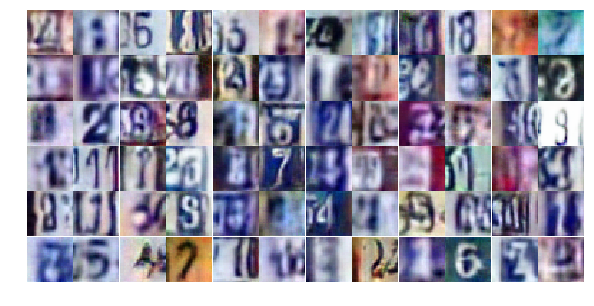

Epoch 23/25... Discriminator Loss: 0.5572... Generator Loss: 1.1421
Epoch 23/25... Discriminator Loss: 0.4482... Generator Loss: 1.4726
Epoch 23/25... Discriminator Loss: 0.5489... Generator Loss: 1.2831
Epoch 23/25... Discriminator Loss: 1.0856... Generator Loss: 0.5886
Epoch 23/25... Discriminator Loss: 1.7305... Generator Loss: 0.4814
Epoch 23/25... Discriminator Loss: 1.0572... Generator Loss: 0.6340
Epoch 23/25... Discriminator Loss: 1.2631... Generator Loss: 0.5625
Epoch 23/25... Discriminator Loss: 0.6261... Generator Loss: 1.1727
Epoch 23/25... Discriminator Loss: 0.3758... Generator Loss: 1.5227
Epoch 23/25... Discriminator Loss: 0.4841... Generator Loss: 1.5896


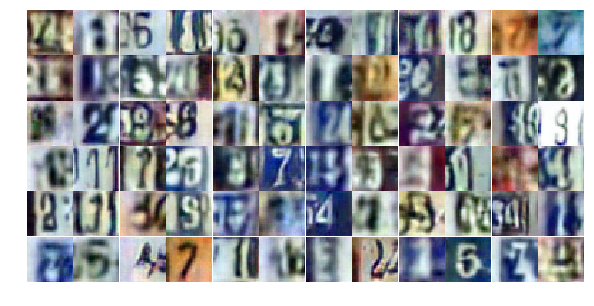

Epoch 23/25... Discriminator Loss: 0.8920... Generator Loss: 0.8241
Epoch 23/25... Discriminator Loss: 0.5949... Generator Loss: 1.1843
Epoch 23/25... Discriminator Loss: 1.1347... Generator Loss: 0.5285
Epoch 23/25... Discriminator Loss: 0.7271... Generator Loss: 0.9196
Epoch 23/25... Discriminator Loss: 0.7053... Generator Loss: 1.0803
Epoch 23/25... Discriminator Loss: 0.6644... Generator Loss: 1.0262
Epoch 23/25... Discriminator Loss: 0.4888... Generator Loss: 1.5655
Epoch 23/25... Discriminator Loss: 0.8091... Generator Loss: 0.8843
Epoch 23/25... Discriminator Loss: 0.5837... Generator Loss: 1.2540
Epoch 23/25... Discriminator Loss: 0.7167... Generator Loss: 0.9989


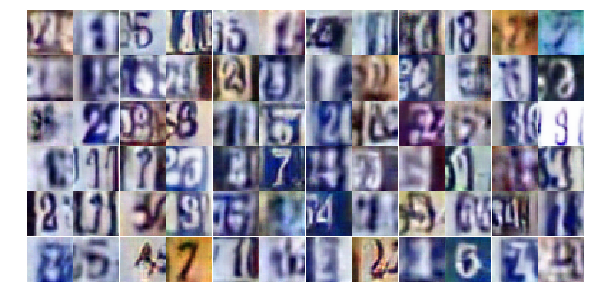

Epoch 23/25... Discriminator Loss: 0.6108... Generator Loss: 1.0721
Epoch 23/25... Discriminator Loss: 0.6179... Generator Loss: 1.1481
Epoch 23/25... Discriminator Loss: 1.3703... Generator Loss: 0.4169
Epoch 23/25... Discriminator Loss: 0.2692... Generator Loss: 1.9610
Epoch 23/25... Discriminator Loss: 1.0848... Generator Loss: 0.6010
Epoch 23/25... Discriminator Loss: 0.4446... Generator Loss: 1.5645
Epoch 23/25... Discriminator Loss: 1.3718... Generator Loss: 0.4763
Epoch 24/25... Discriminator Loss: 3.7894... Generator Loss: 0.1224
Epoch 24/25... Discriminator Loss: 1.2334... Generator Loss: 1.7888
Epoch 24/25... Discriminator Loss: 1.1777... Generator Loss: 0.6182


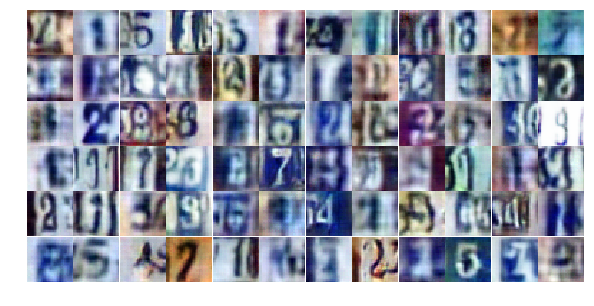

Epoch 24/25... Discriminator Loss: 0.9357... Generator Loss: 1.0416
Epoch 24/25... Discriminator Loss: 0.6635... Generator Loss: 1.1178
Epoch 24/25... Discriminator Loss: 0.7668... Generator Loss: 0.9235
Epoch 24/25... Discriminator Loss: 0.9100... Generator Loss: 0.9799
Epoch 24/25... Discriminator Loss: 0.5805... Generator Loss: 1.2287
Epoch 24/25... Discriminator Loss: 0.5659... Generator Loss: 1.4141
Epoch 24/25... Discriminator Loss: 0.8215... Generator Loss: 0.8417
Epoch 24/25... Discriminator Loss: 0.9272... Generator Loss: 0.7685
Epoch 24/25... Discriminator Loss: 0.5775... Generator Loss: 1.1925
Epoch 24/25... Discriminator Loss: 0.3954... Generator Loss: 1.5642


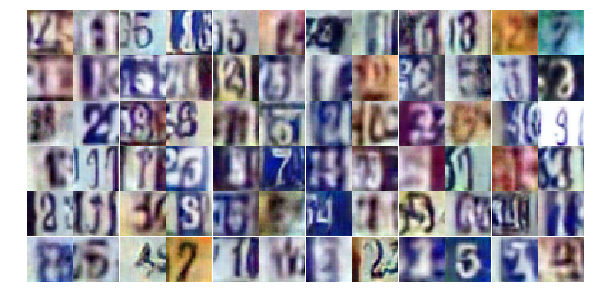

Epoch 24/25... Discriminator Loss: 1.3450... Generator Loss: 0.4431
Epoch 24/25... Discriminator Loss: 1.4919... Generator Loss: 0.3637
Epoch 24/25... Discriminator Loss: 1.2449... Generator Loss: 0.5237
Epoch 24/25... Discriminator Loss: 0.3726... Generator Loss: 1.5341
Epoch 24/25... Discriminator Loss: 0.7221... Generator Loss: 0.9246
Epoch 24/25... Discriminator Loss: 0.8496... Generator Loss: 0.8823
Epoch 24/25... Discriminator Loss: 0.3538... Generator Loss: 1.6954
Epoch 24/25... Discriminator Loss: 1.2013... Generator Loss: 0.5618
Epoch 24/25... Discriminator Loss: 0.9725... Generator Loss: 0.7450
Epoch 24/25... Discriminator Loss: 0.7732... Generator Loss: 0.9006


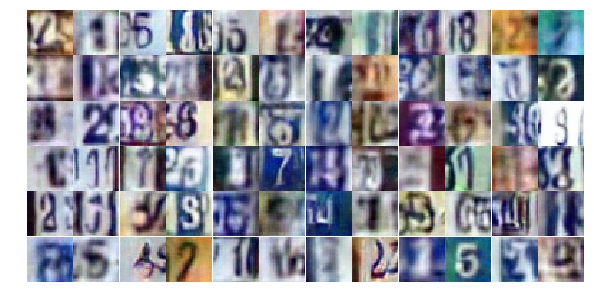

Epoch 24/25... Discriminator Loss: 0.7335... Generator Loss: 0.9564
Epoch 24/25... Discriminator Loss: 0.6426... Generator Loss: 1.0896
Epoch 24/25... Discriminator Loss: 0.4145... Generator Loss: 1.8143
Epoch 24/25... Discriminator Loss: 1.4322... Generator Loss: 0.4382
Epoch 24/25... Discriminator Loss: 0.3232... Generator Loss: 1.7324
Epoch 24/25... Discriminator Loss: 1.1593... Generator Loss: 0.5527
Epoch 24/25... Discriminator Loss: 0.4873... Generator Loss: 1.3009
Epoch 24/25... Discriminator Loss: 0.6147... Generator Loss: 1.0787
Epoch 24/25... Discriminator Loss: 0.8116... Generator Loss: 0.9180
Epoch 24/25... Discriminator Loss: 1.0250... Generator Loss: 0.6434


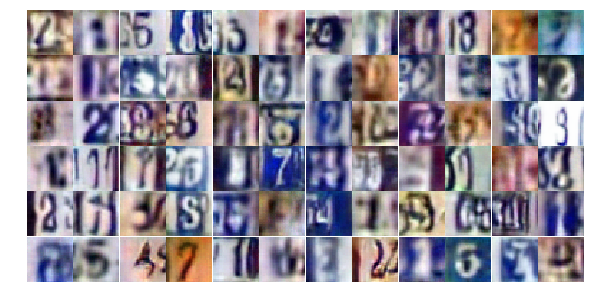

Epoch 24/25... Discriminator Loss: 0.5377... Generator Loss: 2.0750
Epoch 24/25... Discriminator Loss: 0.5308... Generator Loss: 1.1645
Epoch 24/25... Discriminator Loss: 1.0839... Generator Loss: 0.6110
Epoch 24/25... Discriminator Loss: 1.3187... Generator Loss: 0.4100
Epoch 24/25... Discriminator Loss: 0.6949... Generator Loss: 1.0851
Epoch 24/25... Discriminator Loss: 0.5748... Generator Loss: 1.3070
Epoch 24/25... Discriminator Loss: 0.9875... Generator Loss: 0.6167
Epoch 24/25... Discriminator Loss: 0.7997... Generator Loss: 0.9159
Epoch 24/25... Discriminator Loss: 0.5943... Generator Loss: 1.2338
Epoch 24/25... Discriminator Loss: 0.7104... Generator Loss: 0.9562


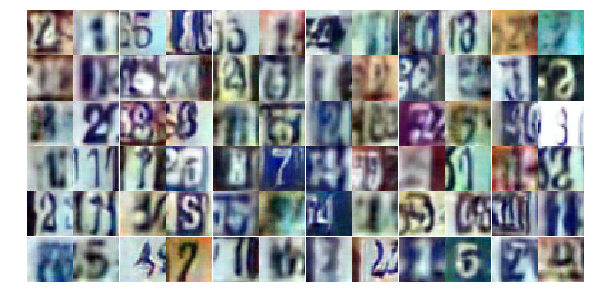

Epoch 24/25... Discriminator Loss: 1.1376... Generator Loss: 0.5742
Epoch 24/25... Discriminator Loss: 1.8891... Generator Loss: 0.2697
Epoch 24/25... Discriminator Loss: 1.9212... Generator Loss: 0.2399
Epoch 24/25... Discriminator Loss: 1.0404... Generator Loss: 0.8013
Epoch 24/25... Discriminator Loss: 0.9659... Generator Loss: 0.6830
Epoch 24/25... Discriminator Loss: 0.5328... Generator Loss: 1.2985
Epoch 24/25... Discriminator Loss: 0.8119... Generator Loss: 0.9279
Epoch 24/25... Discriminator Loss: 0.4956... Generator Loss: 1.3663
Epoch 24/25... Discriminator Loss: 0.5769... Generator Loss: 1.3775
Epoch 24/25... Discriminator Loss: 1.2893... Generator Loss: 0.4740


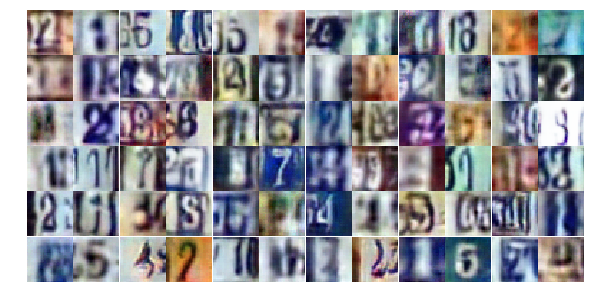

Epoch 24/25... Discriminator Loss: 0.7005... Generator Loss: 1.0042
Epoch 24/25... Discriminator Loss: 1.0401... Generator Loss: 0.6226
Epoch 24/25... Discriminator Loss: 1.0537... Generator Loss: 0.5693
Epoch 24/25... Discriminator Loss: 1.7316... Generator Loss: 4.7815
Epoch 24/25... Discriminator Loss: 1.0383... Generator Loss: 0.9110
Epoch 25/25... Discriminator Loss: 0.6502... Generator Loss: 1.2120
Epoch 25/25... Discriminator Loss: 0.5263... Generator Loss: 1.4443
Epoch 25/25... Discriminator Loss: 0.7814... Generator Loss: 0.9558
Epoch 25/25... Discriminator Loss: 0.8955... Generator Loss: 0.7531
Epoch 25/25... Discriminator Loss: 0.5930... Generator Loss: 1.1293


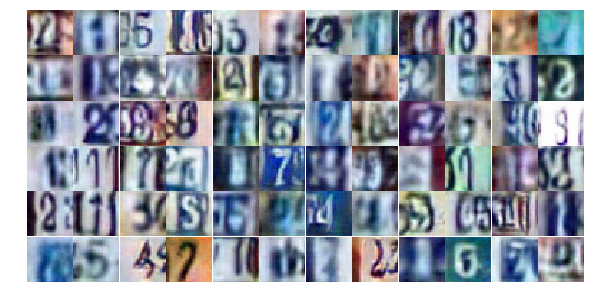

Epoch 25/25... Discriminator Loss: 1.0952... Generator Loss: 0.6127
Epoch 25/25... Discriminator Loss: 0.9520... Generator Loss: 0.8491
Epoch 25/25... Discriminator Loss: 0.4130... Generator Loss: 1.5878
Epoch 25/25... Discriminator Loss: 0.7636... Generator Loss: 0.8735
Epoch 25/25... Discriminator Loss: 0.6190... Generator Loss: 1.6025
Epoch 25/25... Discriminator Loss: 0.6491... Generator Loss: 1.0567
Epoch 25/25... Discriminator Loss: 0.6303... Generator Loss: 1.2295
Epoch 25/25... Discriminator Loss: 0.7614... Generator Loss: 1.0248
Epoch 25/25... Discriminator Loss: 0.6104... Generator Loss: 1.0549
Epoch 25/25... Discriminator Loss: 0.6654... Generator Loss: 1.0536


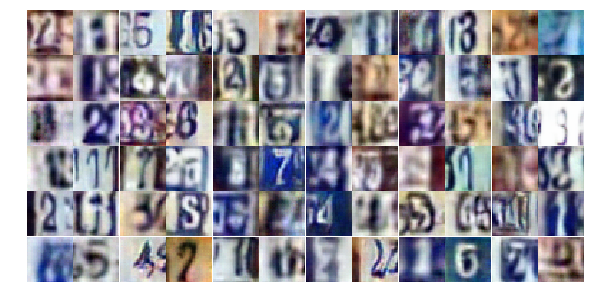

Epoch 25/25... Discriminator Loss: 0.9377... Generator Loss: 0.6978
Epoch 25/25... Discriminator Loss: 1.0245... Generator Loss: 3.8706
Epoch 25/25... Discriminator Loss: 1.0315... Generator Loss: 0.6695
Epoch 25/25... Discriminator Loss: 0.8335... Generator Loss: 0.9024
Epoch 25/25... Discriminator Loss: 0.8073... Generator Loss: 0.8063
Epoch 25/25... Discriminator Loss: 0.3239... Generator Loss: 1.9120
Epoch 25/25... Discriminator Loss: 0.6633... Generator Loss: 1.1497
Epoch 25/25... Discriminator Loss: 1.2182... Generator Loss: 0.4988
Epoch 25/25... Discriminator Loss: 0.4529... Generator Loss: 1.5348
Epoch 25/25... Discriminator Loss: 0.6112... Generator Loss: 1.1641


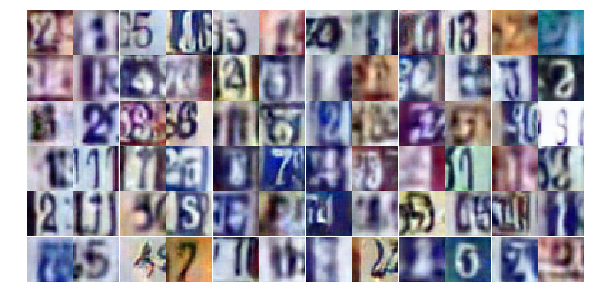

Epoch 25/25... Discriminator Loss: 0.9116... Generator Loss: 0.7505
Epoch 25/25... Discriminator Loss: 0.6222... Generator Loss: 0.9938
Epoch 25/25... Discriminator Loss: 1.2277... Generator Loss: 0.6983
Epoch 25/25... Discriminator Loss: 0.8205... Generator Loss: 1.0810
Epoch 25/25... Discriminator Loss: 0.2818... Generator Loss: 2.2362
Epoch 25/25... Discriminator Loss: 0.5678... Generator Loss: 1.2268
Epoch 25/25... Discriminator Loss: 0.6446... Generator Loss: 1.2744
Epoch 25/25... Discriminator Loss: 0.3949... Generator Loss: 2.2478
Epoch 25/25... Discriminator Loss: 0.7831... Generator Loss: 0.9791
Epoch 25/25... Discriminator Loss: 1.7271... Generator Loss: 0.3117


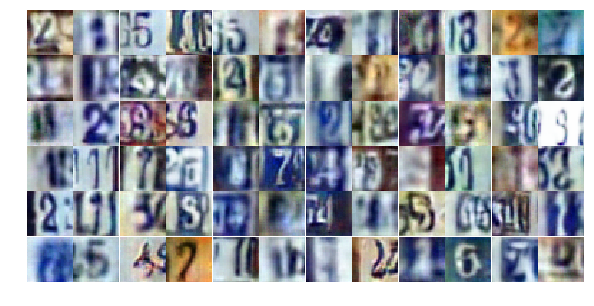

Epoch 25/25... Discriminator Loss: 0.8083... Generator Loss: 0.9001
Epoch 25/25... Discriminator Loss: 0.7186... Generator Loss: 0.8769
Epoch 25/25... Discriminator Loss: 0.5726... Generator Loss: 1.3000
Epoch 25/25... Discriminator Loss: 0.3575... Generator Loss: 1.7322
Epoch 25/25... Discriminator Loss: 0.7996... Generator Loss: 0.9005
Epoch 25/25... Discriminator Loss: 1.2048... Generator Loss: 0.5059
Epoch 25/25... Discriminator Loss: 0.5764... Generator Loss: 1.1952
Epoch 25/25... Discriminator Loss: 0.8835... Generator Loss: 0.7901
Epoch 25/25... Discriminator Loss: 1.5774... Generator Loss: 0.3819
Epoch 25/25... Discriminator Loss: 1.8869... Generator Loss: 3.0810


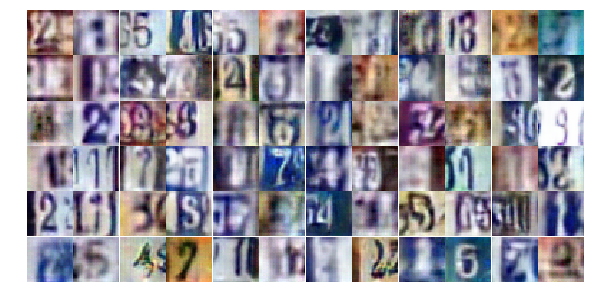

Epoch 25/25... Discriminator Loss: 2.4681... Generator Loss: 0.3179
Epoch 25/25... Discriminator Loss: 1.4660... Generator Loss: 1.9717
Epoch 25/25... Discriminator Loss: 1.5580... Generator Loss: 0.4907
Epoch 25/25... Discriminator Loss: 1.0580... Generator Loss: 0.6683
Epoch 25/25... Discriminator Loss: 1.0117... Generator Loss: 1.0096
Epoch 25/25... Discriminator Loss: 0.4218... Generator Loss: 1.6220
Epoch 25/25... Discriminator Loss: 1.1743... Generator Loss: 0.5396
Epoch 25/25... Discriminator Loss: 0.5081... Generator Loss: 1.4659
Epoch 25/25... Discriminator Loss: 1.4726... Generator Loss: 0.3879
Epoch 25/25... Discriminator Loss: 0.9956... Generator Loss: 0.7457


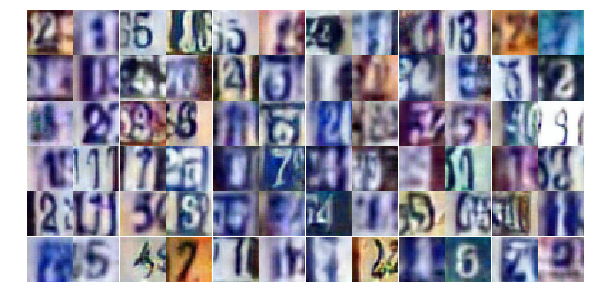

Epoch 25/25... Discriminator Loss: 0.5559... Generator Loss: 1.7647
Epoch 25/25... Discriminator Loss: 1.7479... Generator Loss: 0.2846


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

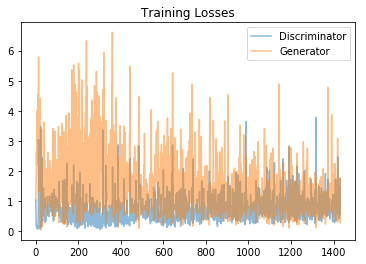

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

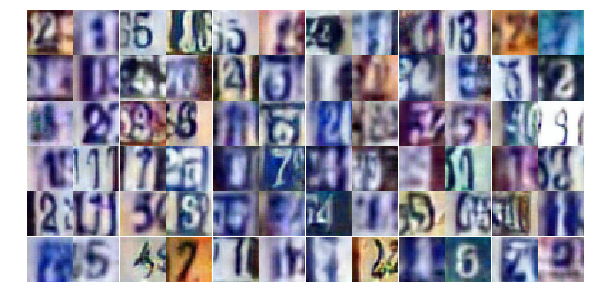

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))